# Prédiction des arrivées aux urgences : Besançon

## Initialisation

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import statistics
import xgboost as xgb

from IPython.display import display
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import train_test_split
from statsmodels.tsa.seasonal import seasonal_decompose

In [2]:
type_target = 'arrivees_urgences'
assert type_target in ['hospitalisations', 'arrivees_urgences']
horizon = 15
NUM_FEATS = 50
DEPARTEMENT = 'Besançon'

In [3]:
max_weight = 100

def compute_weights(y_true, threshold, max_weight):
    weights = np.ones_like(y_true)
    mask = y_true > threshold
    weights[mask] = 1 + (np.exp((y_true[mask] - threshold) / (np.max(y_true) - threshold)) - 1) / (np.e - 1) * (max_weight - 1)
    return weights

def weighted_rmse_obj(y_pred: np.ndarray, dtrain):
    global threshold, max_weight
    try:
        y_true = dtrain.get_label()  # Obtenir les vraies étiquettes
    except:
        y_true = dtrain
    weights = compute_weights(y_true, threshold, max_weight)
    errors = y_pred - y_true
    grad = weights * errors
    hess = weights
    return grad, hess

def weighted_rmse_metric(y_pred, dtrain):
    global threshold, max_weight
    try:
        y_true = dtrain.get_label()
    except:
        y_true = dtrain
    weights = compute_weights(y_true, threshold, max_weight)
    errors = y_pred - y_true
    weighted_squared_errors = weights * errors ** 2
    weighted_rmse_value = np.sqrt(np.mean(weighted_squared_errors))
    return 'weighted_rmse', weighted_rmse_value


In [19]:
%pylab inline
pylab.rcParams['figure.figsize'] = (18,8)
from scipy.stats import norm, normaltest

metric = 'tweedie'

def teste(df, score=100000, metric=metric, verbose=False):
    params = {'eta': 0.5}
    if metric == "tweedie":
        tweedie_power = 1.5
        params['objective'] = 'reg:tweedie'
        params['tweedie_variance_power'] = tweedie_power
        params['eta'] = 0.1
        params['subsample'] = 0.8
        params['colsample_bytree'] = 0.8
        params['min_child_weight'] = 1
        params['gamma'] = 0
        params['disable_default_eval_metric'] = 1
        params['eval_metric'] = [f'tweedie-nloglik@{tweedie_power}', 'mae']
        custom_objective = ''
    elif metric == "weighted_rmse":
        custom_objective = weighted_rmse_obj
        if 'objective' in params:
            del params['objective']
        if 'tweedie_variance_power' in params:
            del params['tweedie_variance_power']
    else:
        params = {'eta': 0.05, 
                  'objective': 'reg:absoluteerror', 
                  'eval_metric': ['rmse', 'mae'],
                  'subsample': 0.7, 
                  'colsample_bytree': 1,
                  'nthread': -1}
        custom_objective = ''

    MAEs, MSEs = [], []
    new_score = 100000
    reg_best = None
    final = df.loc[df.index.year==2023]

    for max_depth in range(4, 7):
        params['max_depth'] = max_depth

        train_val_test = df.copy()
        for annee in range(2019, 2024):
            train_val = train_val_test.loc[train_val_test.index.year != annee]
            test = train_val_test.loc[train_val_test.index.year == annee]
            X_test = test.drop('target', axis=1)
            y_test = test['target']
            X_train, X_valid, y_train, y_valid = train_test_split(train_val.drop('target', axis=1), train_val['target'], 
                                                                  test_size=0.2, shuffle=False)
                    
            dtrain = xgb.DMatrix(X_train, label=y_train, enable_categorical=True)
            dvalid = xgb.DMatrix(X_valid, label=y_valid, enable_categorical=True)
            dtest = xgb.DMatrix(X_test, label=y_test, enable_categorical=True)
            evals = [(dtrain, 'train'), (dvalid, 'eval')]
            
            if custom_objective != '':
                bst = xgb.train(params, dtrain, 100000, evals=evals,
                                early_stopping_rounds=15, verbose_eval=False,
                                obj=custom_objective, feval=metric)
            elif metric == 'tweedie':
                params['objective'] = 'reg:tweedie'
                if 'tweedie_variance_power' not in params:
                    params['tweedie_variance_power'] = tweedie_power
                bst = xgb.train(params, dtrain, 100000, evals=evals,
                                    early_stopping_rounds=15, verbose_eval=False)
            else:
                bst = xgb.train(params, dtrain, num_boost_round=100000, evals=evals,
                                early_stopping_rounds=15, verbose_eval=verbose)

            y_pred = bst.predict(dtest)
            MAEs.append(mean_absolute_error(y_test, y_pred))
            MSEs.append(mean_squared_error(y_test, y_pred))

        current_score = statistics.mean(MSEs)
        step_month = 2
        if current_score < new_score:
            previous_score = new_score
            new_score = current_score
            if new_score < score:
                predit_reel = {}
                for month in range(0, 13, step_month):
                    train_val_test = df.loc[(df.index.year<2023)| ((df.index.year==2023) & (df.index.month<month))]
                    new_score = statistics.mean(MSEs)
                    X_train, X_valid, y_train, y_valid = train_test_split(train_val_test.drop('target', axis=1), 
                                                                    train_val_test['target'], 
                                                                    test_size=0.2, shuffle=False)

                    dtrain = xgb.DMatrix(X_train, label=y_train, enable_categorical=True)
                    dvalid = xgb.DMatrix(X_valid, label=y_valid, enable_categorical=True)
                    evals = [(dtrain, 'train'), (dvalid, 'eval')]

                    if custom_objective != '':
                        bst = xgb.train(params, dtrain, 100000, evals=evals,
                                        early_stopping_rounds=15, verbose_eval=False,
                                        obj=custom_objective, feval=metric)
                    elif metric == 'tweedie':
                        params['objective'] = 'reg:tweedie'
                        if 'tweedie_variance_power' not in params:
                            params['tweedie_variance_power'] = tweedie_power
                        bst = xgb.train(params, dtrain, 100000, evals=evals,
                                            early_stopping_rounds=15, verbose_eval=False)
                    else:
                        bst = xgb.train(params, dtrain, num_boost_round=100000, evals=evals,
                                        early_stopping_rounds=15, verbose_eval=verbose)

                    #bst = xgb.train(params, dtrain, num_boost_round=100000, evals=evals,
                    #            early_stopping_rounds=15, verbose_eval=verbose)
                    reg_best = bst
                    #y_pred_ma = pd.Series(y_pred).rolling(window=ma, center=True).mean()
                    for hopital in df.hopital.unique():
                        if hopital not in predit_reel:
                            predit_reel[hopital] = {'predit': [], 'reel': [], 'residu': []}
                        final_now = final.loc[(final.index.year==2023) & (final.index.month >= month) & (final.index.month<(month+step_month))]
                        X_final = final_now.loc[final_now.hopital==hopital].drop('target', axis=1)
                        y_final = final_now.loc[final_now.hopital==hopital]['target']
                        dtest = xgb.DMatrix(X_final, label=y_final, enable_categorical=True)
                        y_pred = bst.predict(dtest)
                        predit_reel[hopital]['predit'].extend(y_pred)
                        predit_reel[hopital]['reel'].extend(y_final)
                        predit_reel[hopital]['residu'].extend(y_final - y_pred)
            if new_score < score:
                print(f"Amélioration avec {max_depth=}: {min(previous_score, score):.4f} -> {new_score:.4f}")
                for hopital in predit_reel:
                    y_final = predit_reel[hopital]['reel']
                    y_pred = predit_reel[hopital]['predit']
                    plt.figure()
                    plt.plot(range(len(y_final))[:-5], y_final[:-5], label='actual', color='red')
                    plt.plot(range(len(y_pred))[:-5], y_pred[:-5], label='predict', color='blue')
                    #plt.plot(range(len(y_pred))[-N:], y_pred_ma[-N:], label='trend', color='red')
                    plt.legend()
                    plt.title(f"{hopital}: {mean_absolute_error(y_final[:-5], y_pred[:-5]):.2f} (moyenne : {df.loc[df['hopital']==hopital]['target'].mean():.2f})")
                    plt.savefig(f"{hopital}_{metric}_{mean_absolute_error(y_final[:-5], y_pred[:-5]):.2f}.png")
                    '''y_test_ma = y_final.rolling(window=ma, center=True).mean()
                
                    plt.figure()
                    plt.plot(range(len(y_final)), y_test_ma, label='actual')
                    plt.plot(range(len(y_pred)), y_pred_ma, label='predict')
                    plt.legend()
                    '''
                    display(plt.gcf())

                    # Tracer l'histogramme des résidus
                    residus = predit_reel[hopital]['residu'][:-5]
                    residus = [abs(u) for u in residus]
                    plt.figure(figsize=(8, 6))

                    moyenne = np.mean(residus)
                    ecart_type = np.std(residus)

                    # Histogramme des résidus
                    plt.figure(figsize=(8, 6))
                    plt.hist(residus, bins=50, density=True, edgecolor='k', alpha=0.7, label='Histogramme')

                    # Courbe de la gaussienne
                    x = np.linspace(min(residus), max(residus), 500)
                    gaussienne = norm.pdf(x, moyenne, ecart_type)
                    plt.plot(x, gaussienne, 'r-', label=f'Gaussienne (moyenne={abs(moyenne):.2f} ({abs(moyenne)/df.loc[df['hopital']==hopital]['target'].mean()*100:.2f}%), ecart_type={abs(ecart_type):.2f} ({abs(ecart_type)/df.loc[df['hopital']==hopital]['target'].std()*100:.2f}%)')

                    # Test de normalité et p-value
                    _, p_value = normaltest(residus)

                    # Titre et légende
                    plt.title(f'Histogramme des Résidus pour {hopital}\np-value du test de normalité = {p_value:.4f}')
                    plt.xlabel('Résidus (reel - predit)')
                    plt.ylabel('Densité')
                    plt.legend()
                    plt.grid(True, linestyle='--', alpha=0.6)
                    plt.show()
                    print(f"   - MAE : {statistics.mean(MAEs):.2f} ({mean_absolute_error(y_pred, y_final):.2f} sur 2023)")
                    print(f"   - MSE : {statistics.mean(MSEs):.2f} ({mean_squared_error(y_pred, y_final):.2f} sur 2023)")

                '''
                mean_y_test = np.mean(y_final)
                error_percentage = np.abs((y_pred - y_final) / mean_y_test) * 100
                percent_below_thresholds = {}
                for threshold in range(1, 12):  # de 1% à 30%
                    percent_below = np.mean(error_percentage < threshold) * 100
                    percent_below_thresholds[threshold] = percent_below
                for threshold, percent_below in percent_below_thresholds.items():
                    print(f"{percent_below:.2f}%,{threshold}%")
                '''

    return new_score, reg_best

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


/usr/lib/python3/dist-packages/IPython/core/magics/pylab.py:162: UserWarning: pylab import has clobbered these variables: ['norm']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [5]:
assert type_target in ['hospitalisations', 'arrivees_urgences']
categories_1 = ['CHU Besançon', 'CHU Dijon', 'HNFC']
if type_target == 'arrivees_urgences':
    for hopital in ['CHU Besançon', 'CHU Dijon', 'HNFC', 
                    'CH Beaune', 'CH Chaumont', 'CH Langres', 'CH privé Dijon', 
                    'CH Chatillon Montbard', 'CH Semur']:
        if hopital == 'CHU Besançon':
            df = pd.read_csv(f'full_dataset_{hopital}.csv', sep=',')
            df.rename({'nb_emmergencies': 'arrivees_urgences'}, axis=1, inplace=True)
            df['date'] = pd.to_datetime(df['date'], format="%Y-%m-%d")
            df.set_index('date', inplace=True)
            df['hopital'] = hopital
            if hopital in categories_1:
                df['niveau'] = 1
            else:
                df['niveau'] = 2
        else:
            dg = pd.read_csv(f'full_dataset_{hopital}.csv', sep=',')
            dg.rename({'nb_emmergencies': 'arrivees_urgences'}, axis=1, inplace=True)
            dg['date'] = pd.to_datetime(dg['date'], format="%Y-%m-%d")
            dg.set_index('date', inplace=True)
            dg['hopital'] = hopital
            if hopital in categories_1:
                dg['niveau'] = 1
            else:
                dg['niveau'] = 2
            df = df[[k for k in df.columns if k in dg.columns]]
            dg = dg[df.columns]
            df = pd.concat([df, dg])
        print(df.shape)

cols = [k for k in df.columns if 'target' not in k]
df = df[cols]

(1817, 794)
(3634, 786)
(5451, 786)
(7268, 786)
(9085, 786)
(10902, 786)
(12719, 786)
(14536, 786)
(16353, 730)


In [6]:
# On ajoute la target
if type_target == 'hospitalisations':
    horizon = 7
else:
    horizon = 3
df['mean'] = df[type_target].rolling(window=horizon, min_periods=1).mean()
df['target'] = df['mean'].shift(-2*horizon+1)
df.drop('mean', axis=1, inplace=True)

df["hopital"] = df["hopital"].astype('category')

df.dropna(inplace=True)
df.shape

df.sort_index(inplace=True)

/tmp/ipykernel_332716/1731563860.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for hopital, group in df.groupby('hopital'):


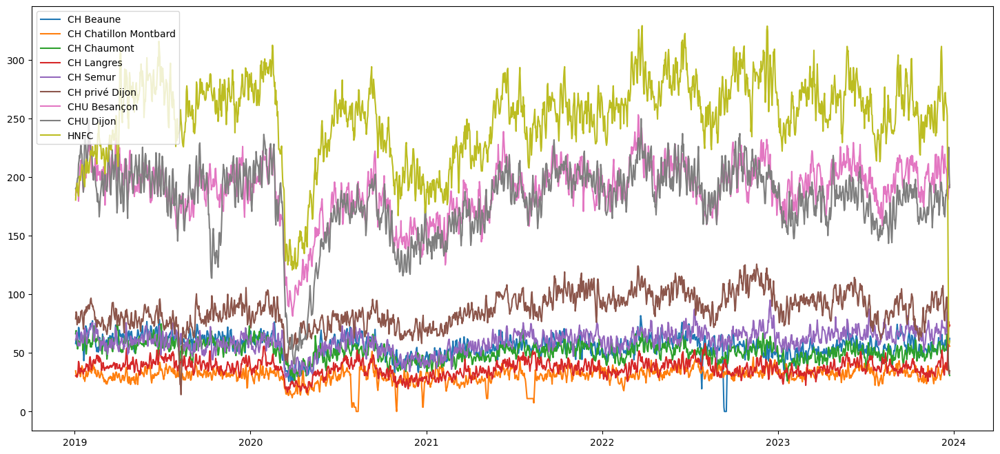

In [7]:
for hopital, group in df.groupby('hopital'):
    plt.plot(df.loc[df.hopital==hopital].index, group['target'], label=hopital)

plt.legend()
plt.show()


In [15]:
for cat in ['hopital']:
	df[cat] = df[cat].astype('category')

val_set = df.loc[df.index.year == 2023]
train_set = df.loc[df.index.year < 2023]
#train_val_set, test_set = train_test_split(train_set, test_size=0.2, shuffle=False)
#train_set, val_set = train_test_split(train_val_set, test_size=0.2, shuffle=False)

X_train = train_set.drop('target', axis=1)
y_train = train_set['target']
X_val = val_set.drop('target', axis=1)
y_val = val_set['target']
#X_test = test_set.drop('target', axis=1)
#y_test = test_set['target']

dtrain = xgb.DMatrix(X_train, label=y_train, enable_categorical=True)
dvalid = xgb.DMatrix(X_val, label=y_val, enable_categorical=True)
evals = [(dtrain, 'train'), (dvalid, 'eval')]

params = {'max_depth': 7}
if metric == "tweedie":
	tweedie_power = 1.5
	params['objective'] = 'reg:tweedie'
	params['tweedie_variance_power'] = tweedie_power
	params['eta'] = 0.1
	params['subsample'] = 0.8
	params['colsample_bytree'] = 0.8
	params['min_child_weight'] = 1
	params['gamma'] = 0
	params['disable_default_eval_metric'] = 1
	params['eval_metric'] = [f'tweedie-nloglik@{tweedie_power}', 'mae']
	custom_objective = ''
elif metric == "weighted_rmse":
	custom_objective = weighted_rmse_obj
	if 'objective' in params:
		del params['objective']
	if 'tweedie_variance_power' in params:
		del params['tweedie_variance_power']
else:
	params['eta'] = 0.05
	params['objective'] = 'reg:absoluteerror'
	params['eval_metric'] = ['rmse', 'mae']
	params['subsample'] = 0.7
	params['colsample_bytree'] = 1
	params['nthread'] = -1
	custom_objective = ''

if custom_objective != '':
	bst = xgb.train(params, dtrain, 100000, evals=evals,
					early_stopping_rounds=15, verbose_eval=False,
					obj=custom_objective, feval=metric)
elif metric == 'tweedie':
	params['objective'] = 'reg:tweedie'
	if 'tweedie_variance_power' not in params:
		params['tweedie_variance_power'] = tweedie_power
	bst = xgb.train(params, dtrain, 100000, evals=evals,
						early_stopping_rounds=15, verbose_eval=False)
else:
	bst = xgb.train(params, dtrain, num_boost_round=100000, evals=evals,
					early_stopping_rounds=15, verbose_eval=False)

'''
bst = xgb.train({'max_depth': 4}, dtrain, 100000, 
					evals=evals, early_stopping_rounds=2,
					verbose_eval=True)
'''
#y_pred = bst.predict(dtest)

importance_gain = bst.get_score(importance_type='gain')
importance_cover = bst.get_score(importance_type='cover')
importance_weight = bst.get_score(importance_type='weight')

df_gain = pd.DataFrame.from_dict(importance_gain, orient='index', columns=['gain'])
df_cover = pd.DataFrame.from_dict(importance_cover, orient='index', columns=['cover'])
df_weight = pd.DataFrame.from_dict(importance_weight, orient='index', columns=['weight'])

dff = df_gain.join(df_cover, how='outer').join(df_weight, how='outer')
dff.fillna(0, inplace=True)

dff['gain_norm'] = dff['gain'] / dff['gain'].sum()
dff['cover_norm'] = dff['cover'] / dff['cover'].sum()
dff['weight_norm'] = dff['weight'] / dff['weight'].sum()

w_gain = 0.5
w_cover = 0.3
w_weight = 0.2

dff['importance'] = (dff['gain_norm'] * w_gain) + (dff['cover_norm'] * w_cover) + (dff['weight_norm'] * w_weight)

dff.sort_values(by='importance', ascending=False, inplace=True)

dff['rank'] = dff['importance'].rank(ascending=False)

dff.reset_index(inplace=True)

dff.rename(columns={'index': 'feature'}, inplace=True)

print(dff[['feature', 'gain', 'cover', 'weight', 'importance', 'rank']].head(40))

[0]	train-rmse:55.41724	eval-rmse:55.54177
[1]	train-rmse:39.75373	eval-rmse:39.60671
[2]	train-rmse:28.97260	eval-rmse:28.58308
[3]	train-rmse:21.68810	eval-rmse:21.53396
[4]	train-rmse:16.90689	eval-rmse:17.29021
[5]	train-rmse:13.87734	eval-rmse:14.69156
[6]	train-rmse:12.00809	eval-rmse:13.26653
[7]	train-rmse:10.92616	eval-rmse:12.66724
[8]	train-rmse:10.29650	eval-rmse:12.51810
[9]	train-rmse:9.85058	eval-rmse:12.45436
[10]	train-rmse:9.61418	eval-rmse:12.47666
[11]	train-rmse:9.43087	eval-rmse:12.48032
                        feature          gain        cover  weight  \
0          nb_emmergencies%%J-2  5.844318e+06  4476.000000    12.0   
1             arrivees_urgences  1.989522e+06  4482.285645    21.0   
2          nb_emmergencies%%J-3  2.029887e+06  5485.818359    11.0   
3          nb_emmergencies%%J-1  6.781467e+05  3798.333252    15.0   
4                       hopital  3.115506e+05  4410.646973    17.0   
5          nb_emmergencies%%J-4  2.488668e+05  3937.923096    13.

Amélioration avec max_depth=4: 100000.0000 -> 201.0979


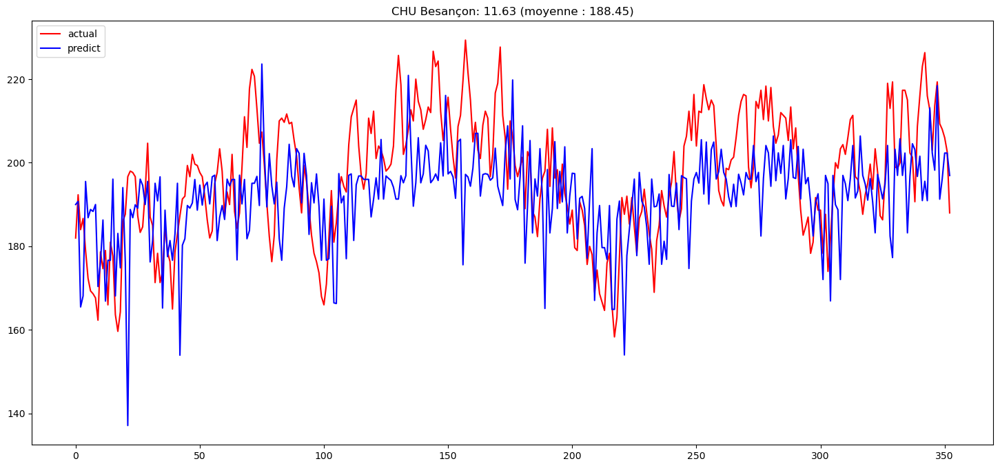

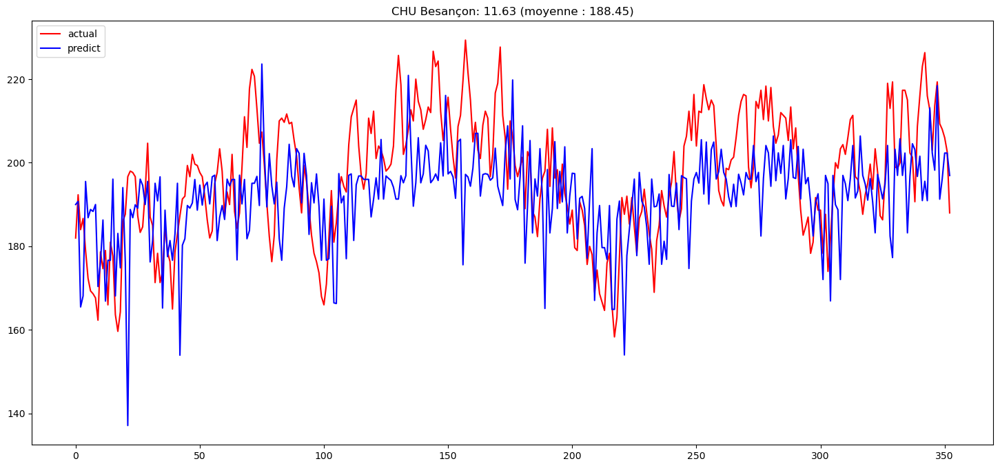

<Figure size 800x600 with 0 Axes>

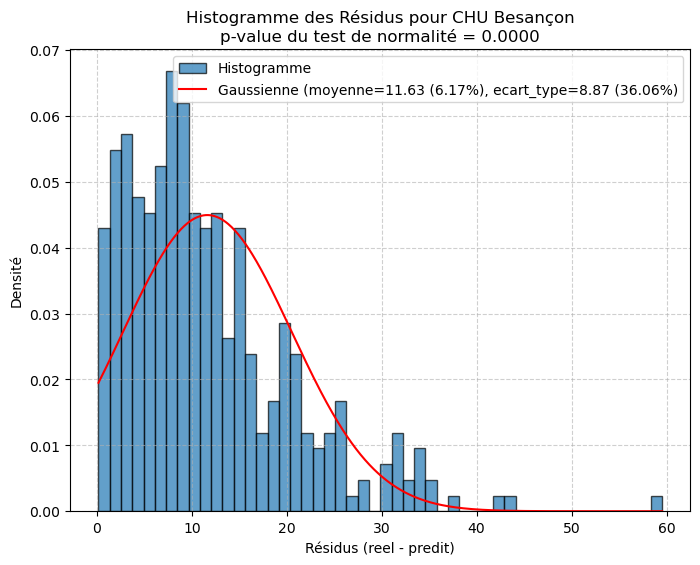

   - MAE : 9.62 (11.60 sur 2023)
   - MSE : 201.10 (212.79 sur 2023)


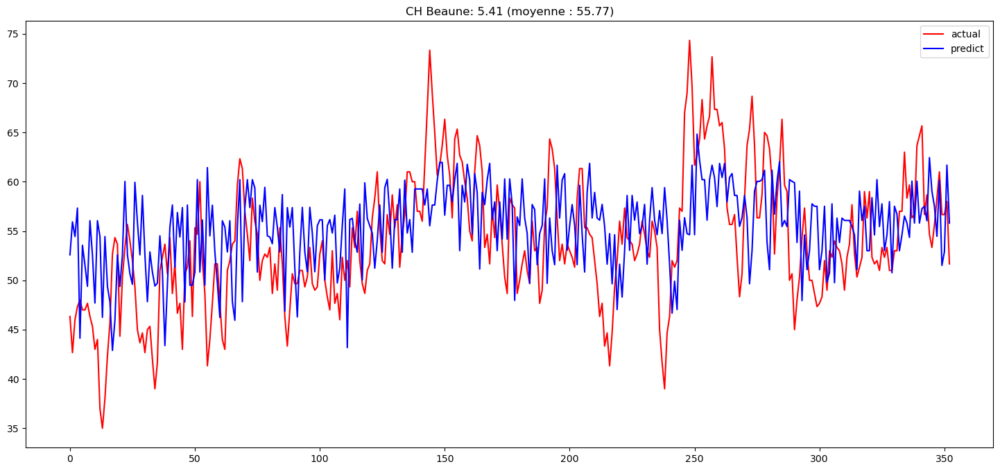

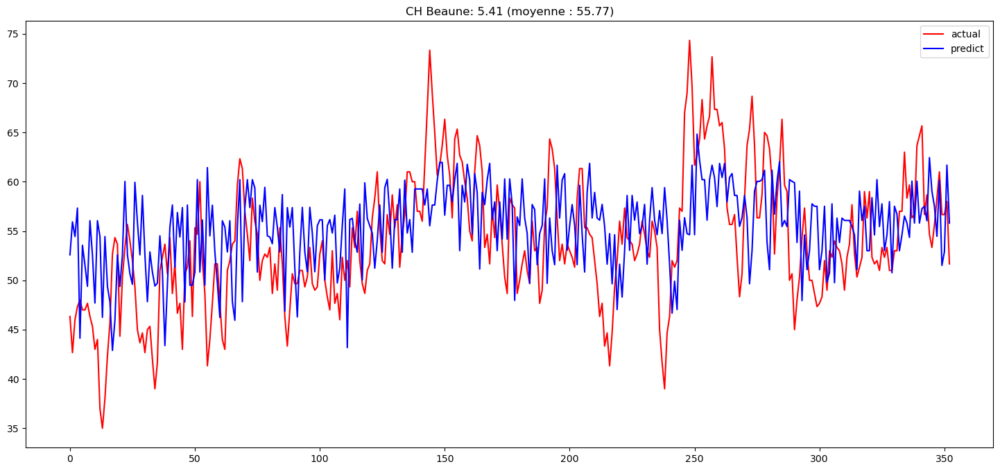

<Figure size 800x600 with 0 Axes>

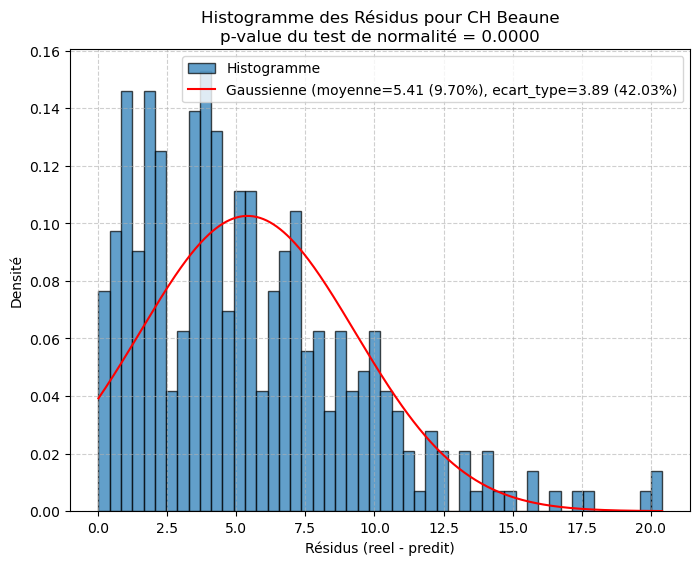

   - MAE : 9.62 (5.40 sur 2023)
   - MSE : 201.10 (44.30 sur 2023)


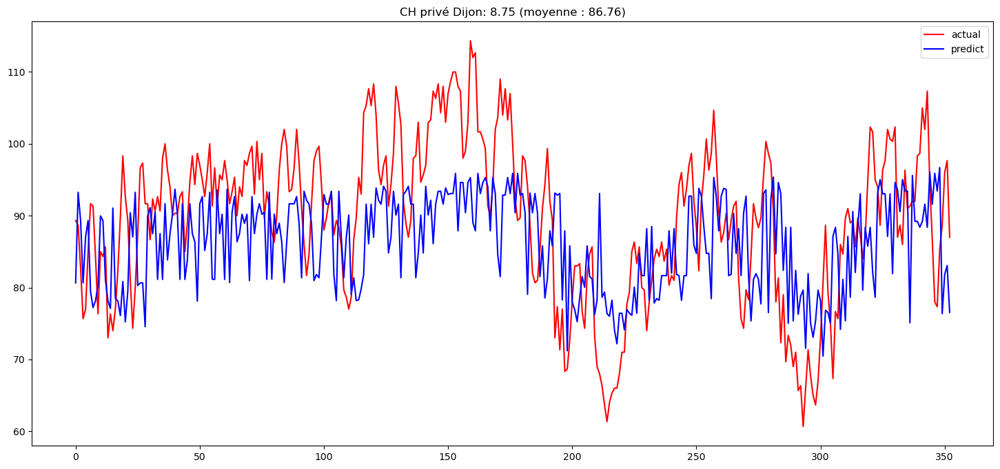

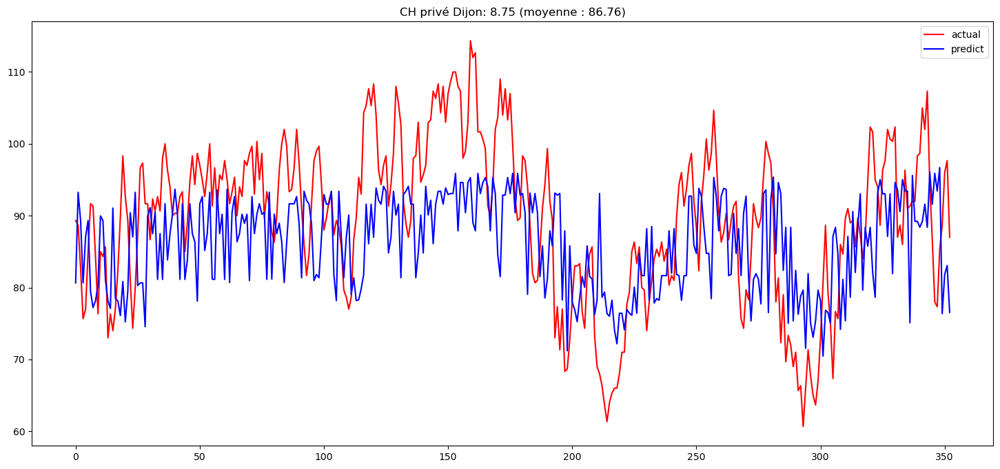

<Figure size 800x600 with 0 Axes>

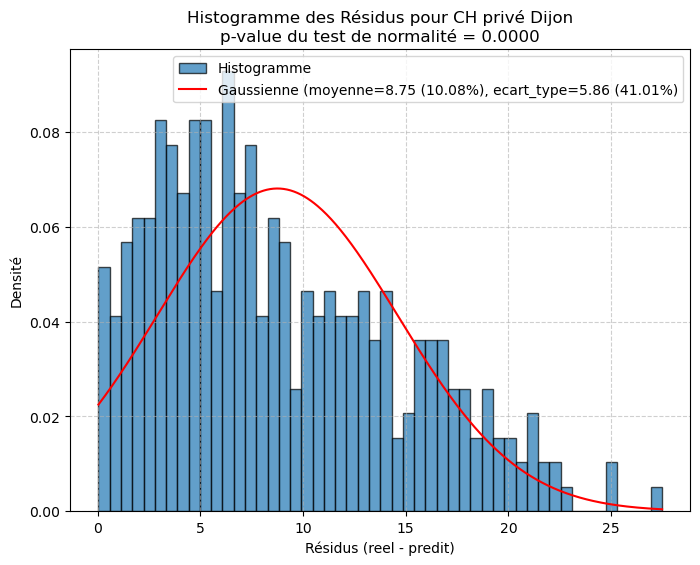

   - MAE : 9.62 (9.27 sur 2023)
   - MSE : 201.10 (141.31 sur 2023)


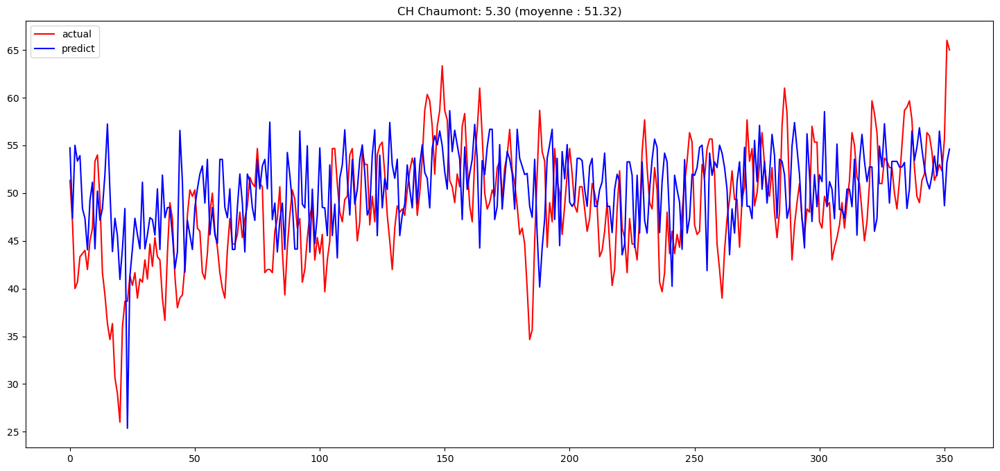

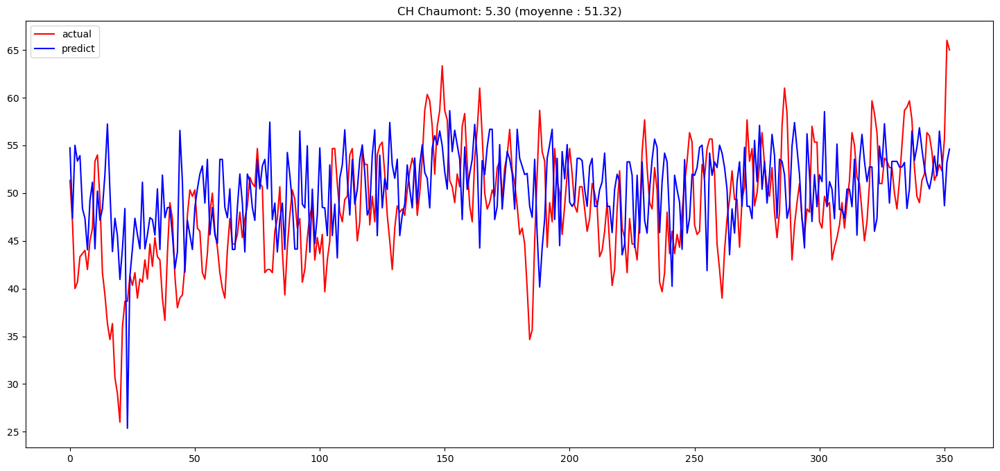

<Figure size 800x600 with 0 Axes>

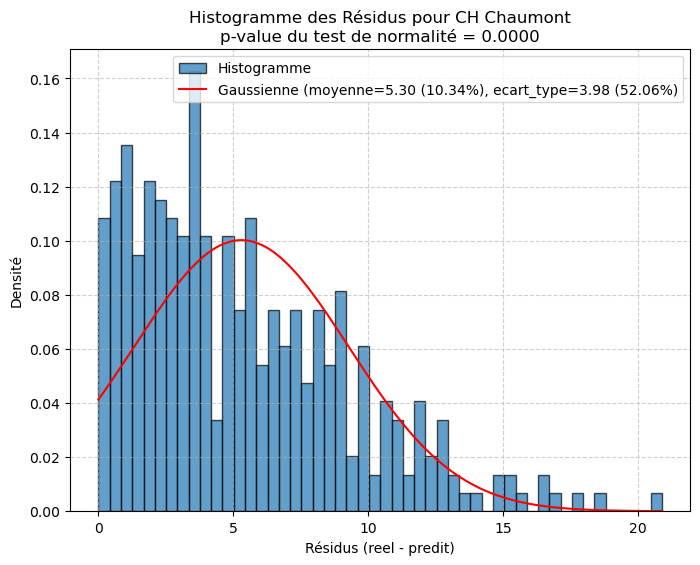

   - MAE : 9.62 (5.48 sur 2023)
   - MSE : 201.10 (48.70 sur 2023)


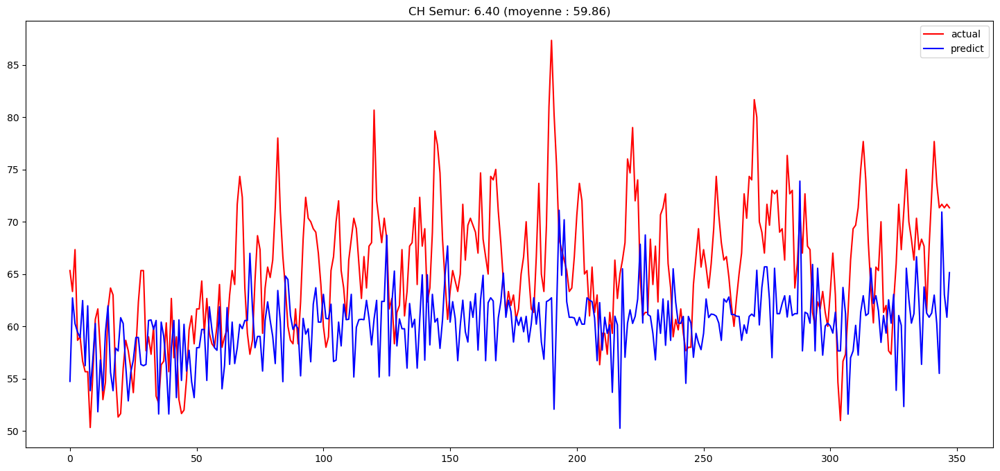

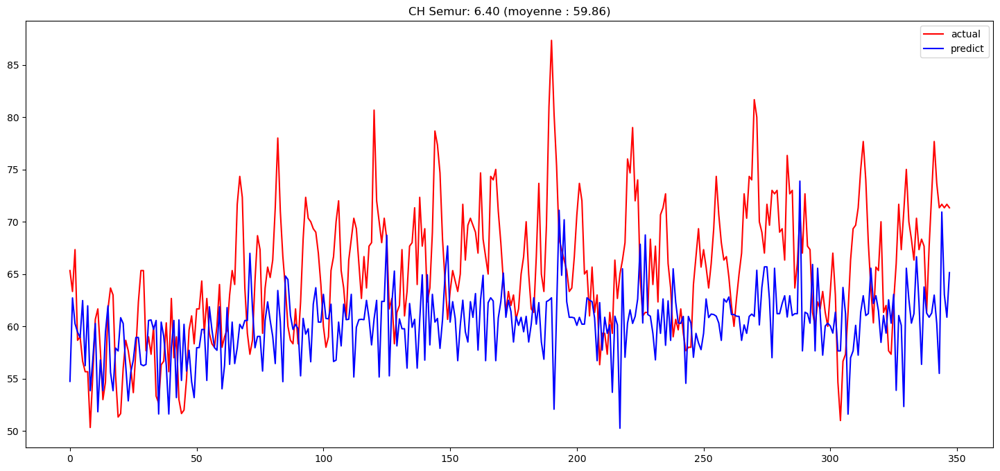

<Figure size 800x600 with 0 Axes>

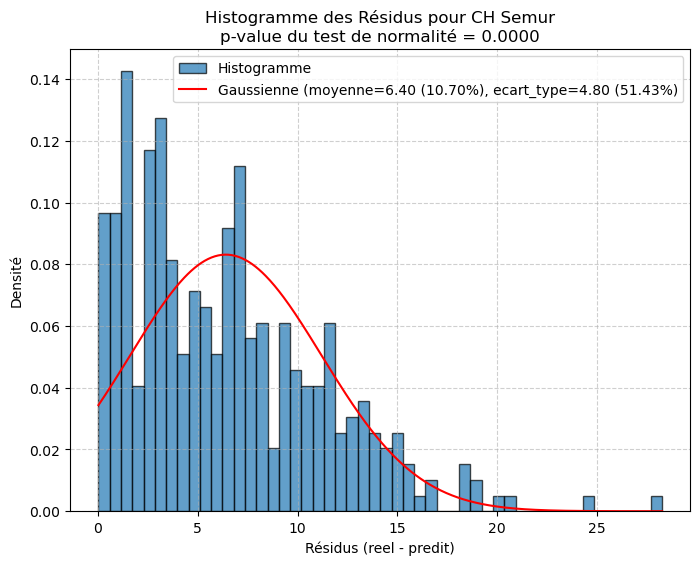

   - MAE : 9.62 (6.47 sur 2023)
   - MSE : 201.10 (65.78 sur 2023)


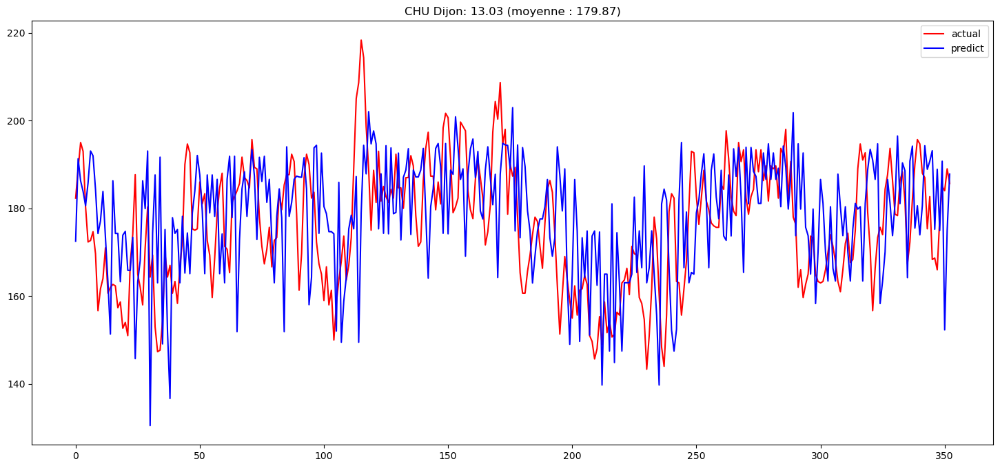

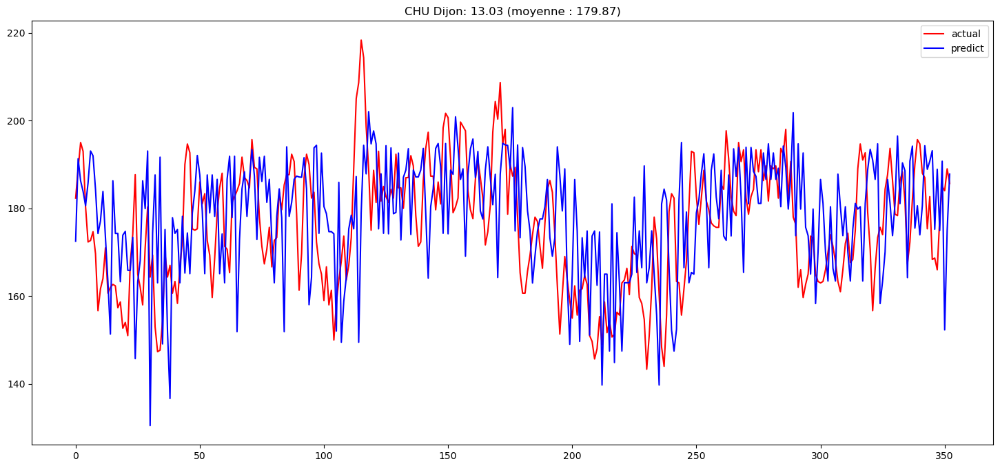

<Figure size 800x600 with 0 Axes>

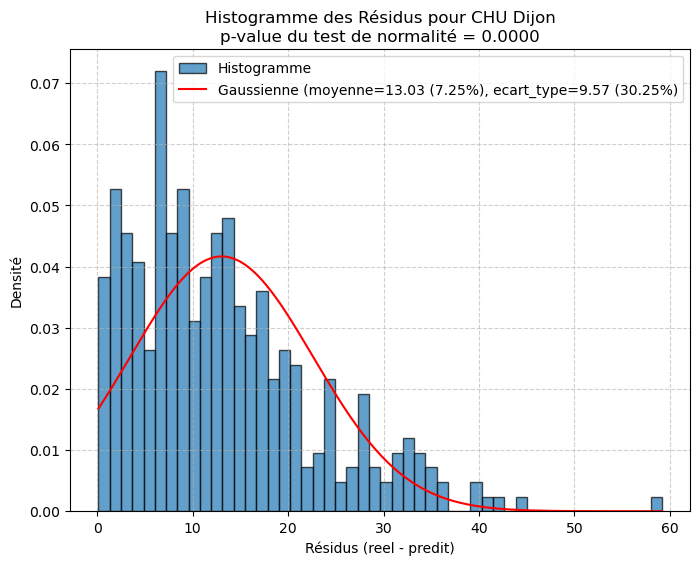

   - MAE : 9.62 (13.12 sur 2023)
   - MSE : 201.10 (264.75 sur 2023)


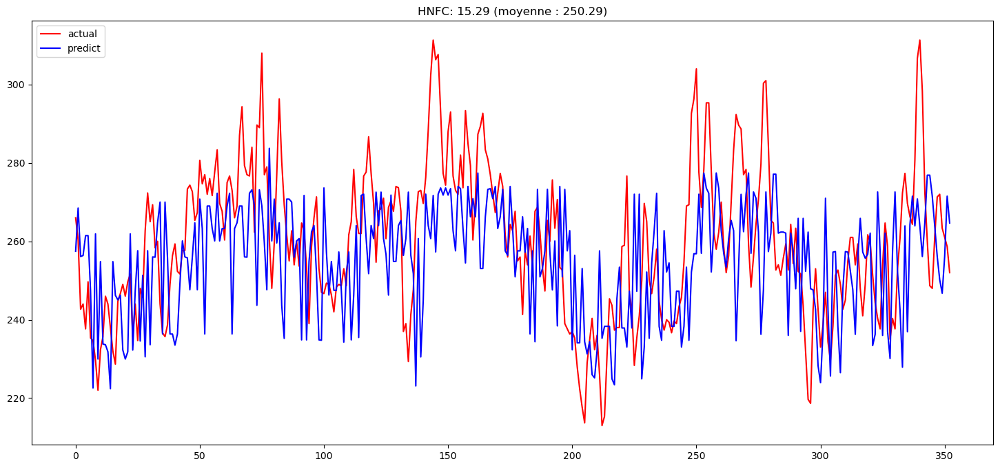

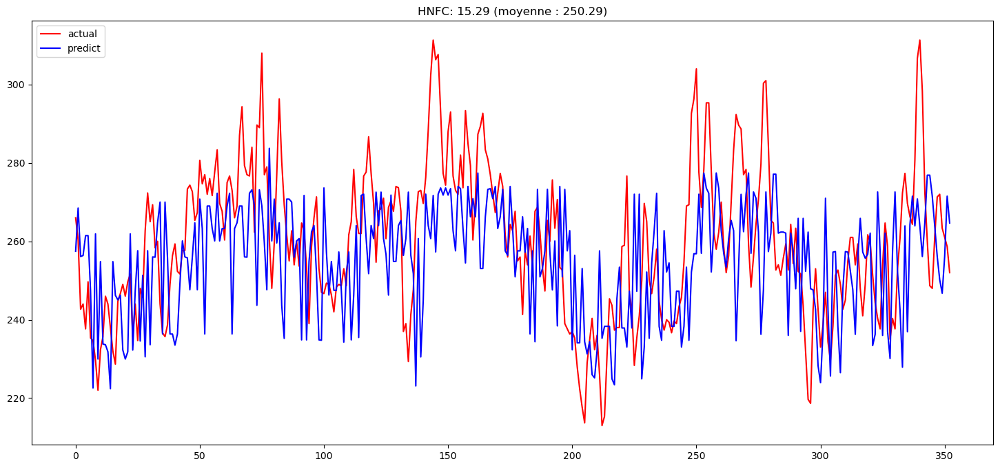

<Figure size 800x600 with 0 Axes>

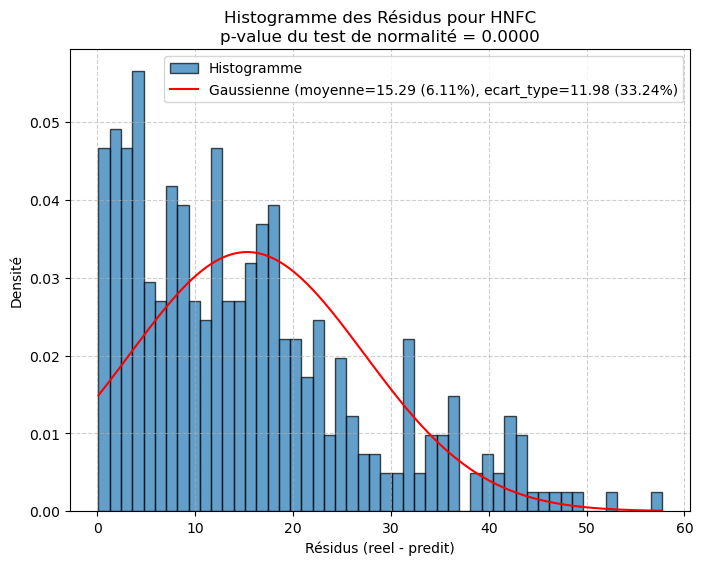

   - MAE : 9.62 (17.33 sur 2023)
   - MSE : 201.10 (766.73 sur 2023)


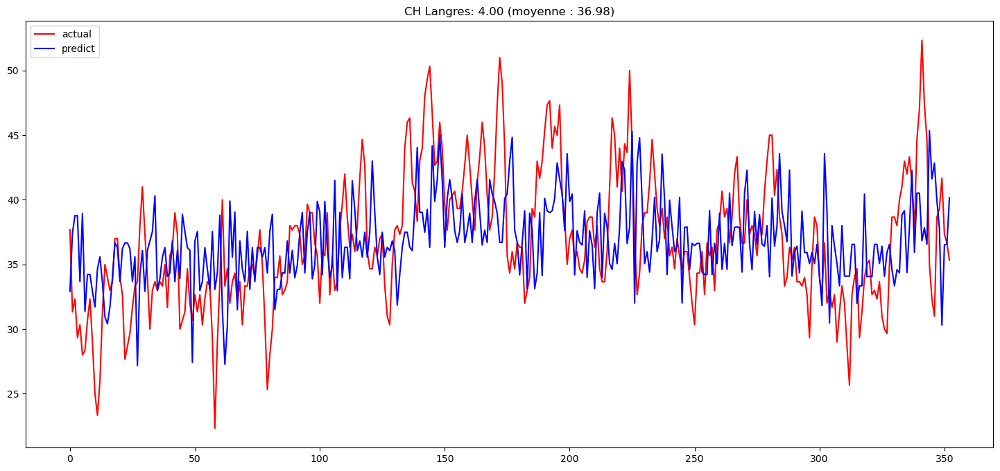

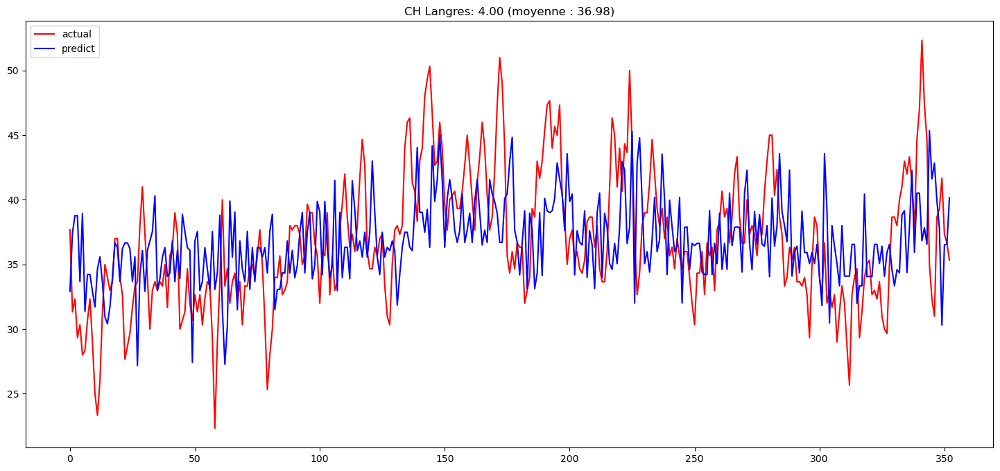

<Figure size 800x600 with 0 Axes>

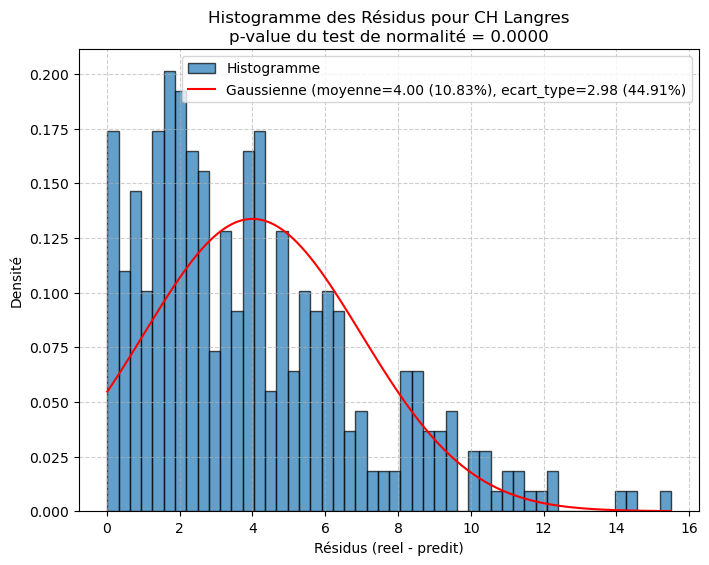

   - MAE : 9.62 (4.38 sur 2023)
   - MSE : 201.10 (39.22 sur 2023)


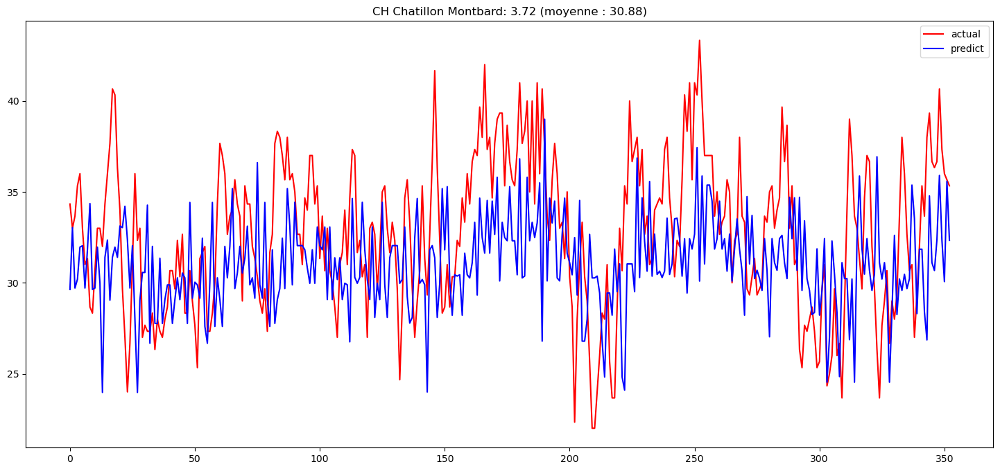

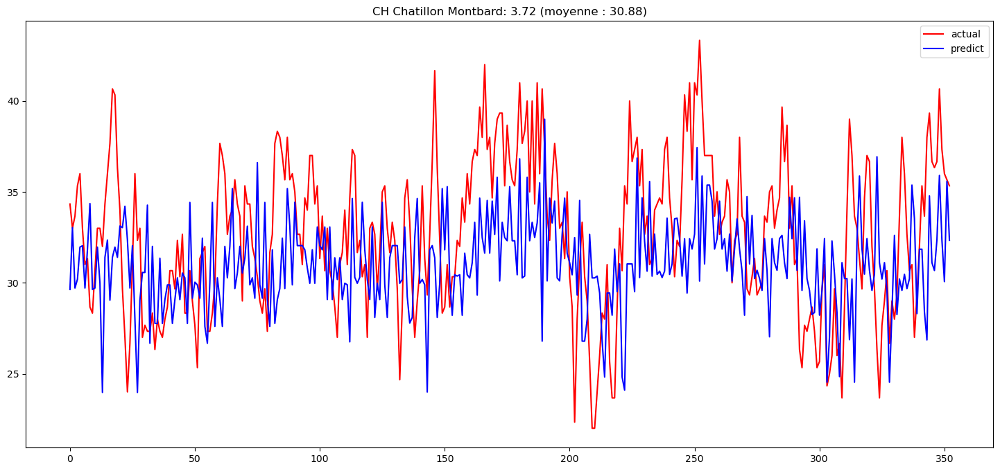

<Figure size 800x600 with 0 Axes>

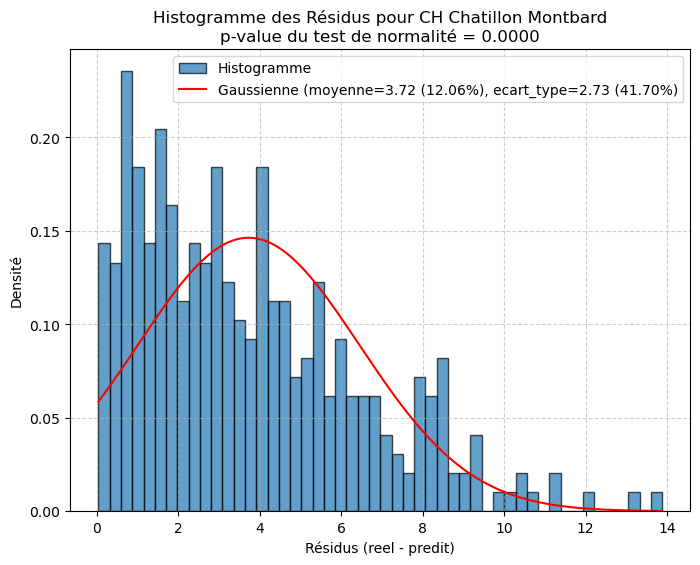

   - MAE : 9.62 (3.98 sur 2023)
   - MSE : 201.10 (27.89 sur 2023)


In [20]:
cols = ['arrivees_urgences', 'hopital']
old_col = None
score, _ = teste(df[cols+['target']], score=100000)
scores = [score]

Colonnes actuelles (2): ['arrivees_urgences', 'hopital']
Amélioration avec max_depth=4: 201.0979 -> 183.1120


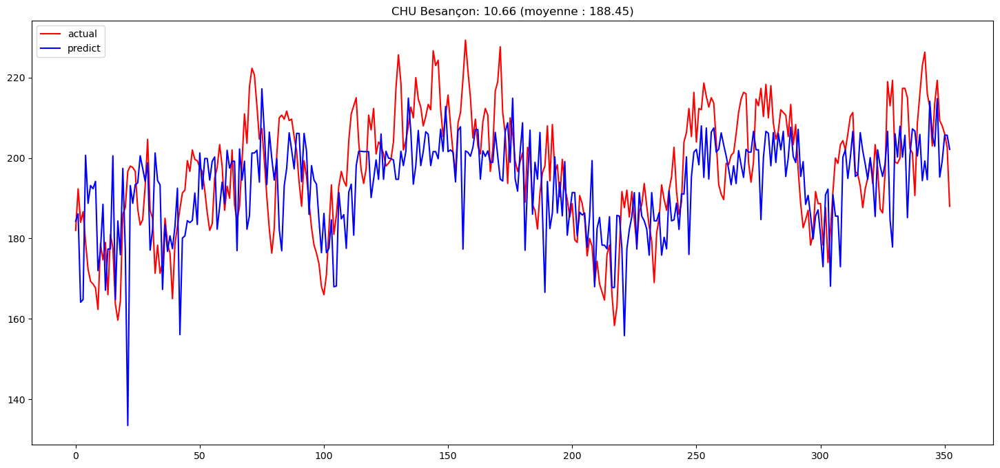

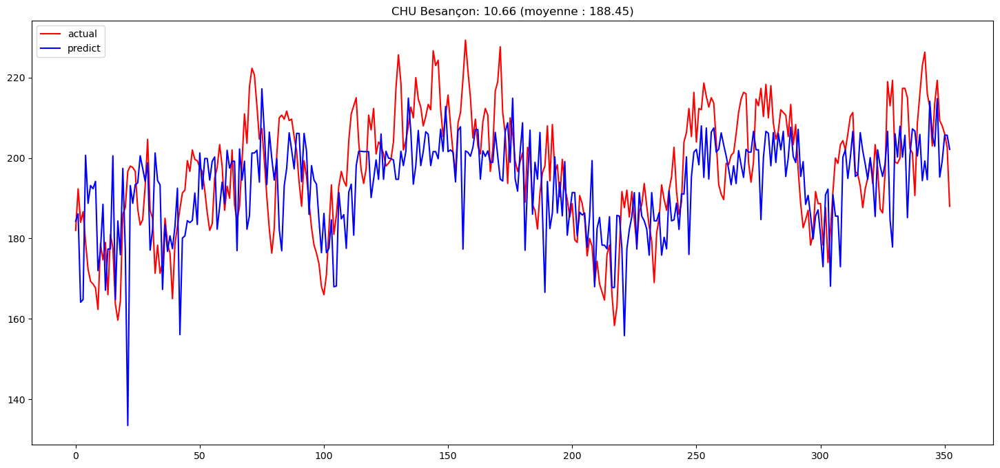

<Figure size 800x600 with 0 Axes>

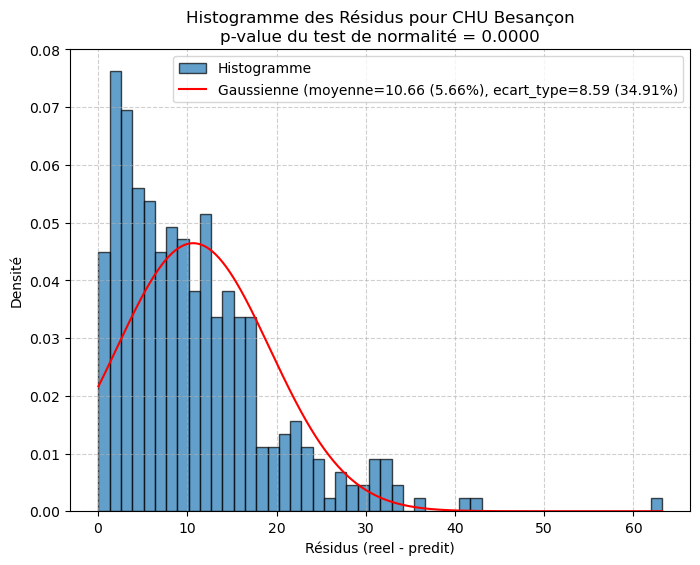

   - MAE : 9.25 (10.69 sur 2023)
   - MSE : 183.11 (187.79 sur 2023)


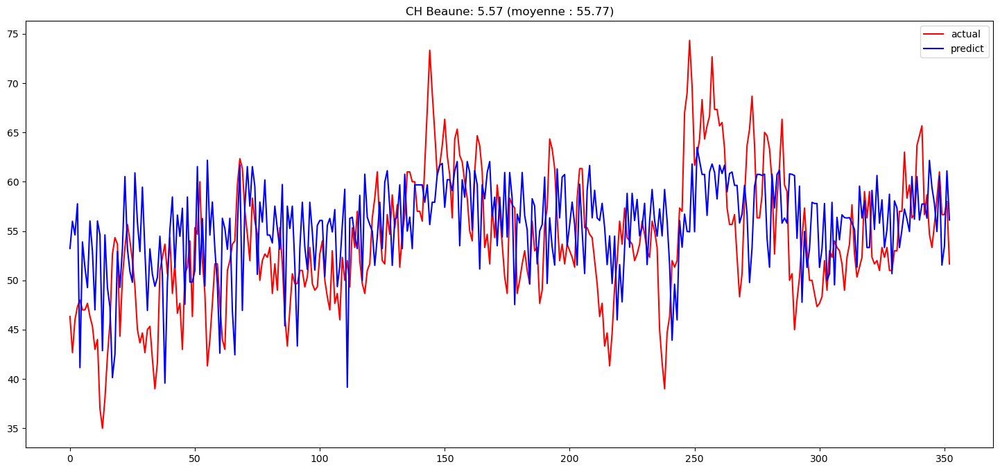

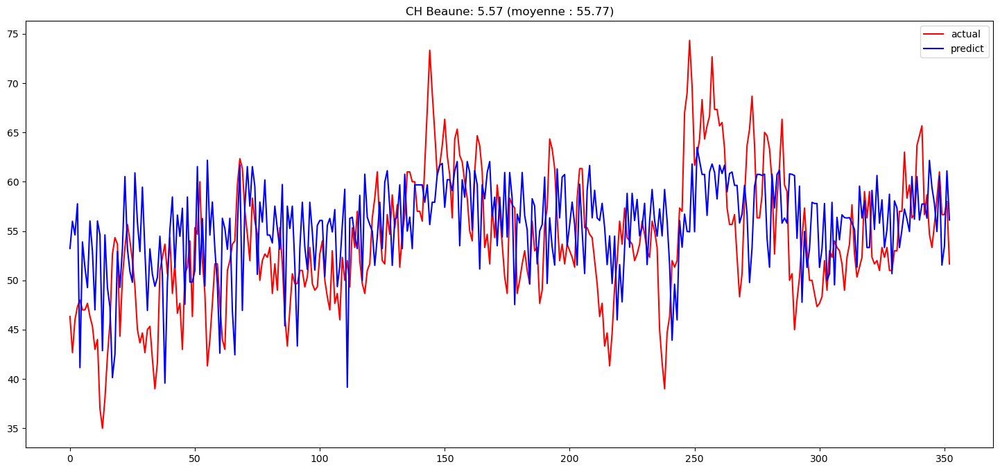

<Figure size 800x600 with 0 Axes>

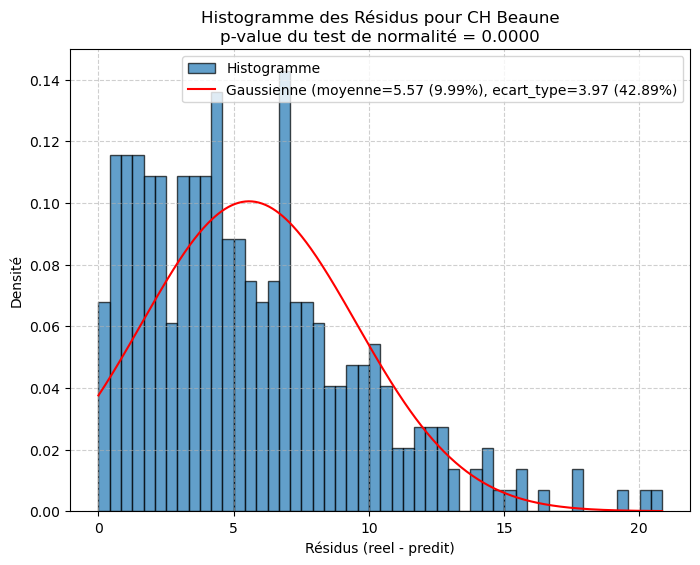

   - MAE : 9.25 (5.56 sur 2023)
   - MSE : 183.11 (46.65 sur 2023)


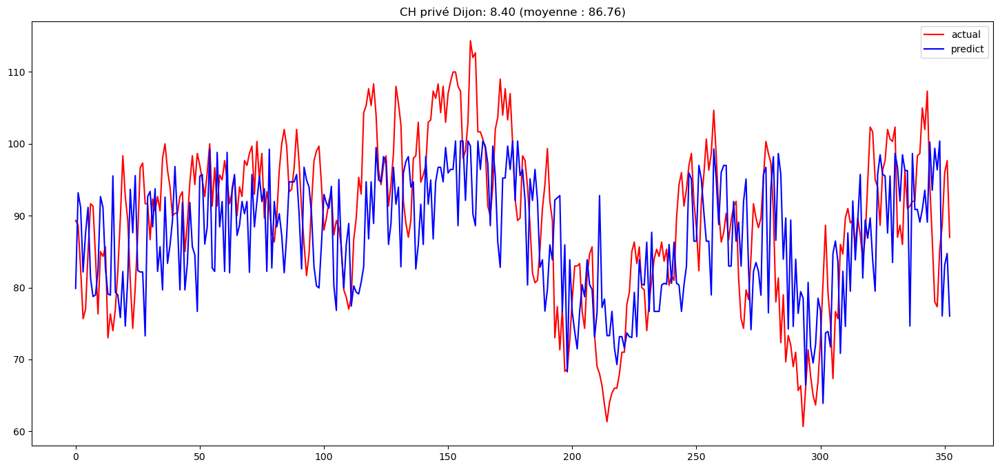

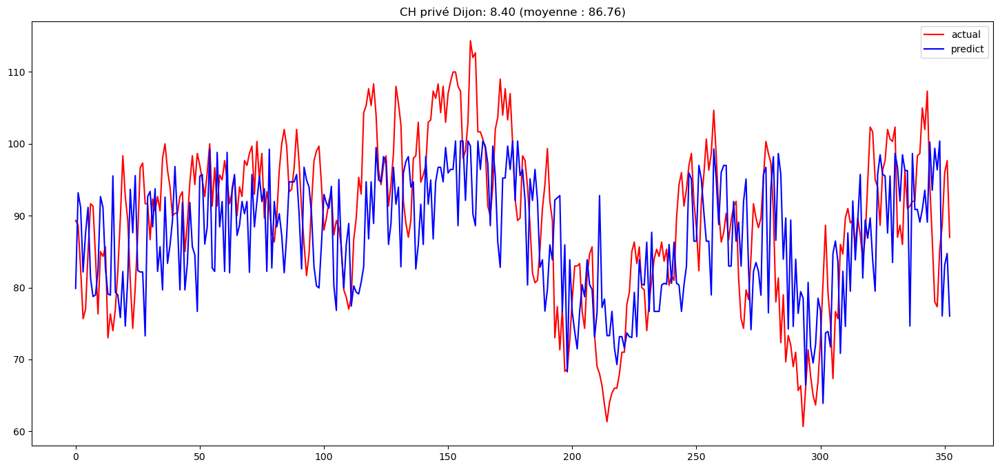

<Figure size 800x600 with 0 Axes>

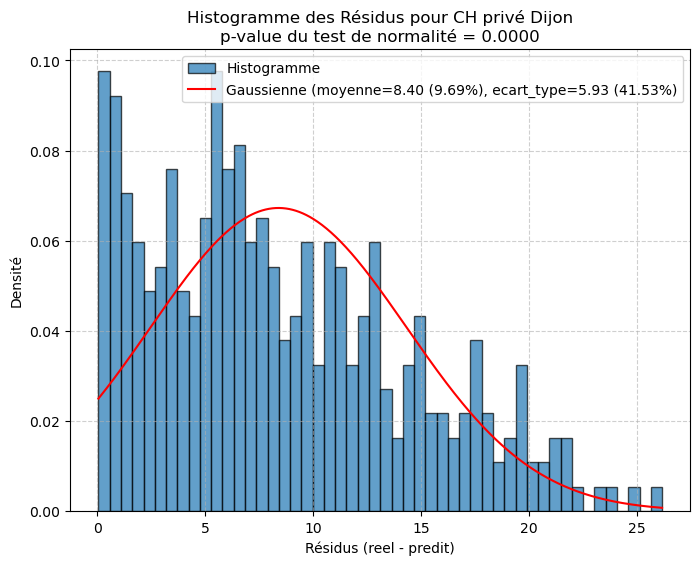

   - MAE : 9.25 (8.94 sur 2023)
   - MSE : 183.11 (137.27 sur 2023)


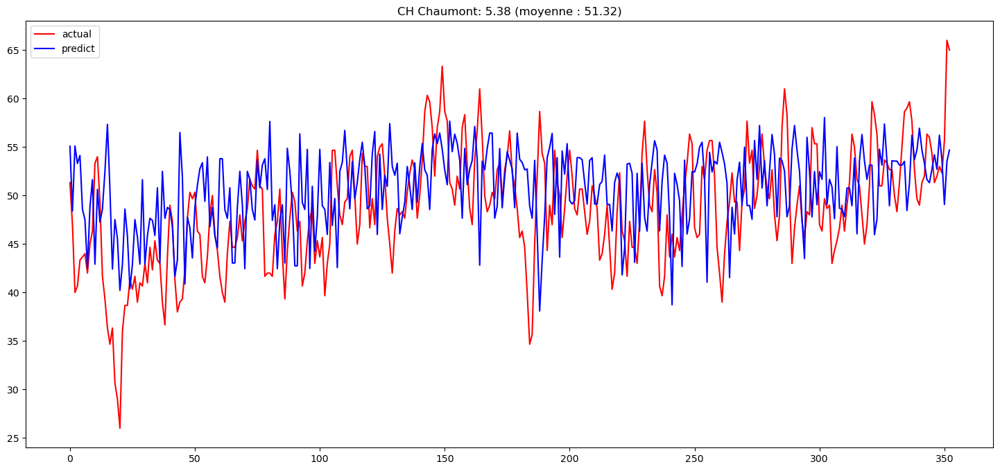

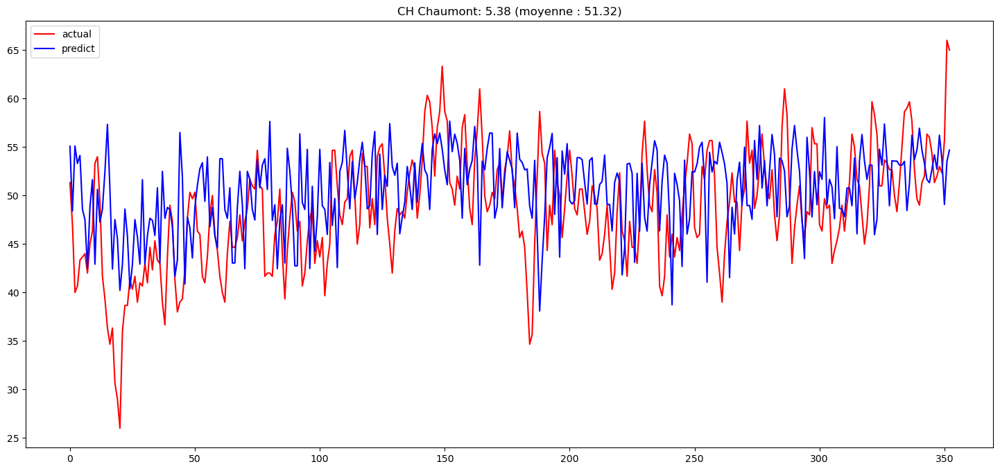

<Figure size 800x600 with 0 Axes>

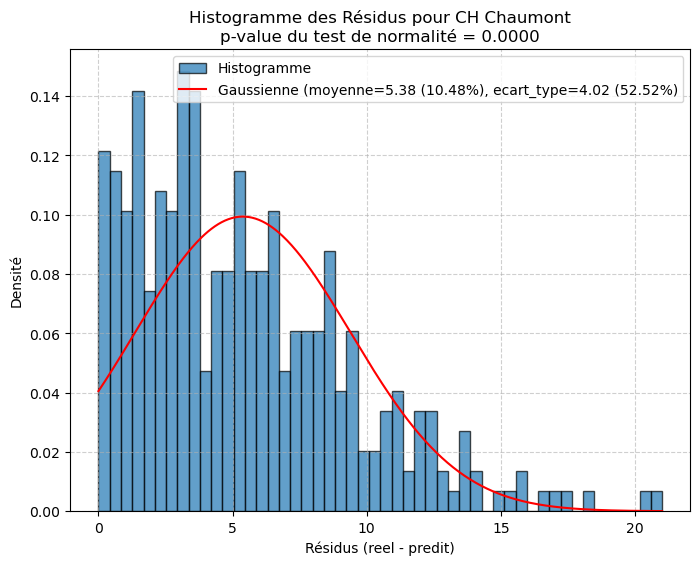

   - MAE : 9.25 (5.55 sur 2023)
   - MSE : 183.11 (49.49 sur 2023)


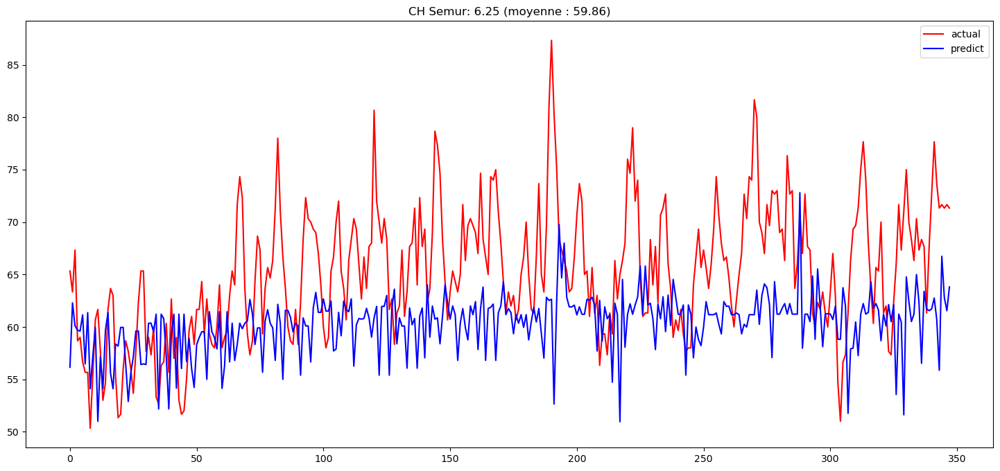

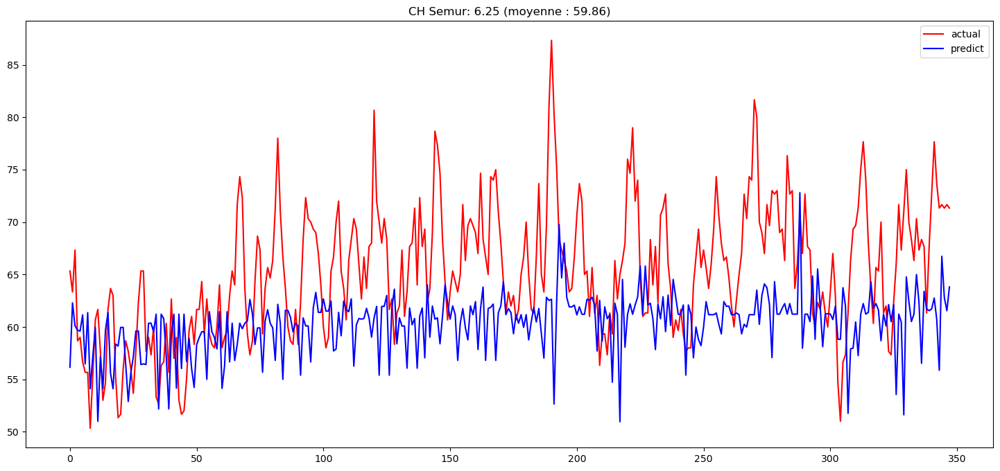

<Figure size 800x600 with 0 Axes>

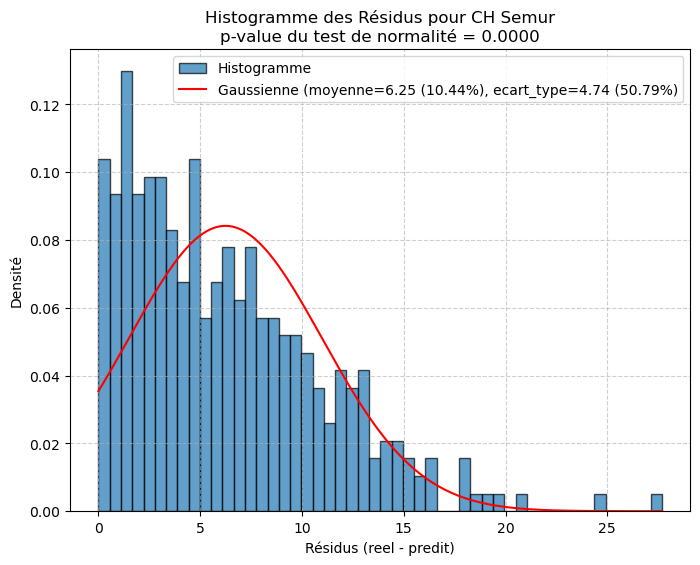

   - MAE : 9.25 (6.31 sur 2023)
   - MSE : 183.11 (63.20 sur 2023)


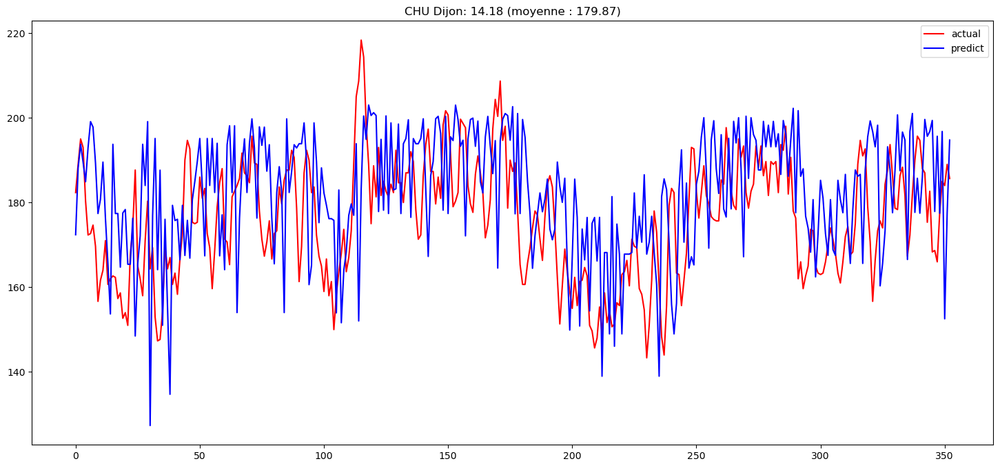

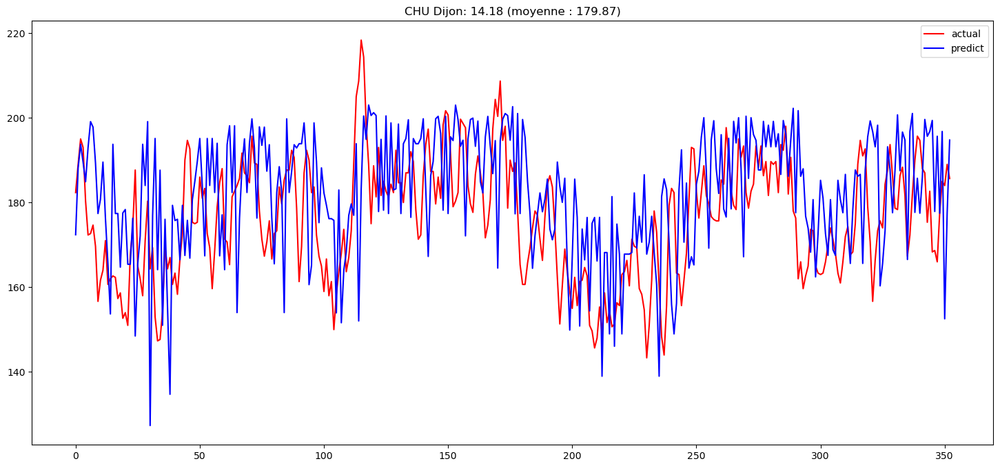

<Figure size 800x600 with 0 Axes>

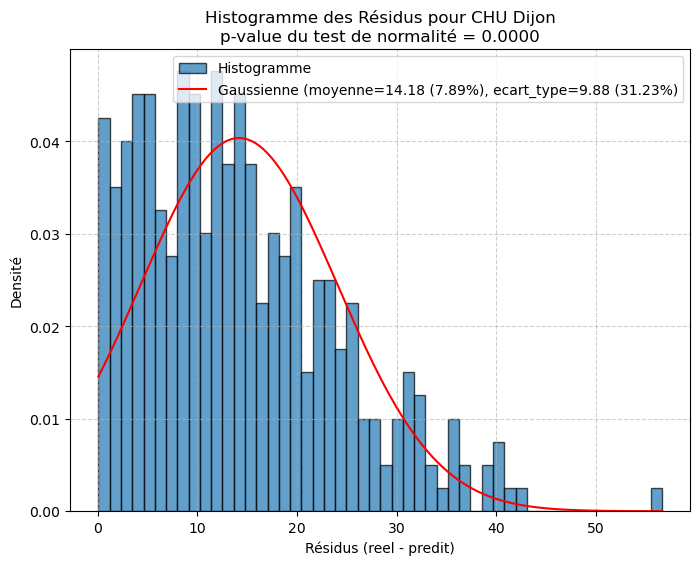

   - MAE : 9.25 (14.21 sur 2023)
   - MSE : 183.11 (299.33 sur 2023)


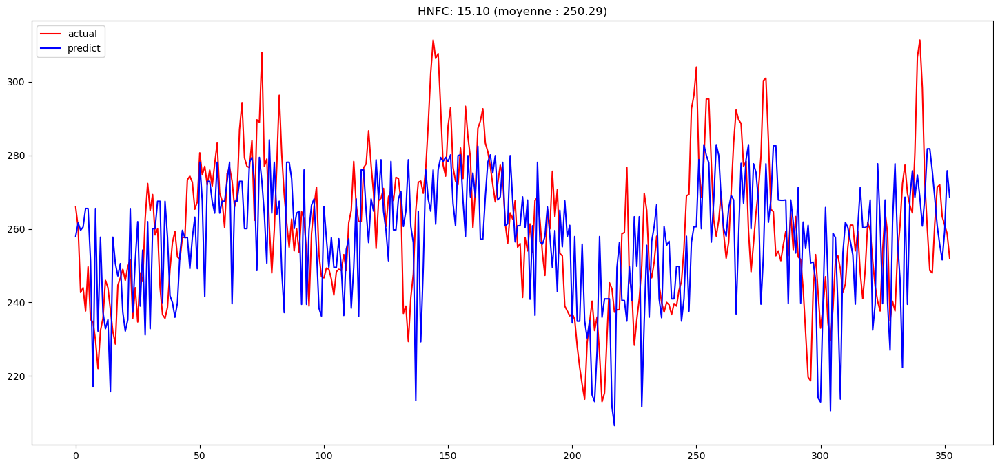

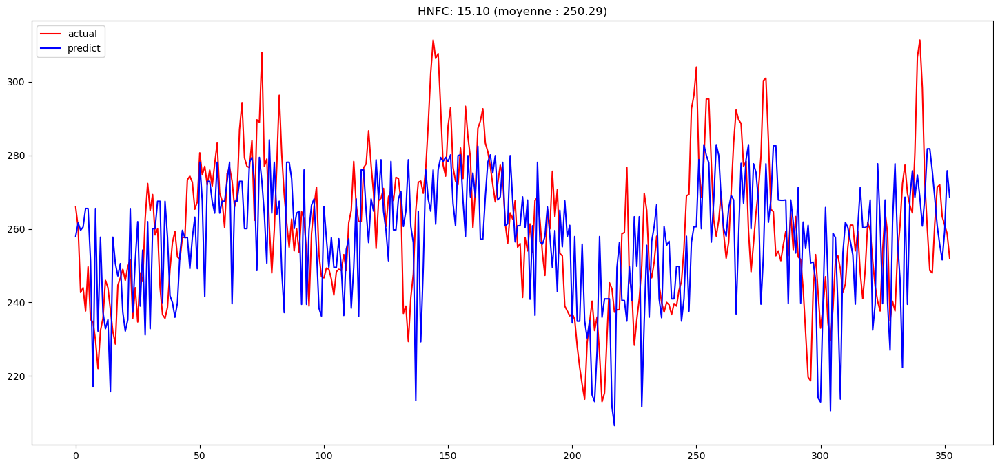

<Figure size 800x600 with 0 Axes>

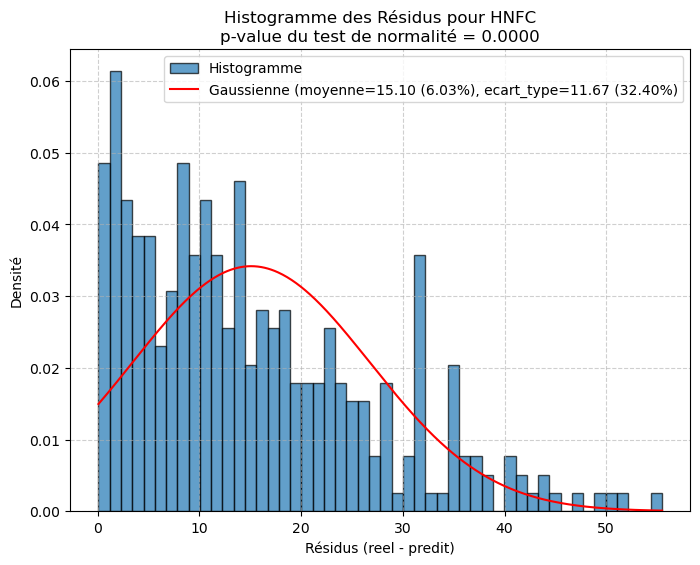

   - MAE : 9.25 (17.18 sur 2023)
   - MSE : 183.11 (769.22 sur 2023)


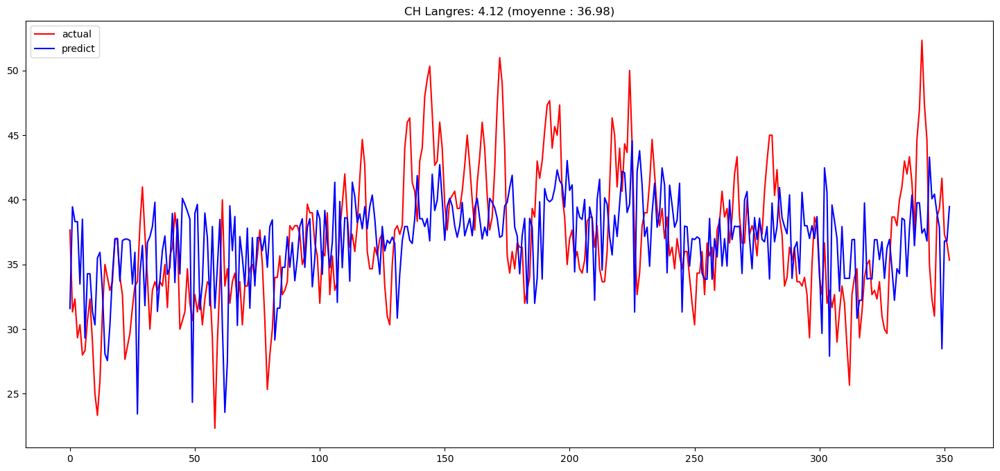

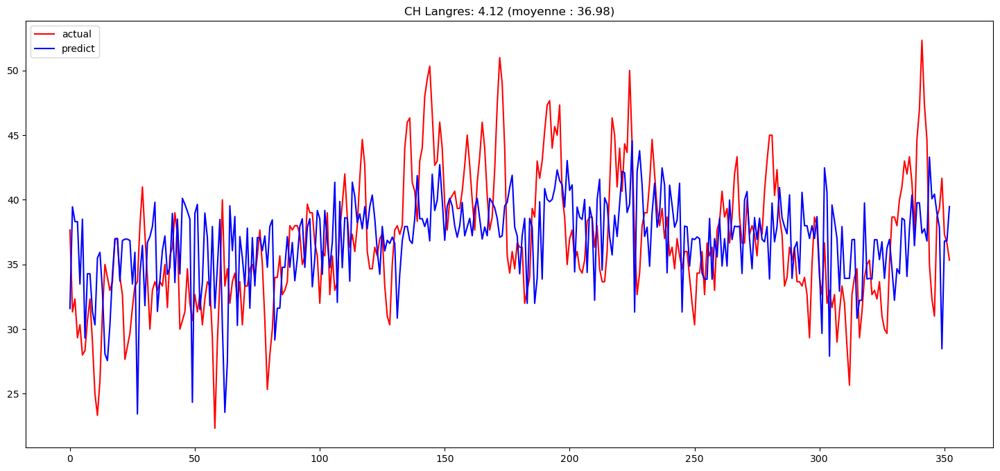

<Figure size 800x600 with 0 Axes>

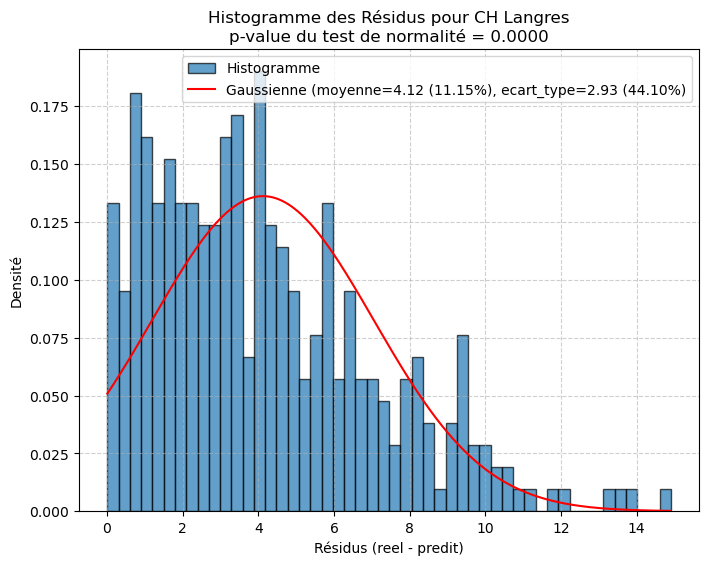

   - MAE : 9.25 (4.49 sur 2023)
   - MSE : 183.11 (39.09 sur 2023)


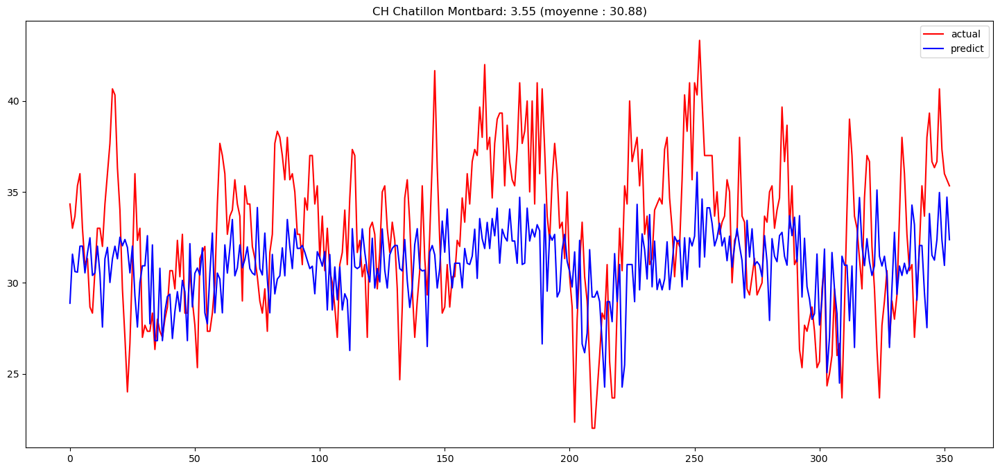

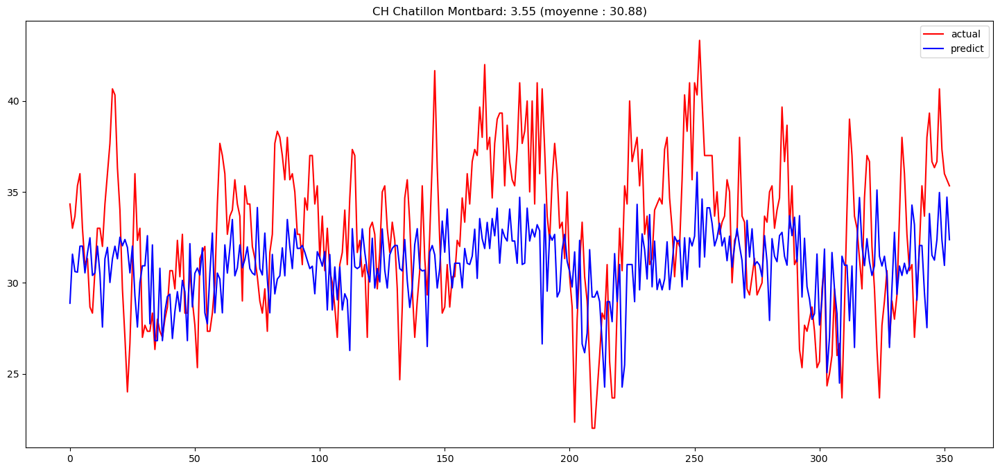

<Figure size 800x600 with 0 Axes>

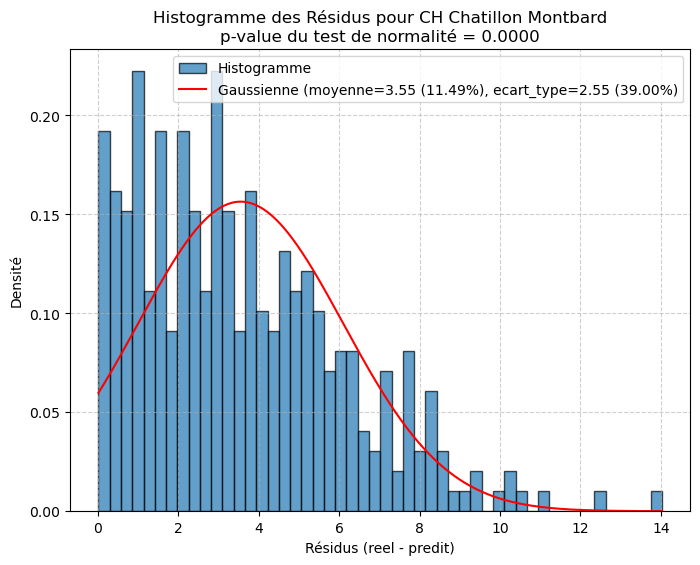

   - MAE : 9.25 (3.81 sur 2023)
   - MSE : 183.11 (25.83 sur 2023)


In [21]:
new_col = 'holidays'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

In [22]:
new_col = 'date##dayofweek_cos'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (3): ['arrivees_urgences', 'holidays', 'hopital']


Colonnes actuelles (4): ['arrivees_urgences', 'hopital', 'date##dayofweek_cos', 'holidays']
Amélioration avec max_depth=4: 184.4089 -> 160.0401


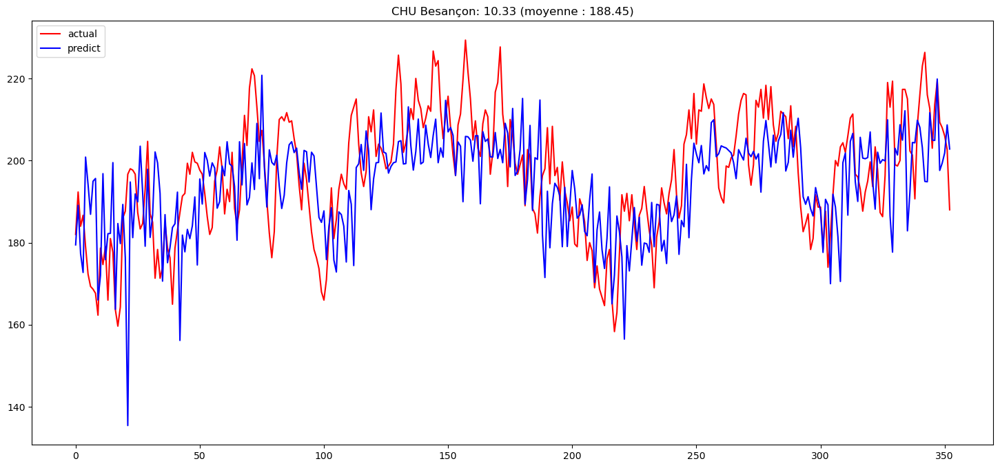

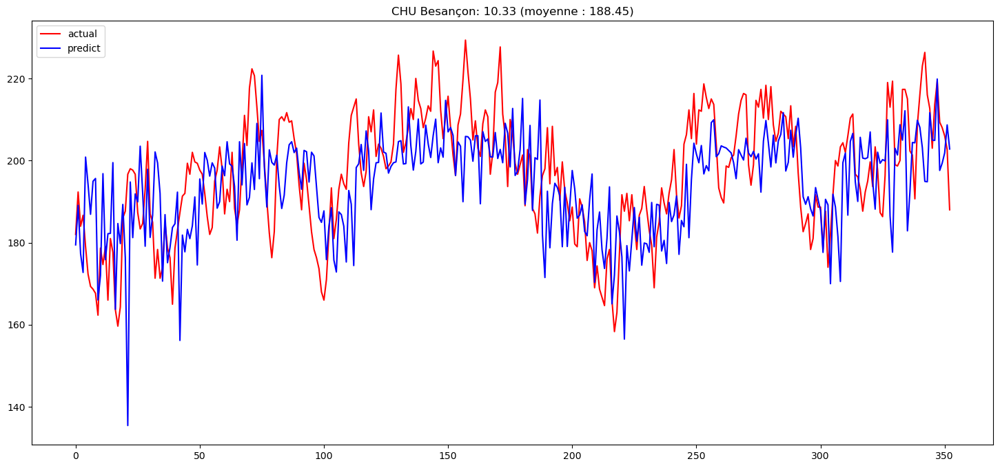

<Figure size 800x600 with 0 Axes>

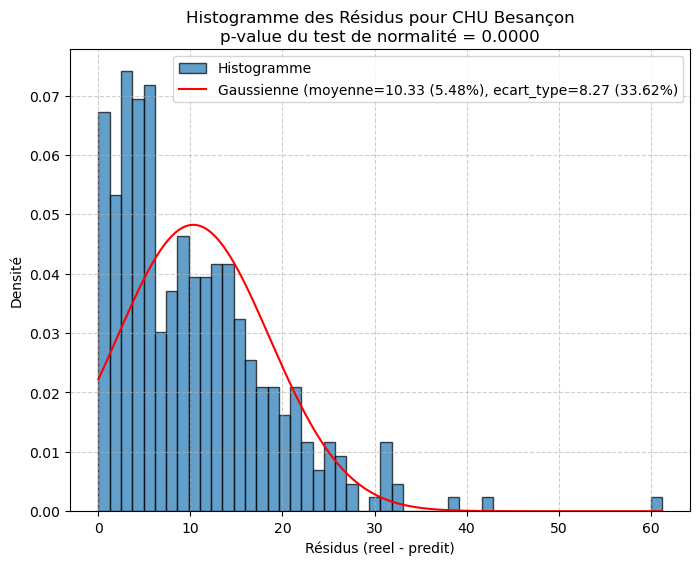

   - MAE : 8.64 (10.40 sur 2023)
   - MSE : 160.04 (177.75 sur 2023)


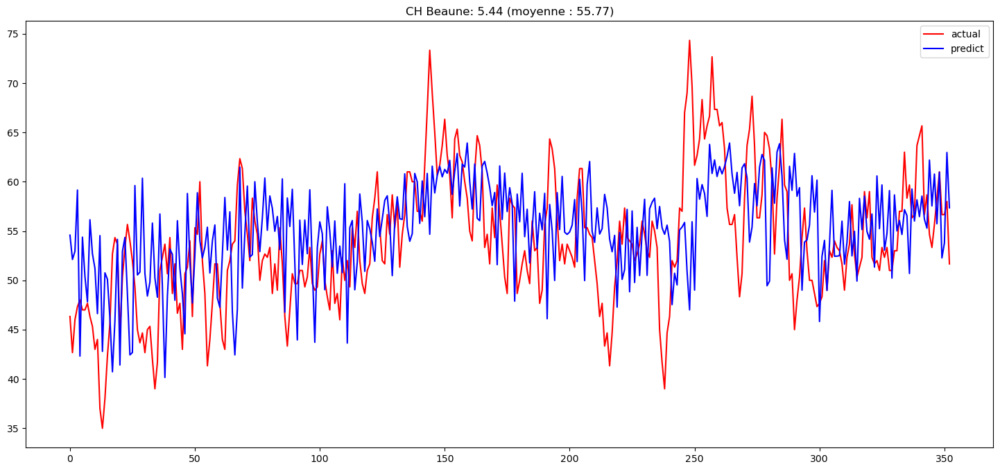

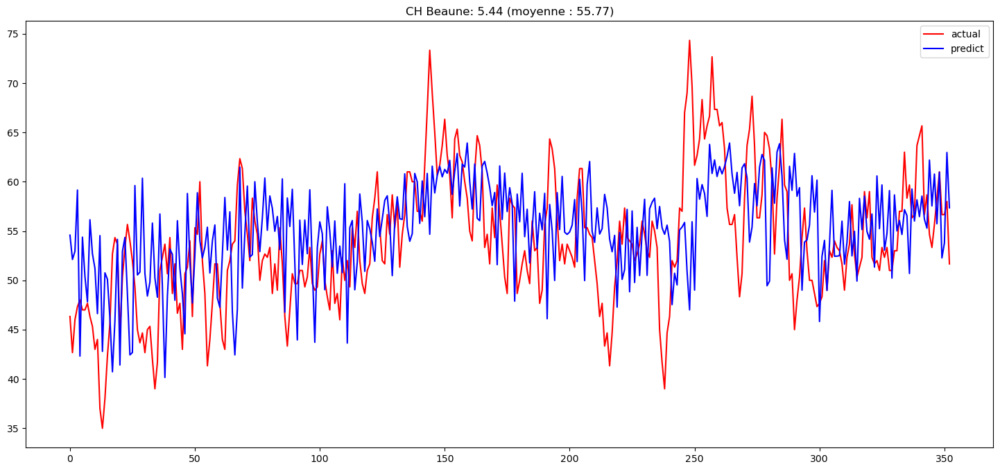

<Figure size 800x600 with 0 Axes>

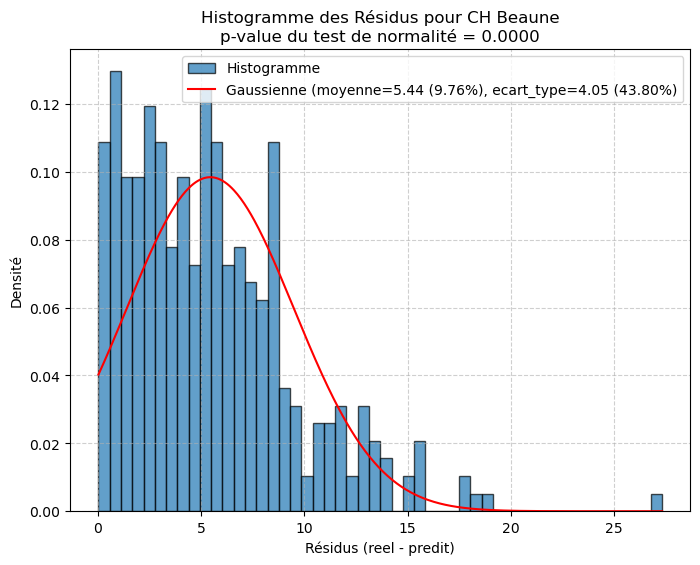

   - MAE : 8.64 (5.44 sur 2023)
   - MSE : 160.04 (46.01 sur 2023)


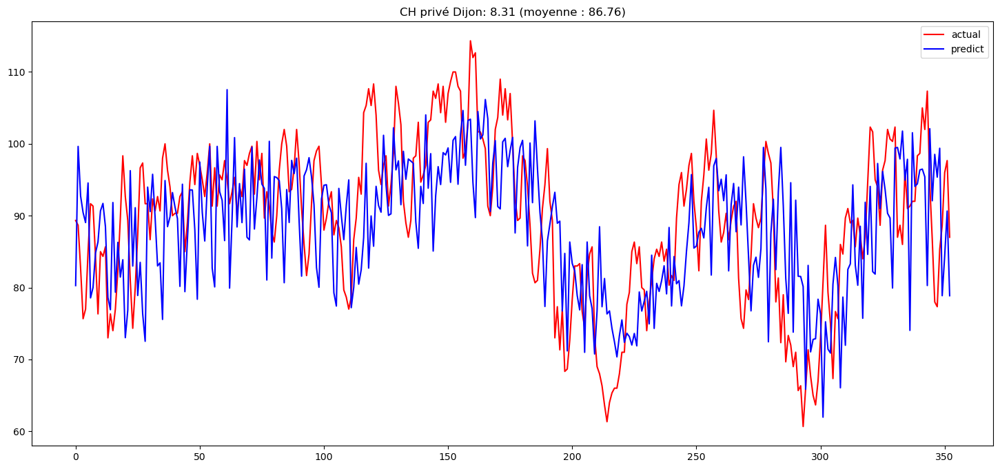

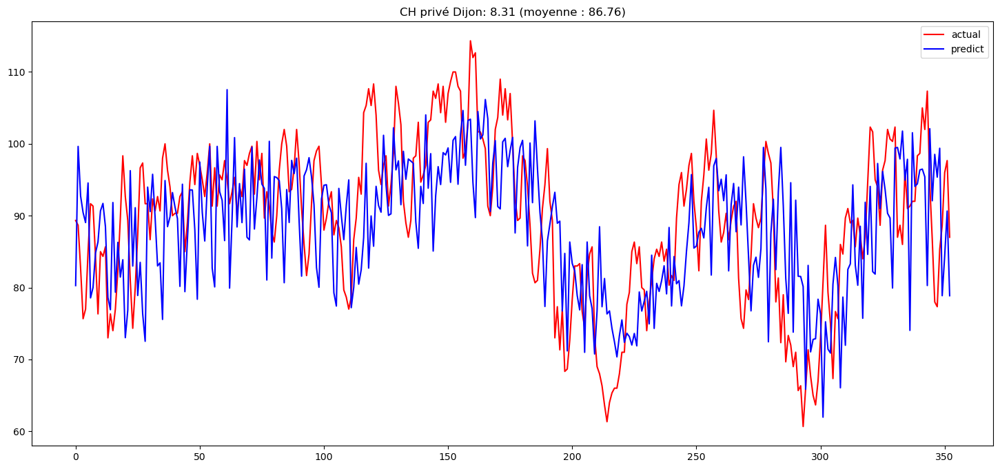

<Figure size 800x600 with 0 Axes>

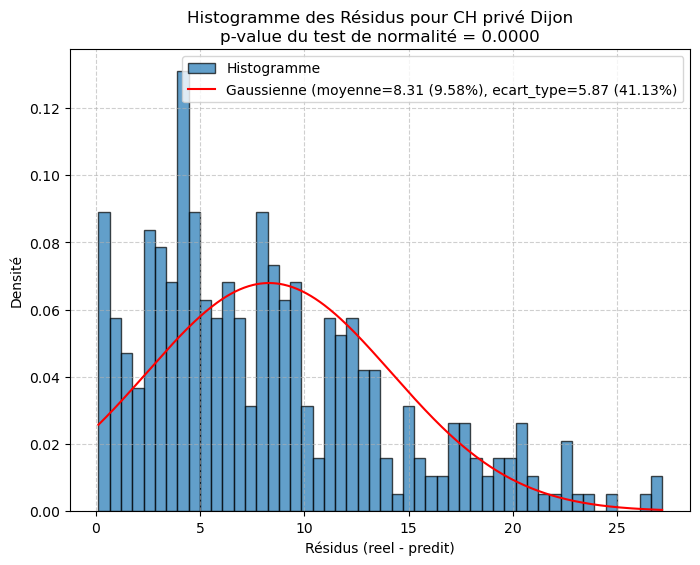

   - MAE : 8.64 (8.87 sur 2023)
   - MSE : 160.04 (136.85 sur 2023)


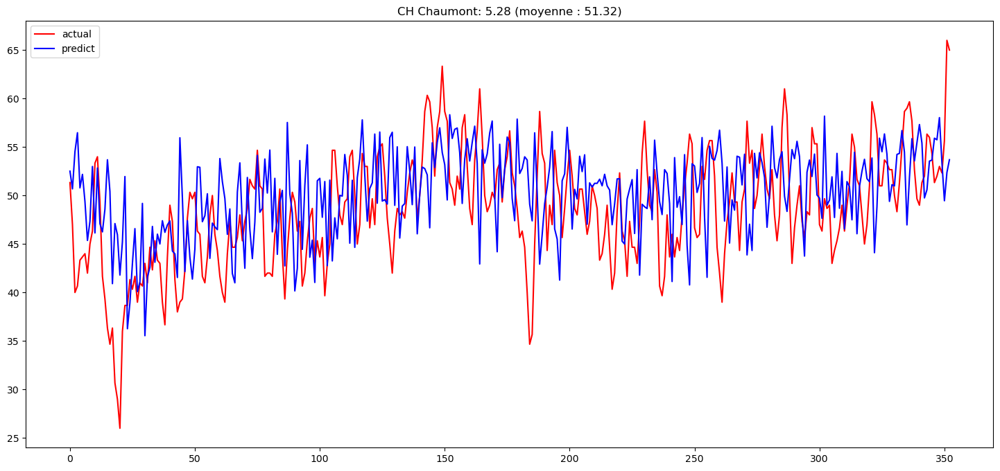

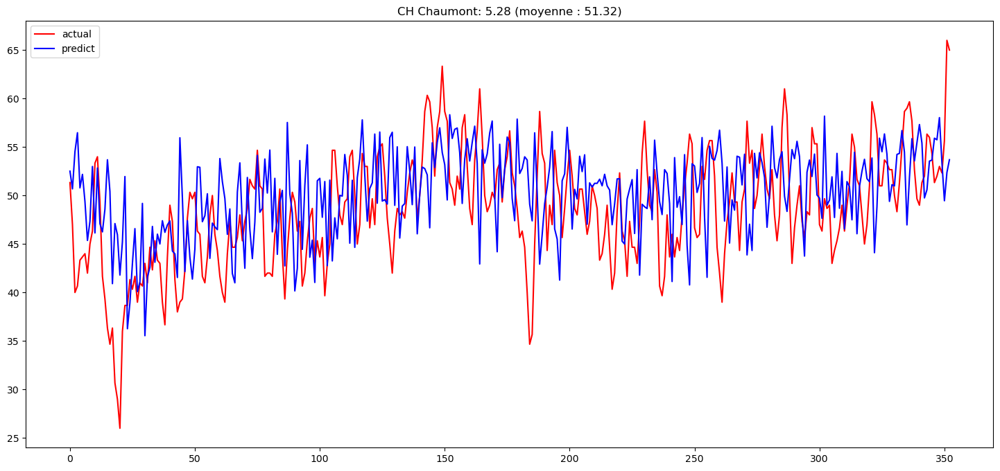

<Figure size 800x600 with 0 Axes>

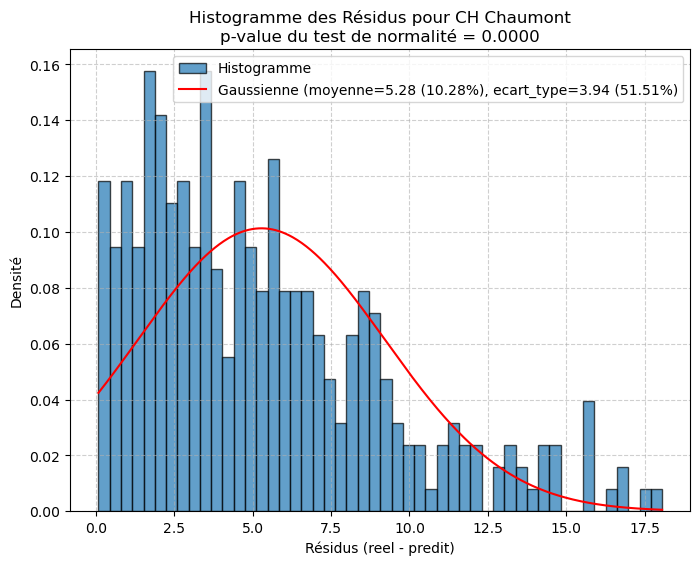

   - MAE : 8.64 (5.44 sur 2023)
   - MSE : 160.04 (47.66 sur 2023)


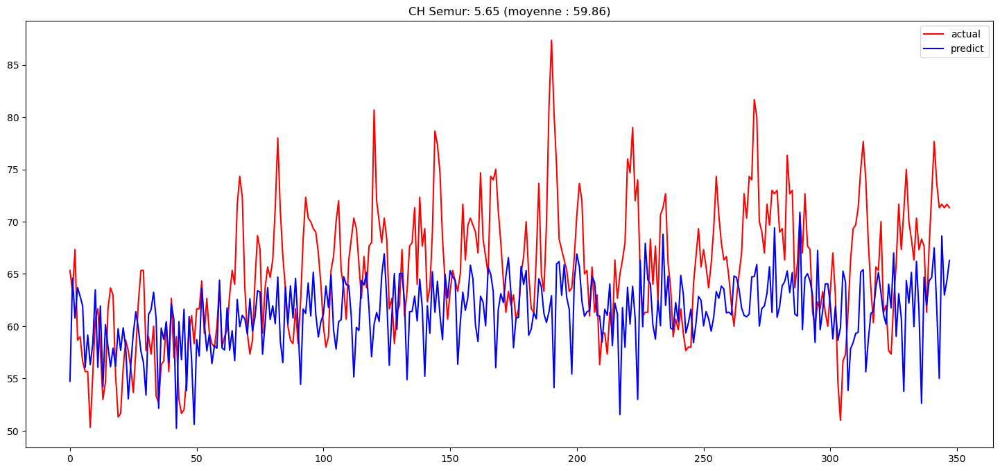

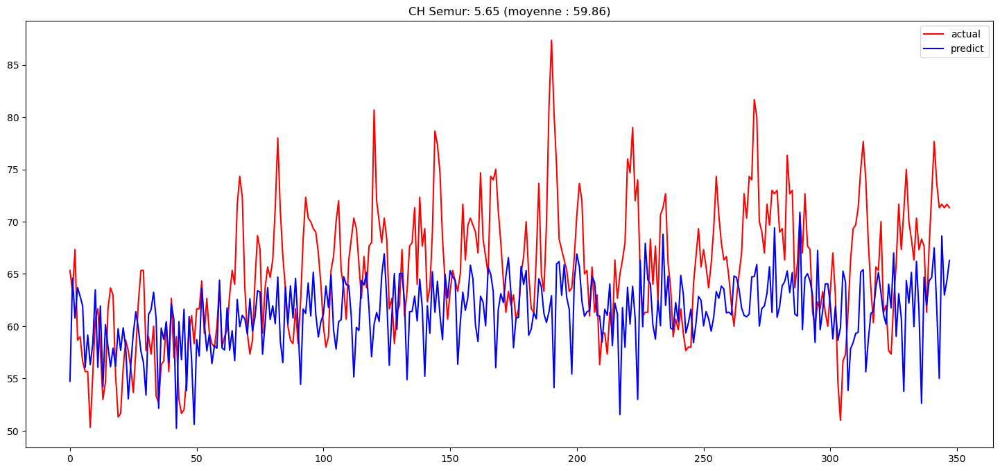

<Figure size 800x600 with 0 Axes>

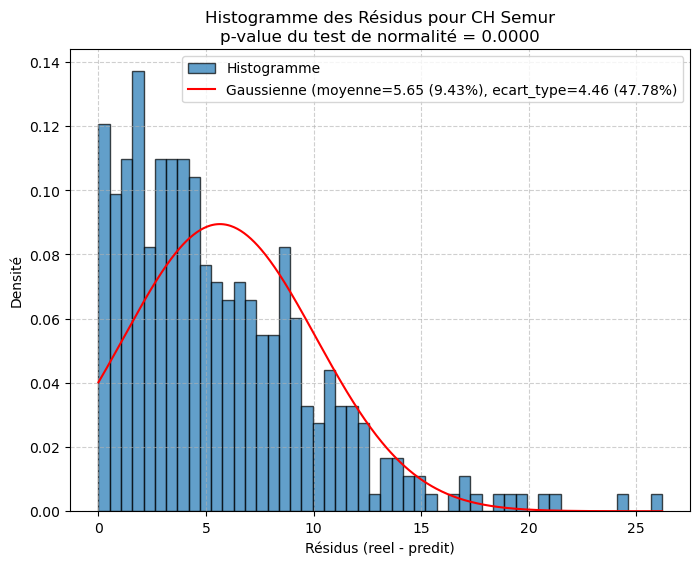

   - MAE : 8.64 (5.71 sur 2023)
   - MSE : 160.04 (53.36 sur 2023)


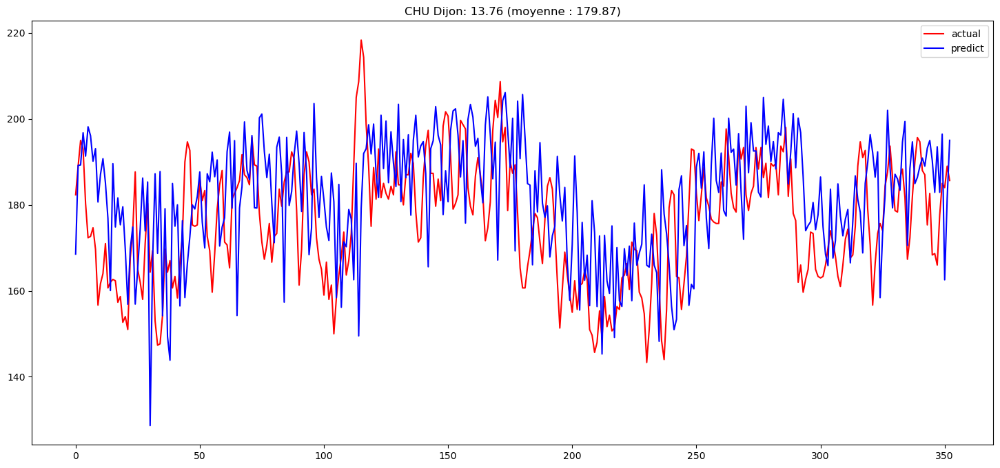

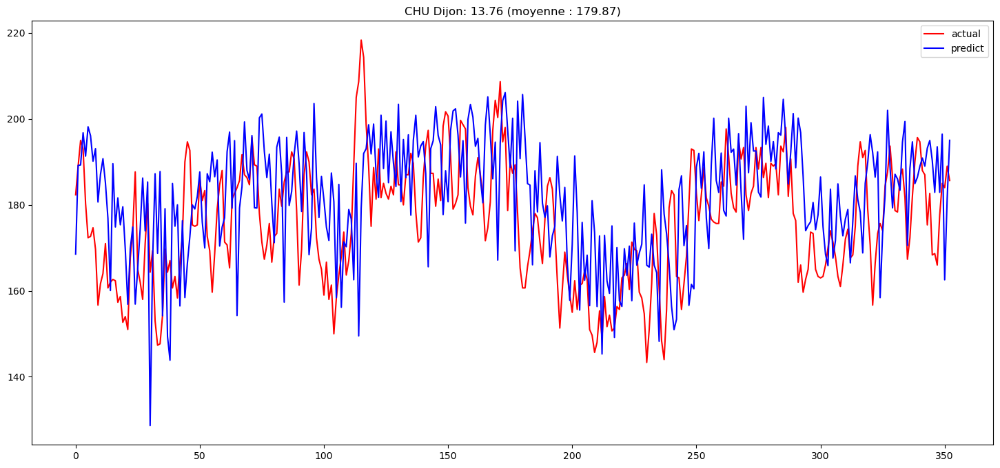

<Figure size 800x600 with 0 Axes>

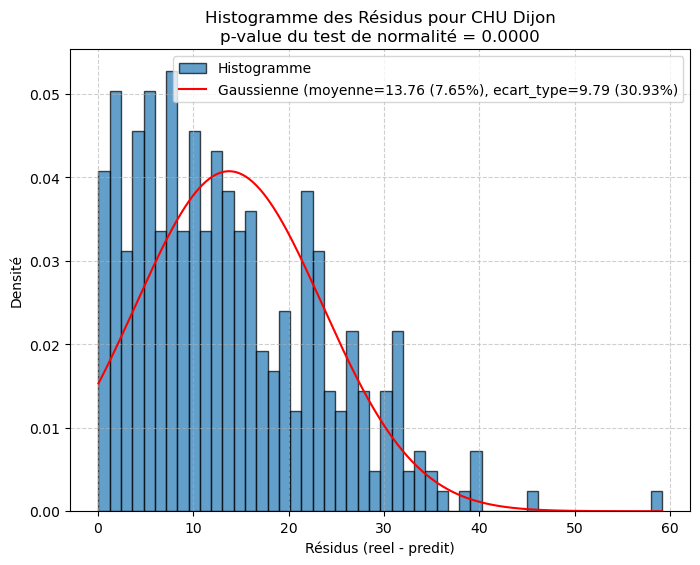

   - MAE : 8.64 (13.83 sur 2023)
   - MSE : 160.04 (287.16 sur 2023)


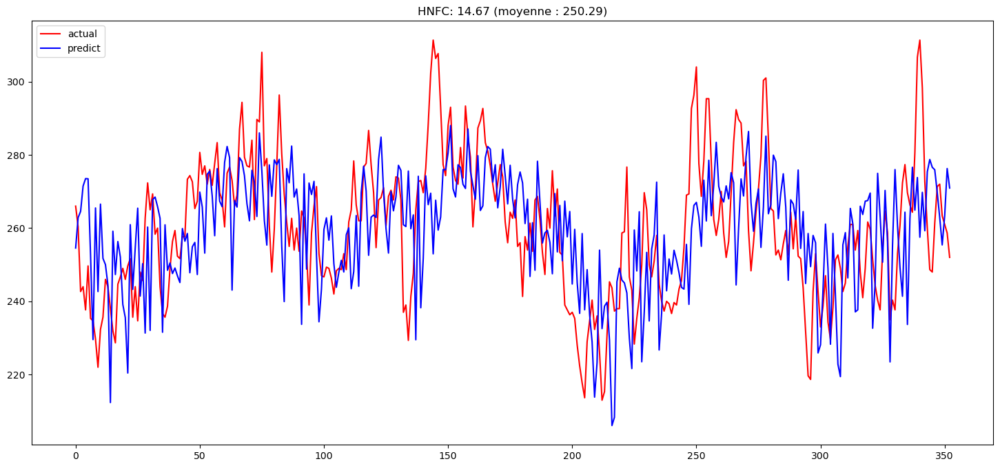

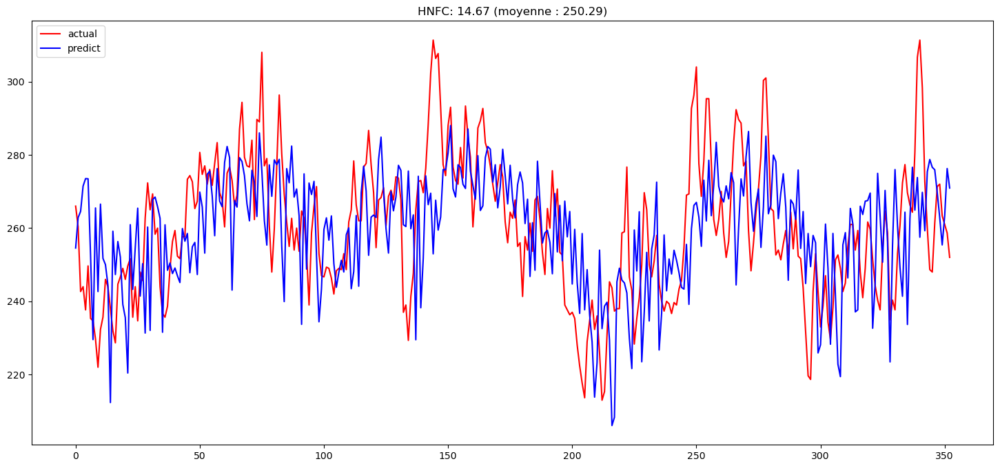

<Figure size 800x600 with 0 Axes>

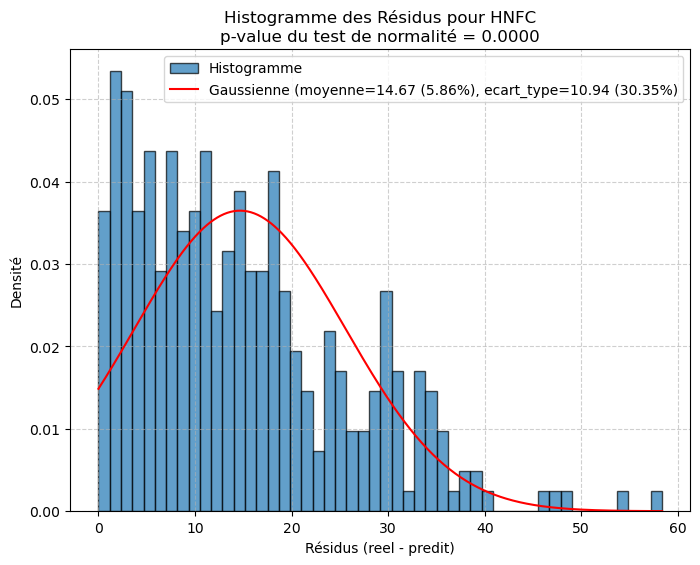

   - MAE : 8.64 (16.78 sur 2023)
   - MSE : 160.04 (743.33 sur 2023)


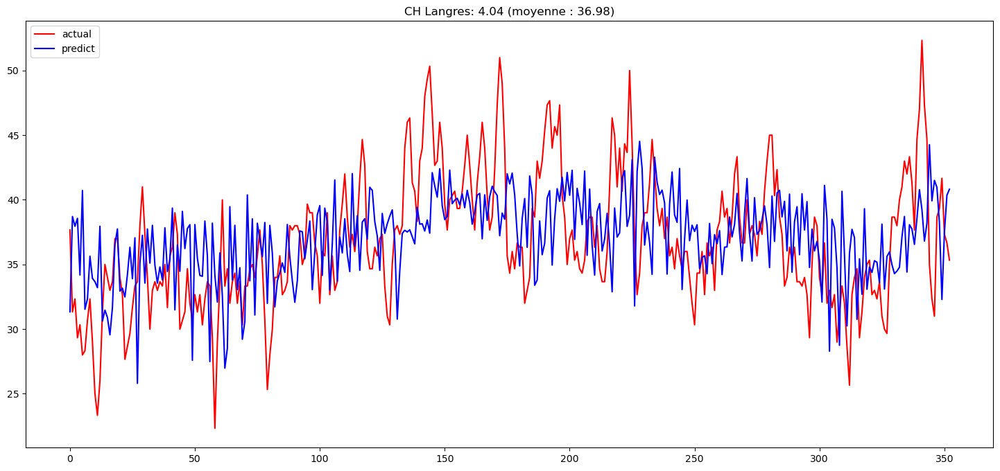

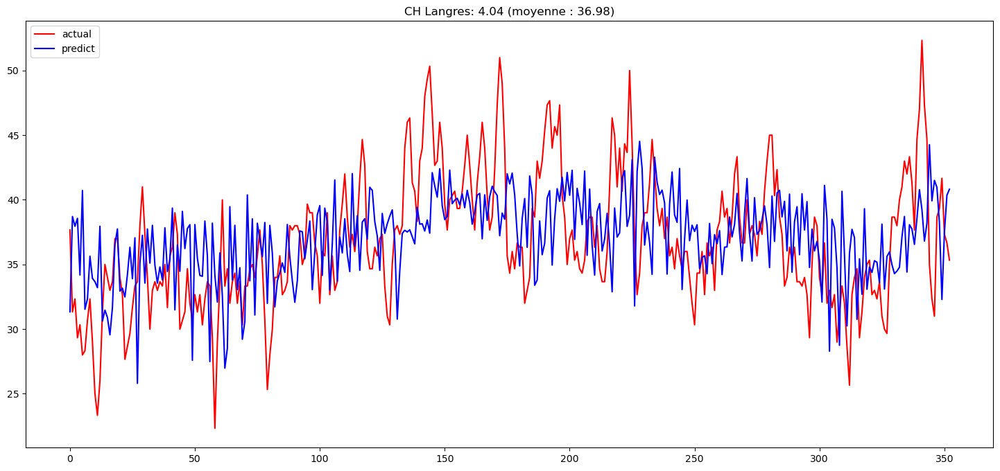

<Figure size 800x600 with 0 Axes>

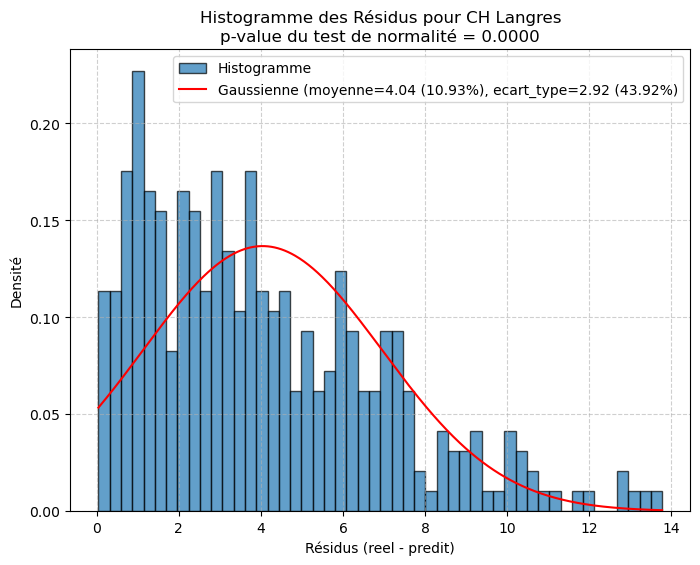

   - MAE : 8.64 (4.41 sur 2023)
   - MSE : 160.04 (39.13 sur 2023)


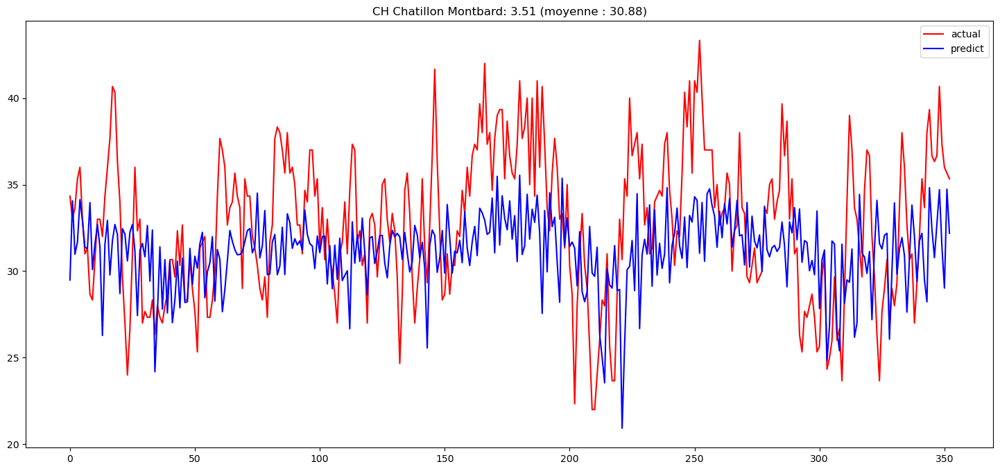

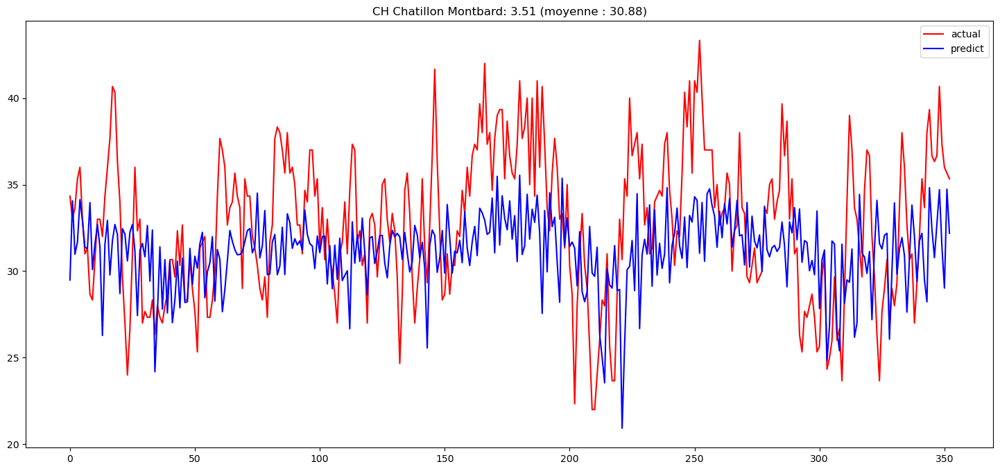

<Figure size 800x600 with 0 Axes>

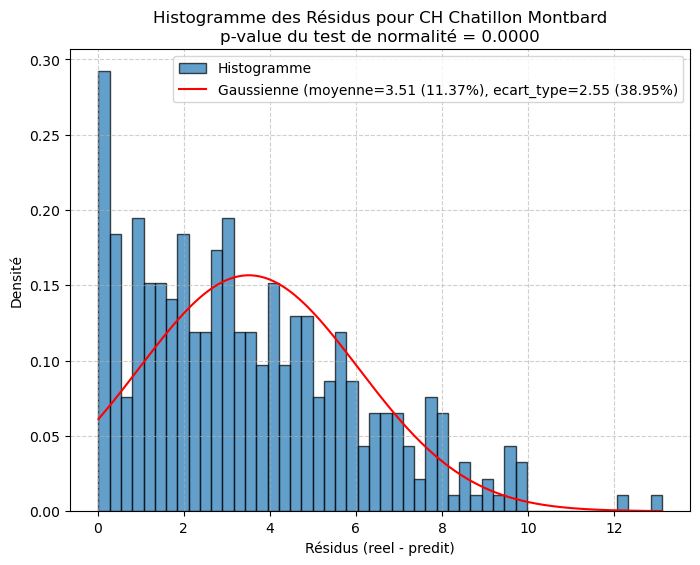

   - MAE : 8.64 (3.76 sur 2023)
   - MSE : 160.04 (25.32 sur 2023)


In [23]:
new_col = 'nb_emmergencies%%J-7'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

In [24]:
new_col = 'NO2_FR26014%%J-2'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (5): ['holidays', 'hopital', 'arrivees_urgences', 'date##dayofweek_cos', 'nb_emmergencies%%J-7']


Colonnes actuelles (6): ['holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7']
Amélioration avec max_depth=4: 160.9053 -> 140.4546


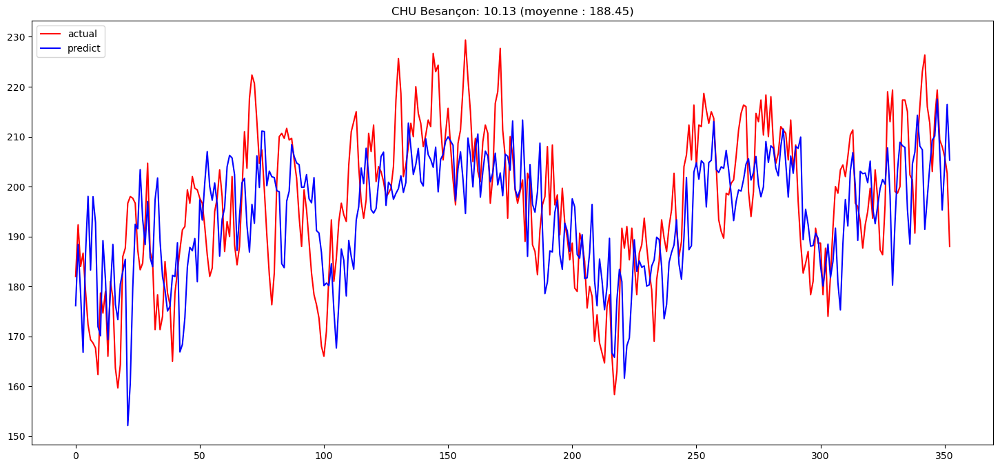

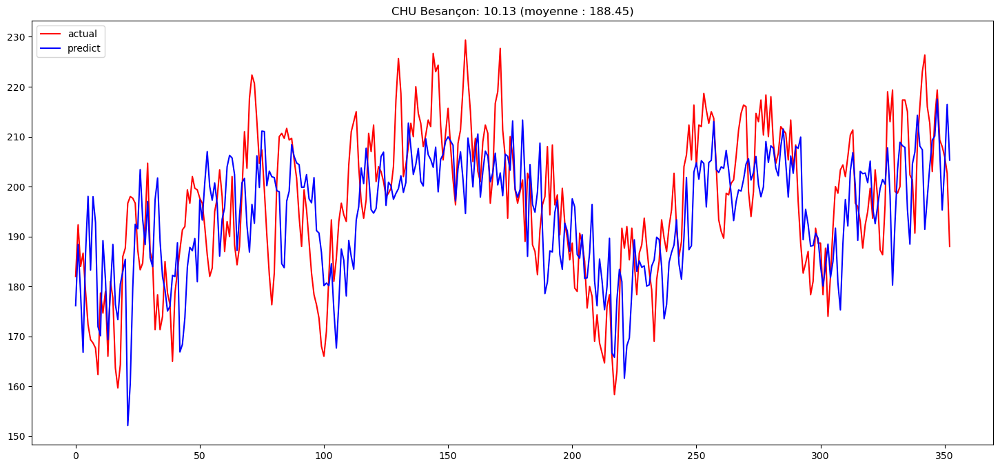

<Figure size 800x600 with 0 Axes>

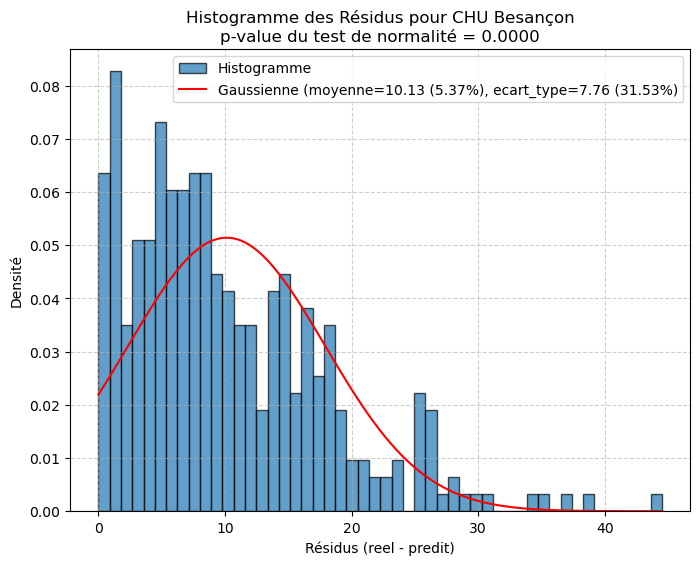

   - MAE : 8.09 (10.20 sur 2023)
   - MSE : 140.45 (165.57 sur 2023)


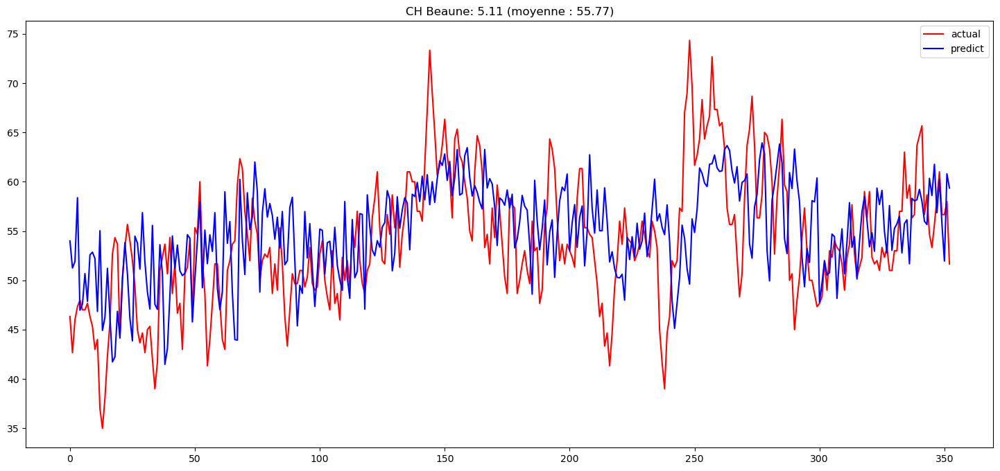

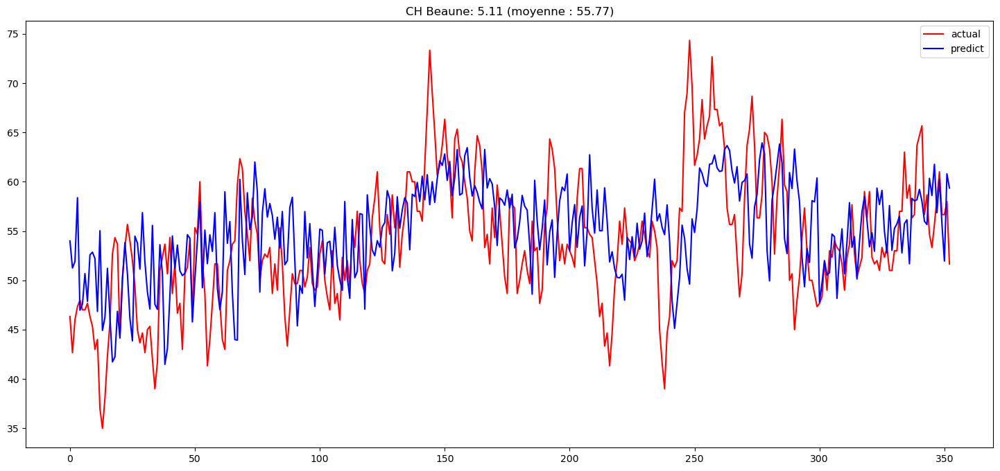

<Figure size 800x600 with 0 Axes>

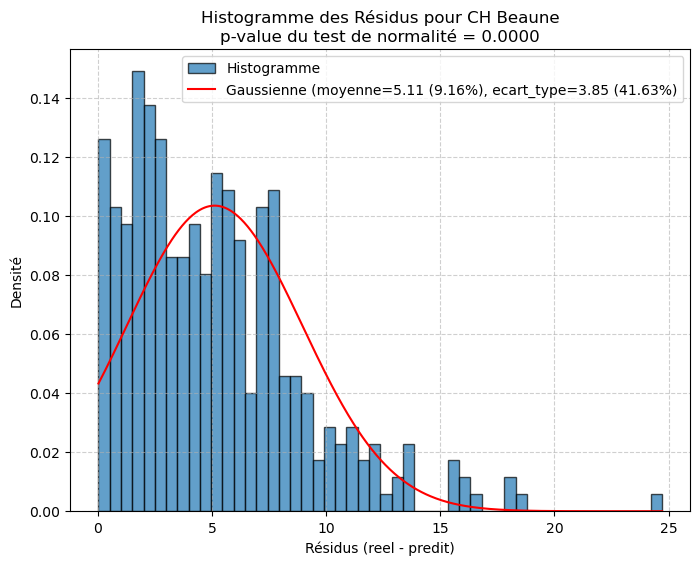

   - MAE : 8.09 (5.10 sur 2023)
   - MSE : 140.45 (40.80 sur 2023)


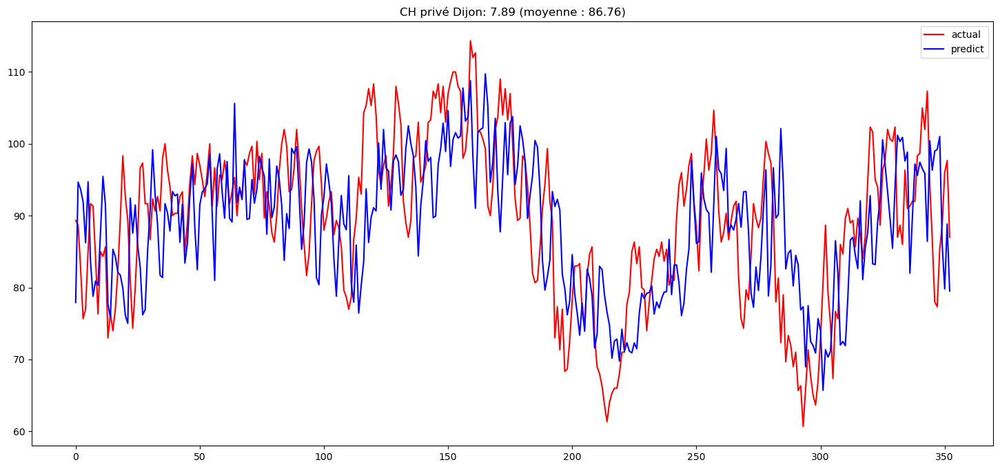

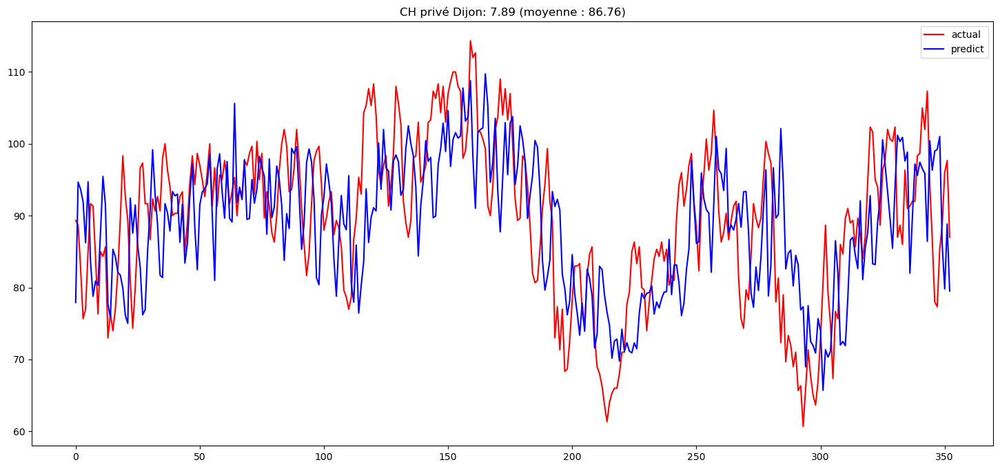

<Figure size 800x600 with 0 Axes>

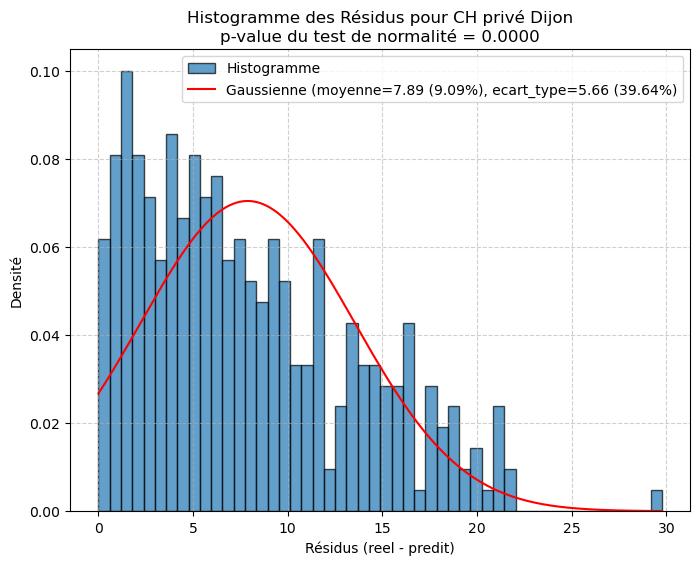

   - MAE : 8.09 (8.47 sur 2023)
   - MSE : 140.45 (130.46 sur 2023)


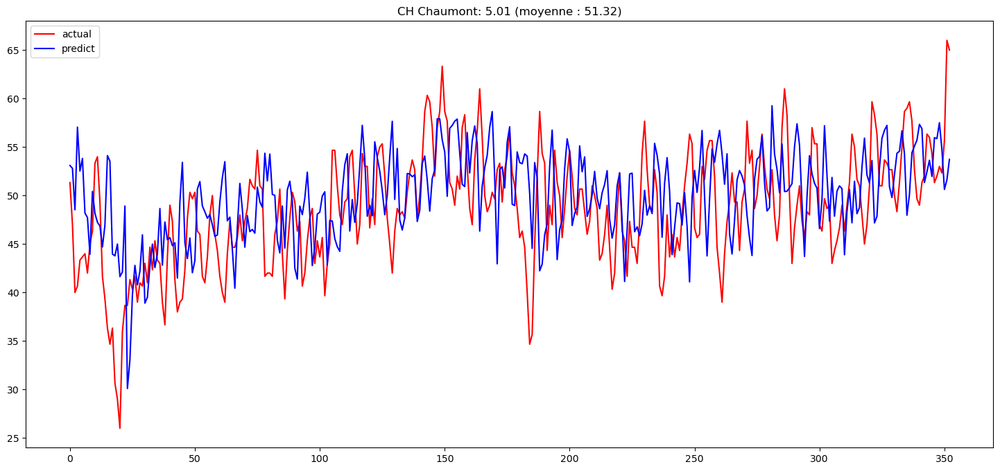

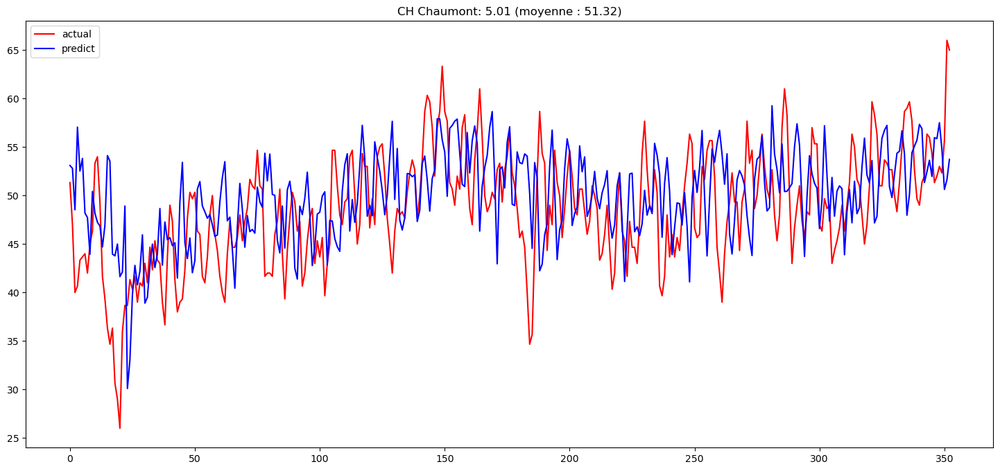

<Figure size 800x600 with 0 Axes>

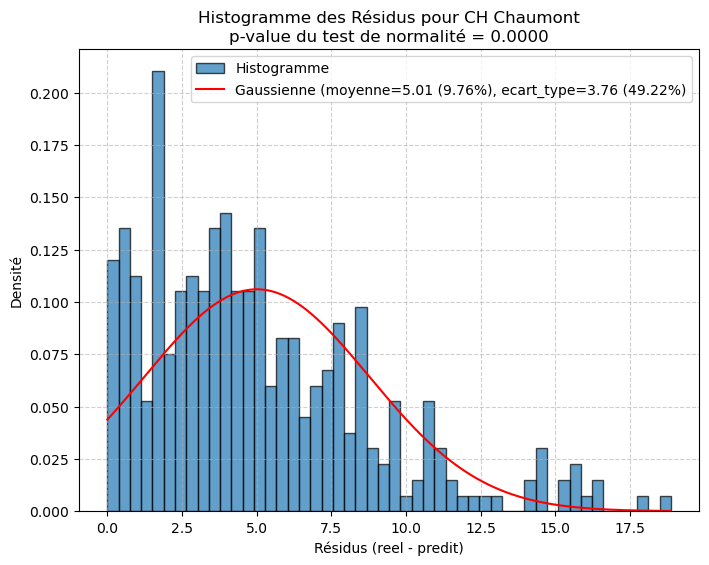

   - MAE : 8.09 (5.18 sur 2023)
   - MSE : 140.45 (44.04 sur 2023)


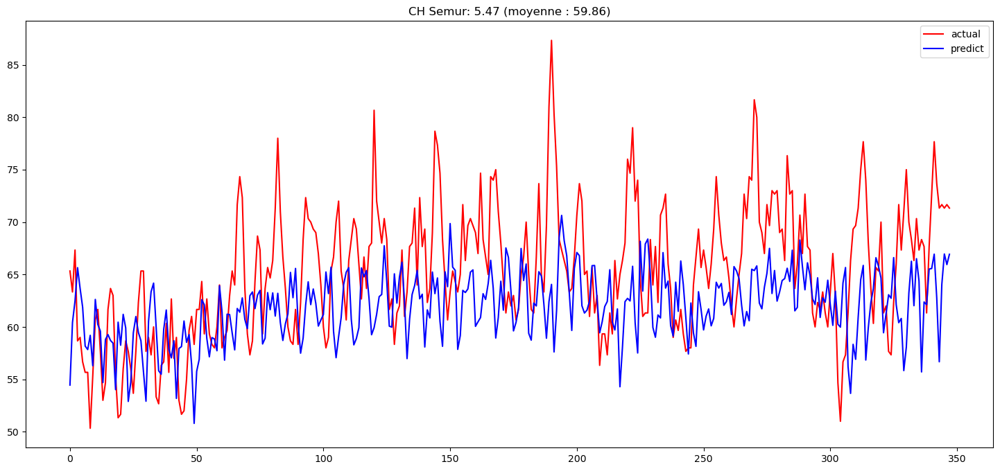

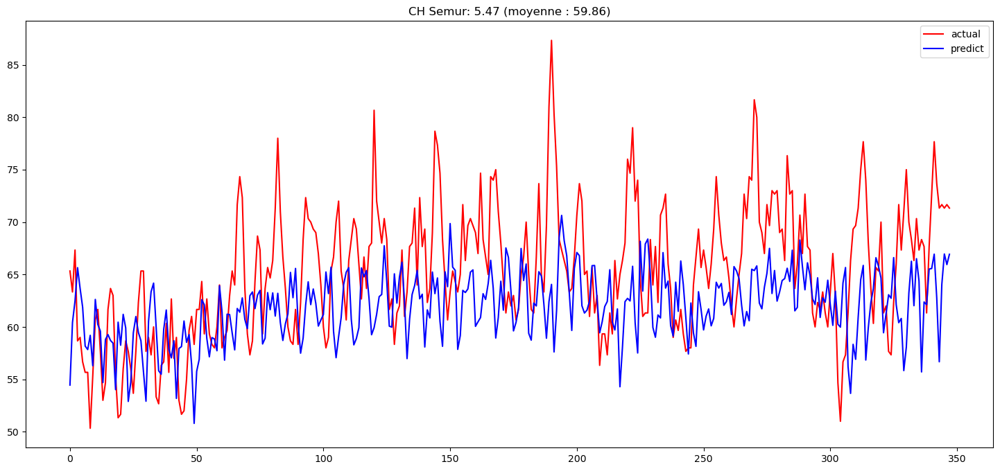

<Figure size 800x600 with 0 Axes>

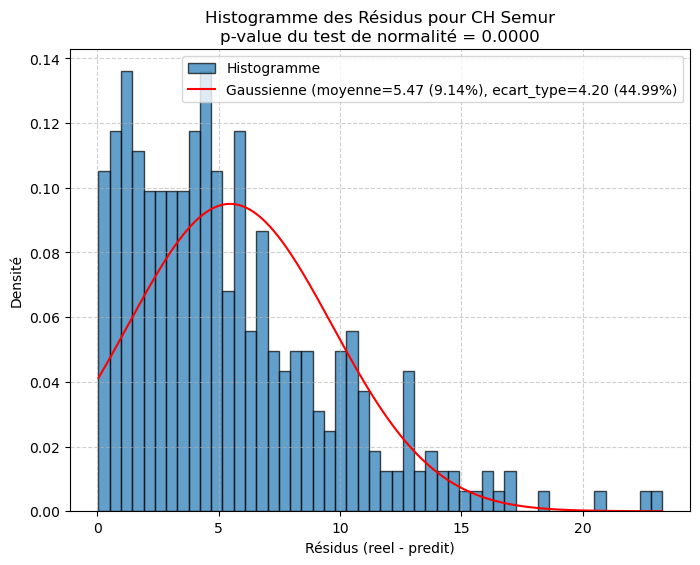

   - MAE : 8.09 (5.54 sur 2023)
   - MSE : 140.45 (49.07 sur 2023)


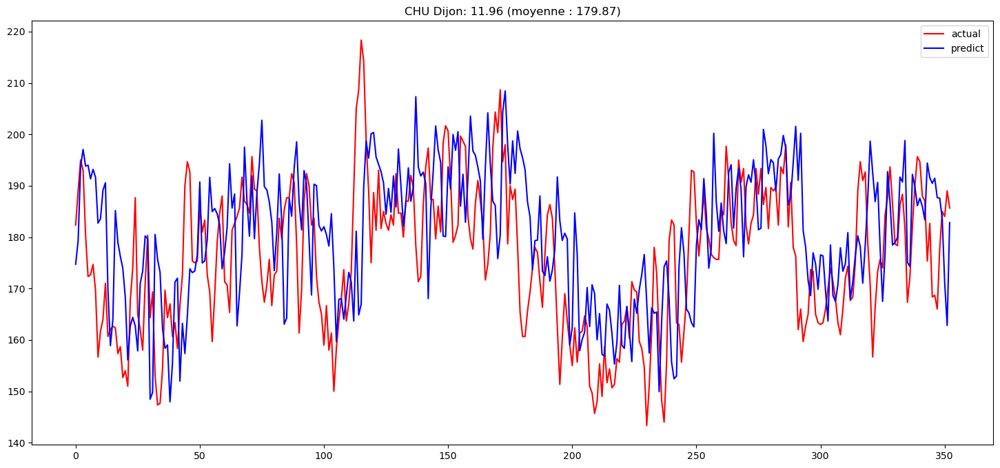

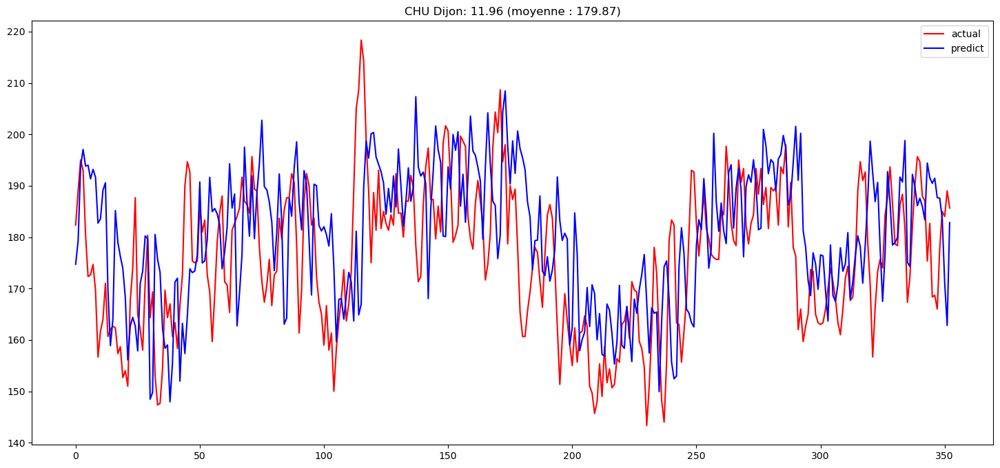

<Figure size 800x600 with 0 Axes>

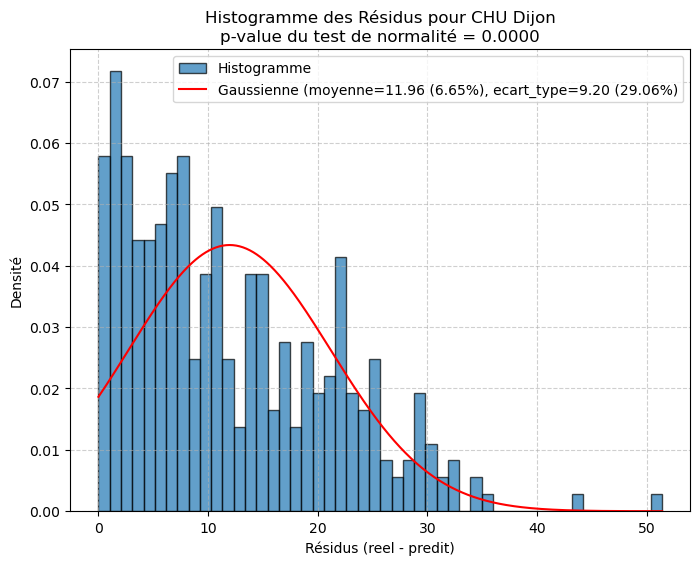

   - MAE : 8.09 (12.03 sur 2023)
   - MSE : 140.45 (229.46 sur 2023)


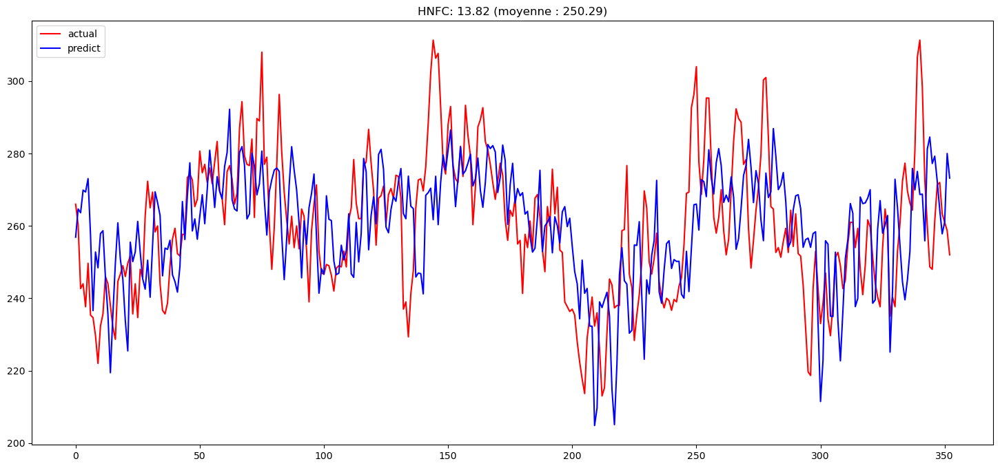

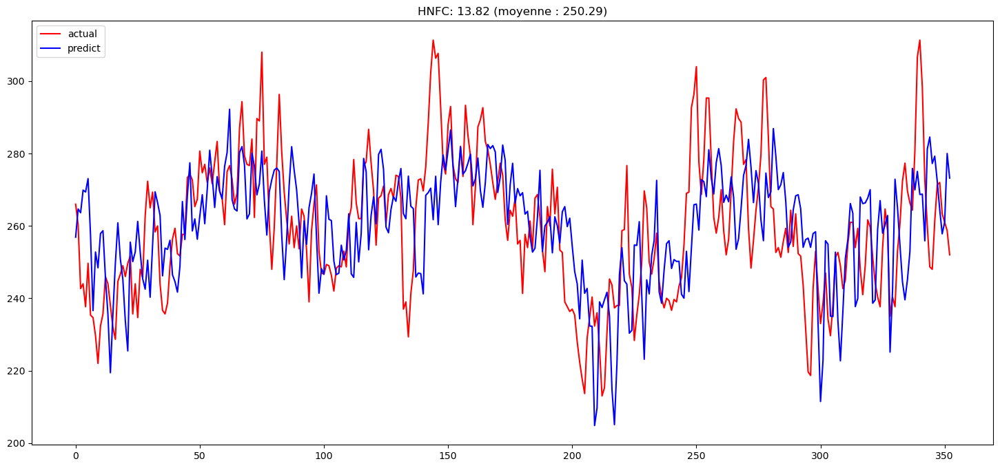

<Figure size 800x600 with 0 Axes>

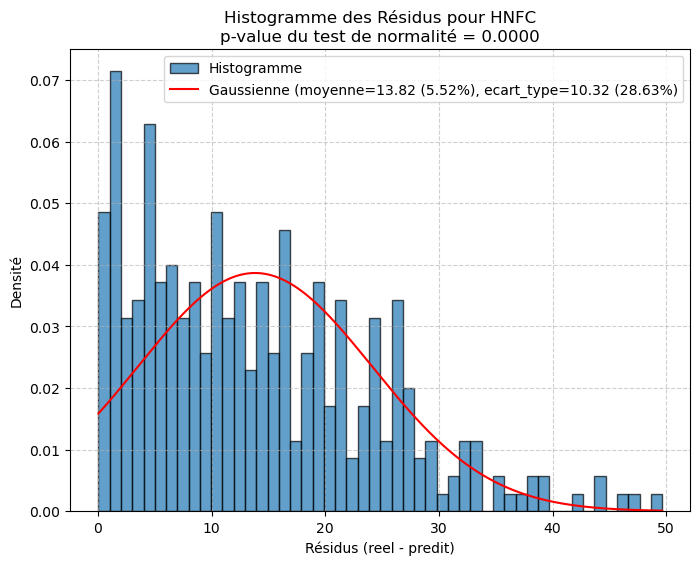

   - MAE : 8.09 (15.98 sur 2023)
   - MSE : 140.45 (716.50 sur 2023)


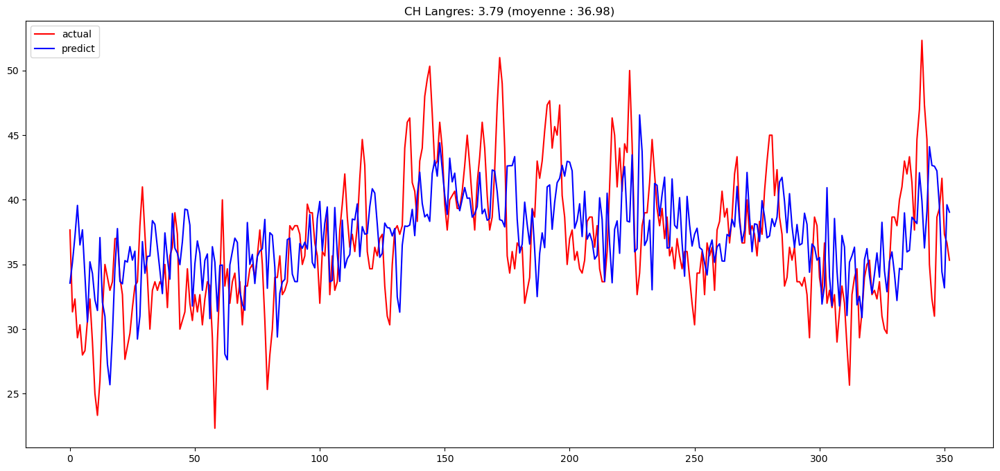

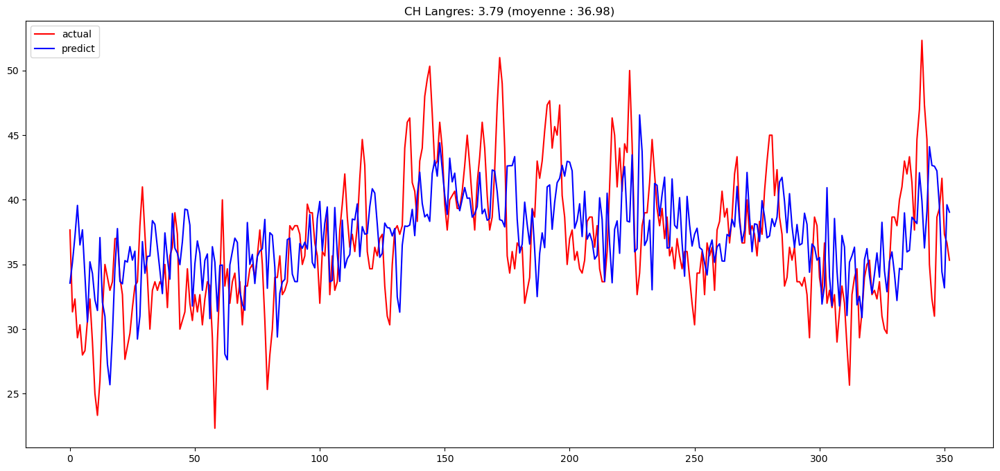

<Figure size 800x600 with 0 Axes>

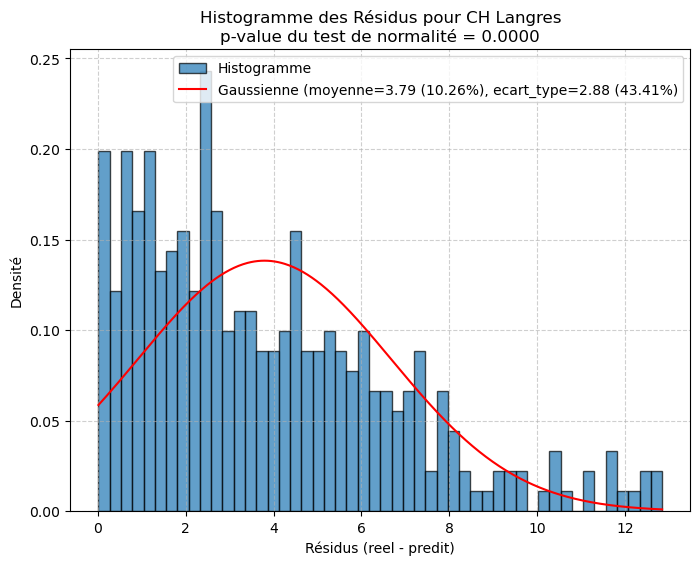

   - MAE : 8.09 (4.17 sur 2023)
   - MSE : 140.45 (36.95 sur 2023)


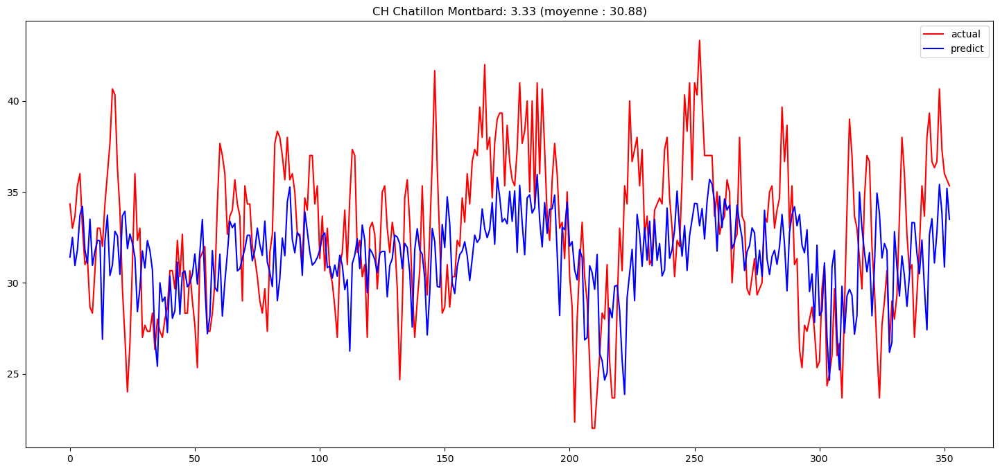

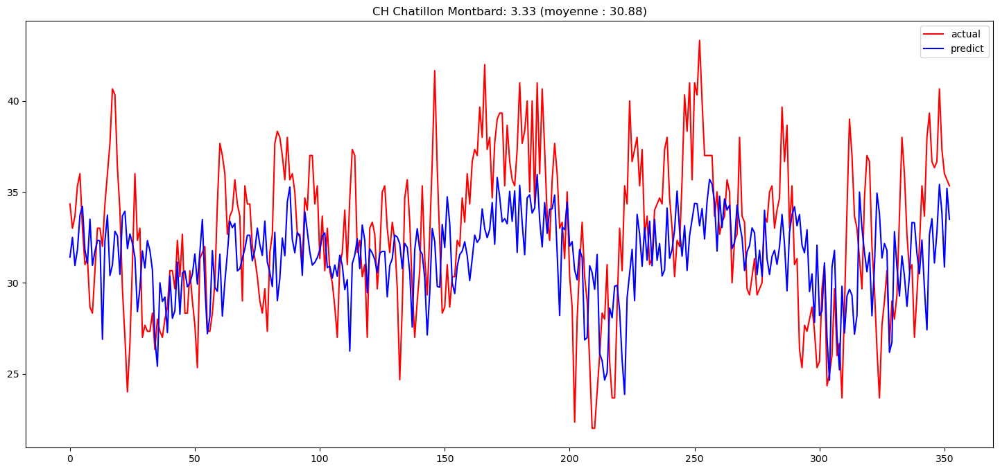

<Figure size 800x600 with 0 Axes>

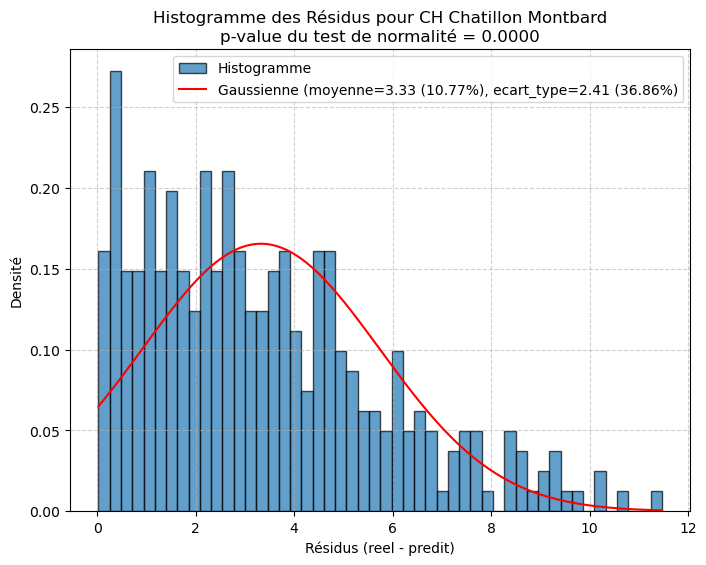

   - MAE : 8.09 (3.57 sur 2023)
   - MSE : 140.45 (22.95 sur 2023)


In [25]:
new_col = 'nb_emmergencies%%J-1'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (7): ['nb_emmergencies%%J-1', 'holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7']
Amélioration avec max_depth=4: 140.4546 -> 130.0269


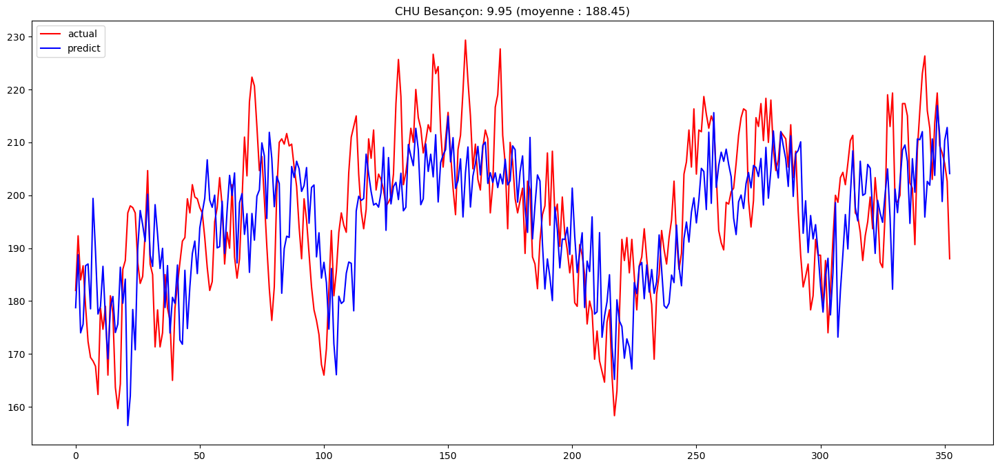

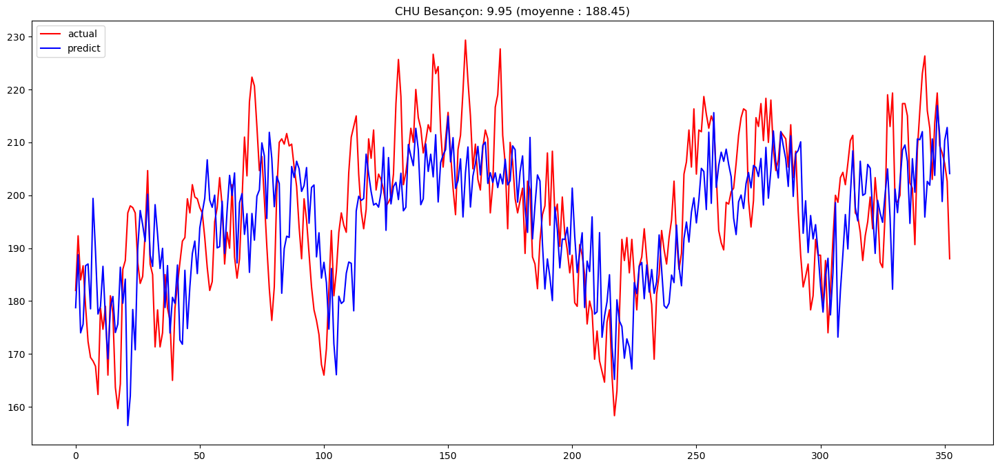

<Figure size 800x600 with 0 Axes>

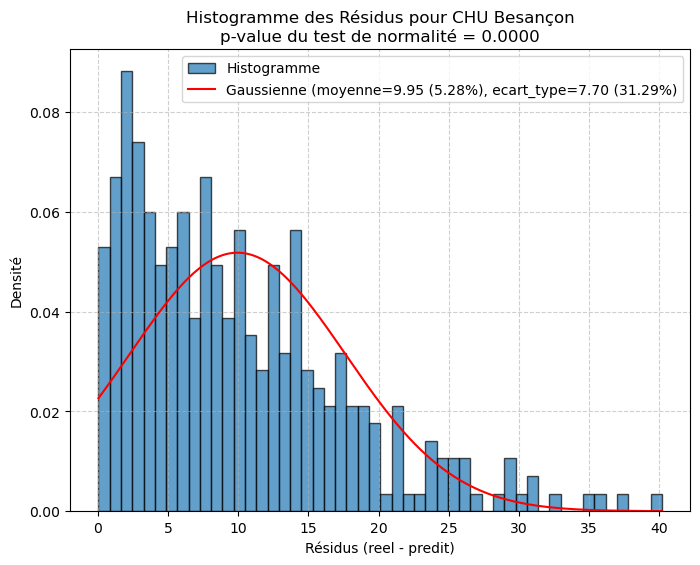

   - MAE : 7.72 (10.03 sur 2023)
   - MSE : 130.03 (161.53 sur 2023)


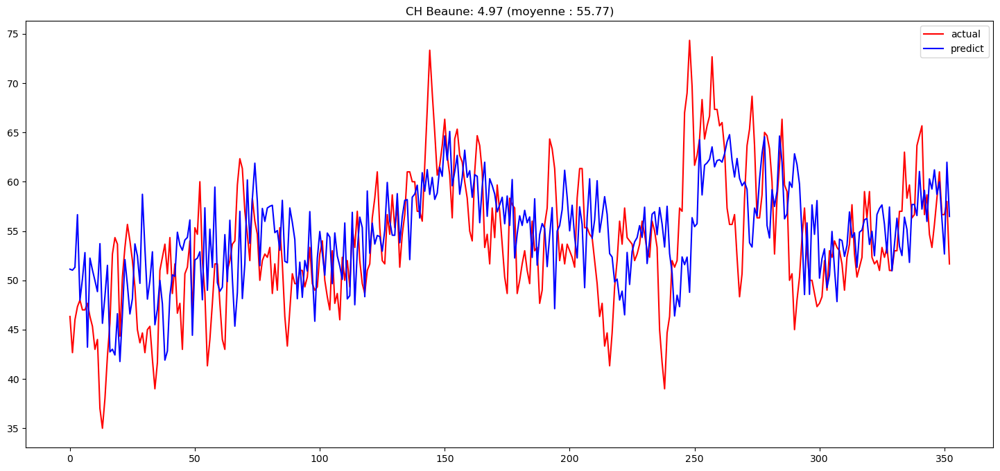

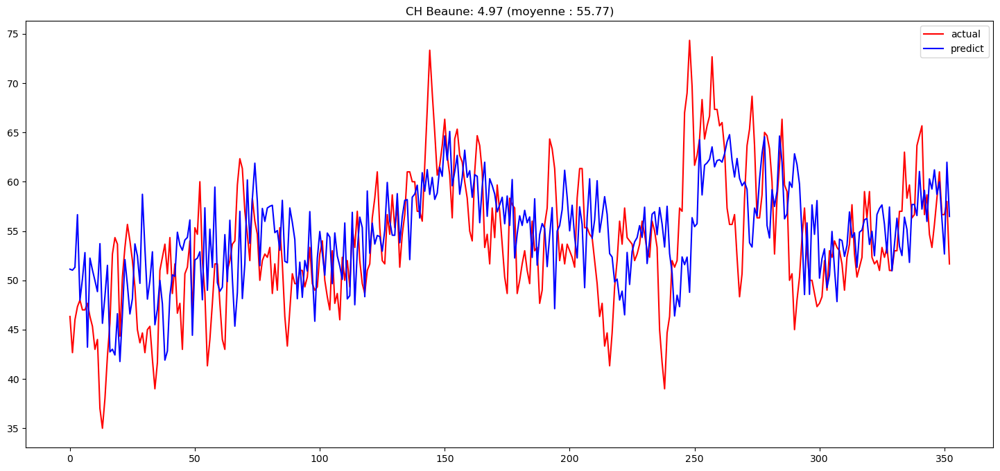

<Figure size 800x600 with 0 Axes>

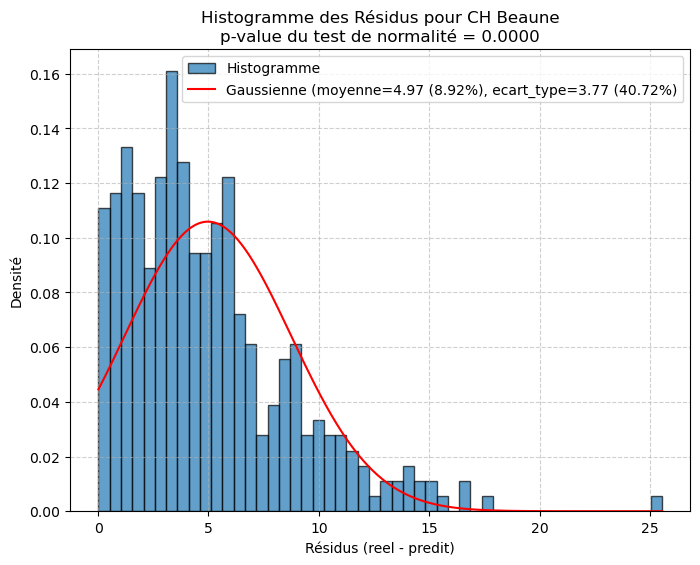

   - MAE : 7.72 (4.96 sur 2023)
   - MSE : 130.03 (38.70 sur 2023)


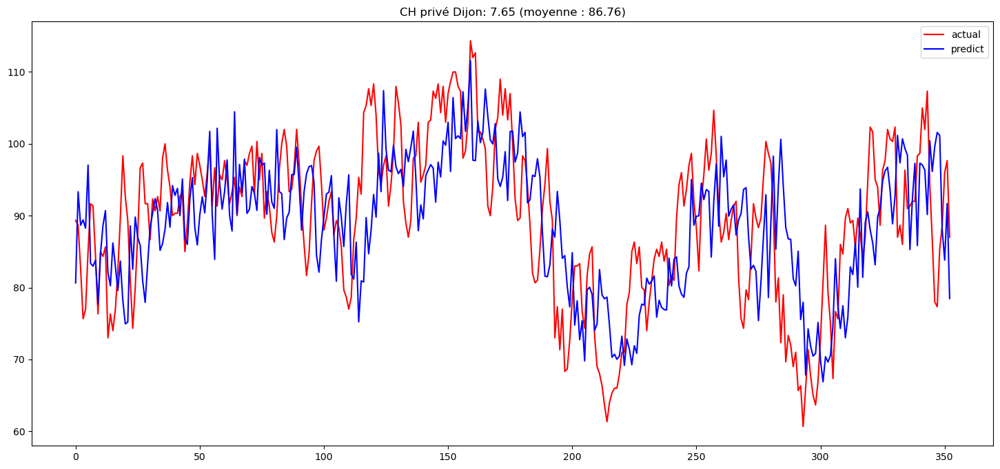

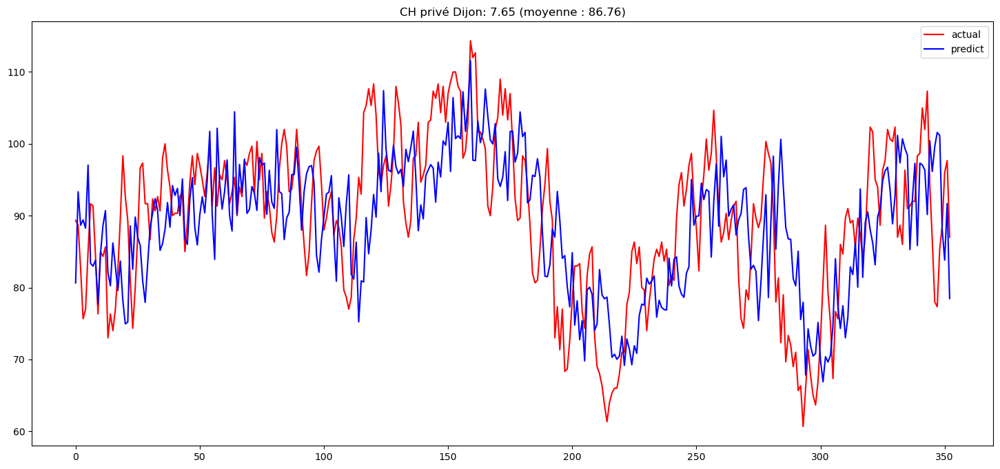

<Figure size 800x600 with 0 Axes>

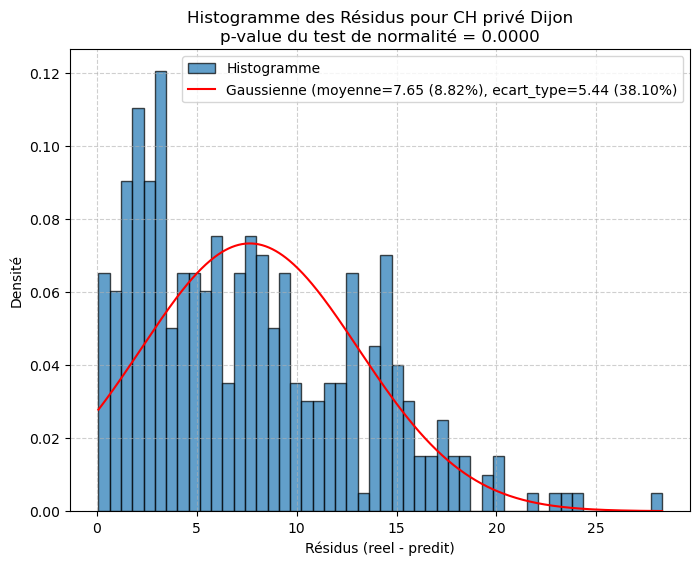

   - MAE : 7.72 (8.20 sur 2023)
   - MSE : 130.03 (120.18 sur 2023)


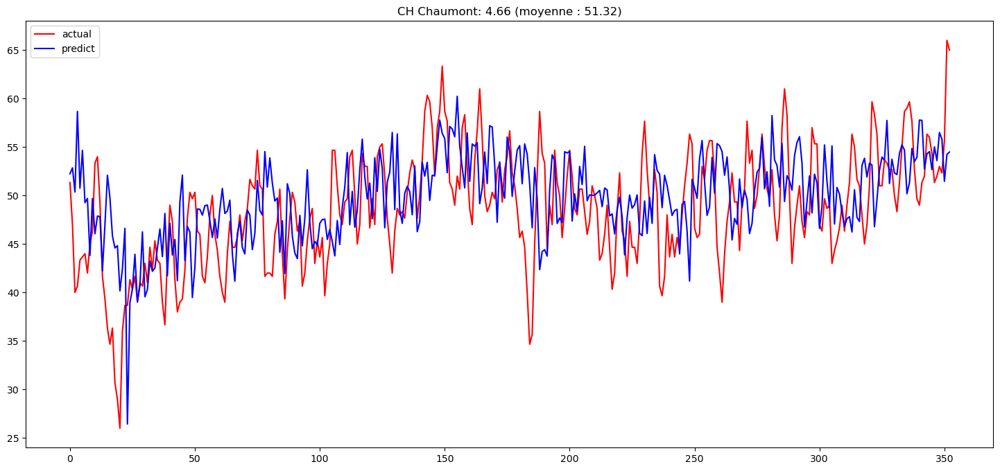

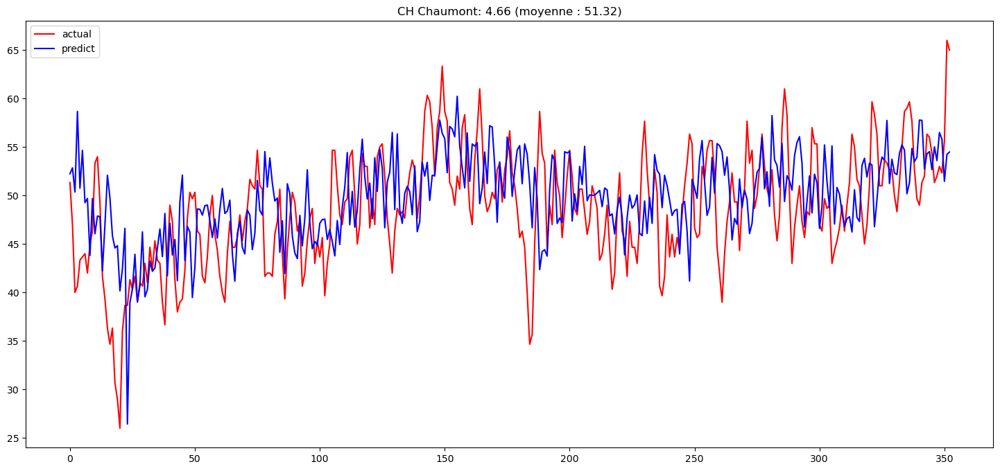

<Figure size 800x600 with 0 Axes>

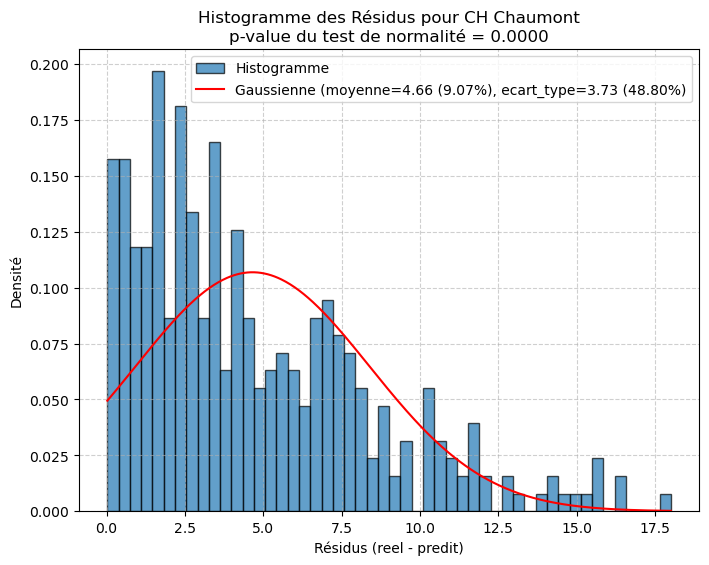

   - MAE : 7.72 (4.83 sur 2023)
   - MSE : 130.03 (40.21 sur 2023)


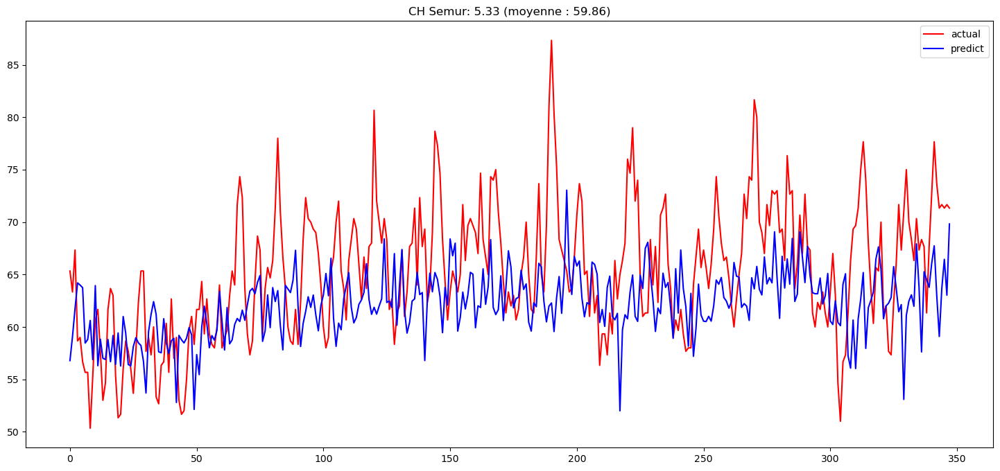

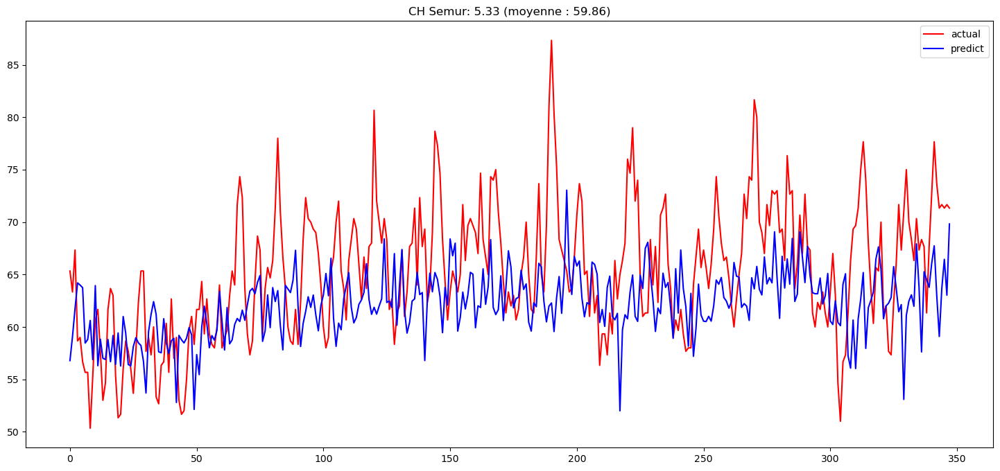

<Figure size 800x600 with 0 Axes>

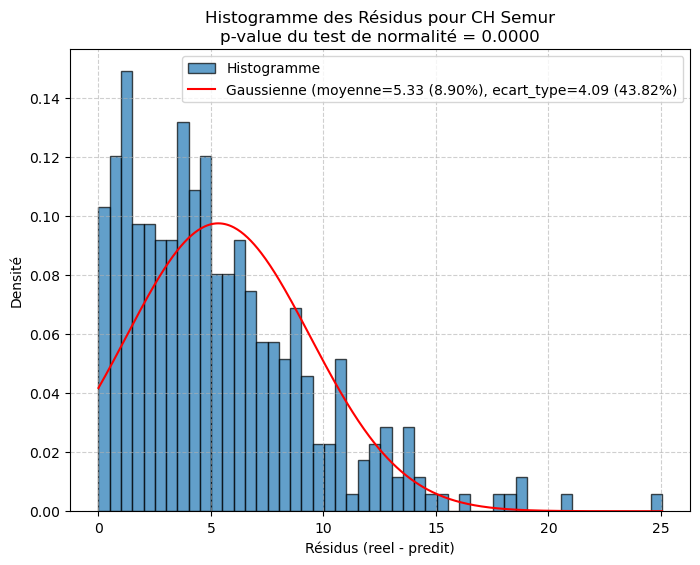

   - MAE : 7.72 (5.38 sur 2023)
   - MSE : 130.03 (46.39 sur 2023)


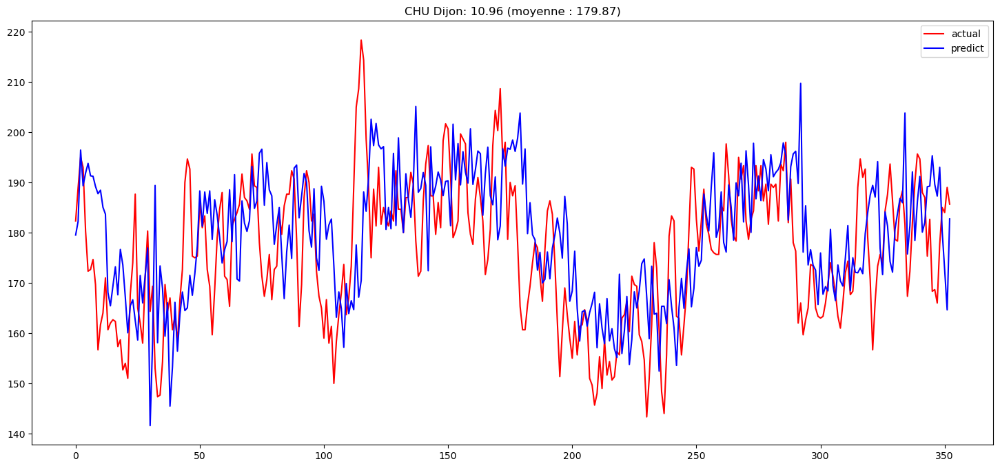

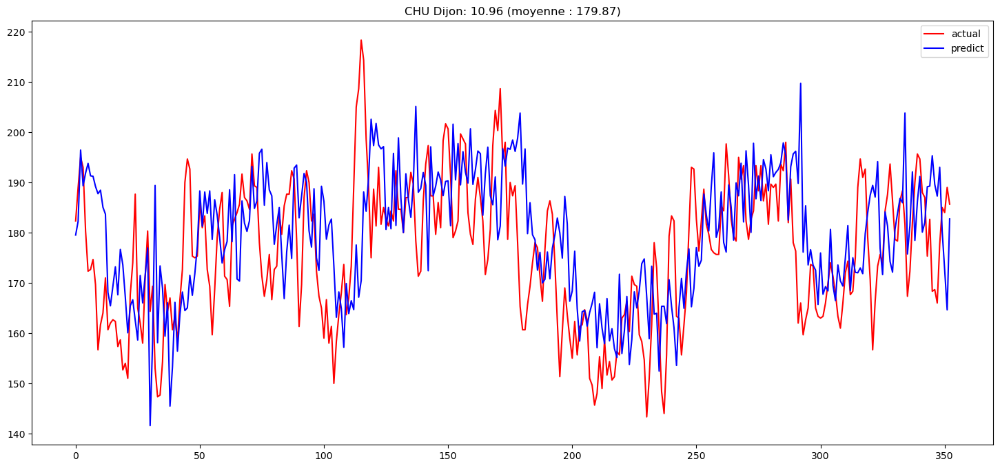

<Figure size 800x600 with 0 Axes>

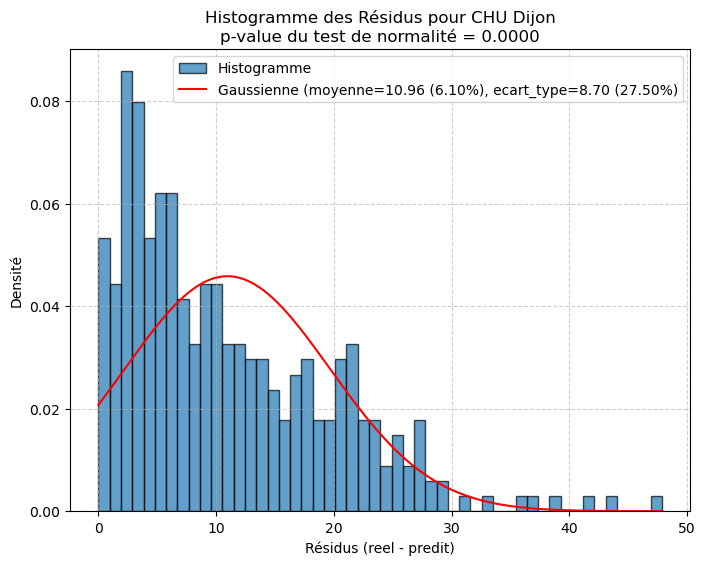

   - MAE : 7.72 (11.10 sur 2023)
   - MSE : 130.03 (199.93 sur 2023)


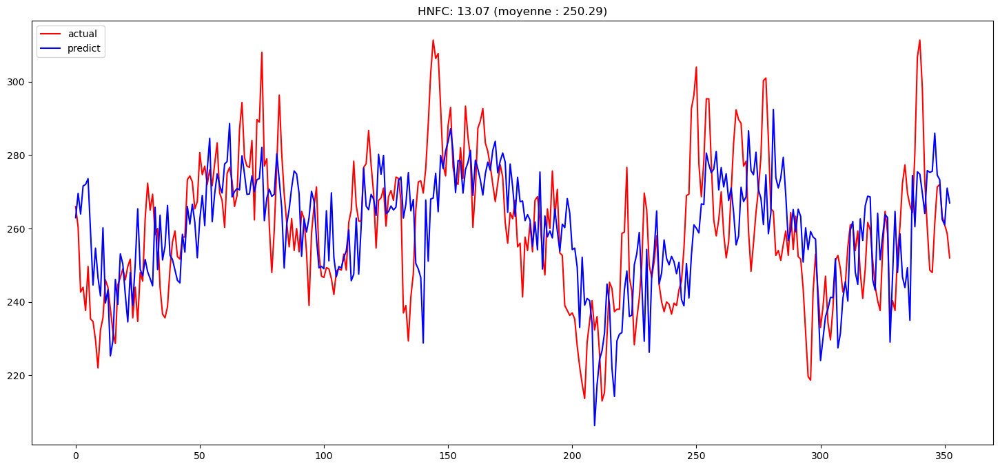

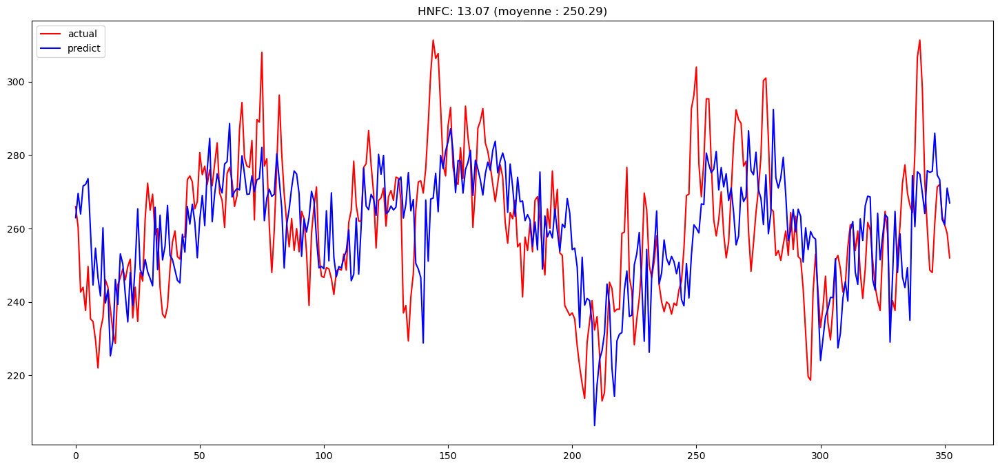

<Figure size 800x600 with 0 Axes>

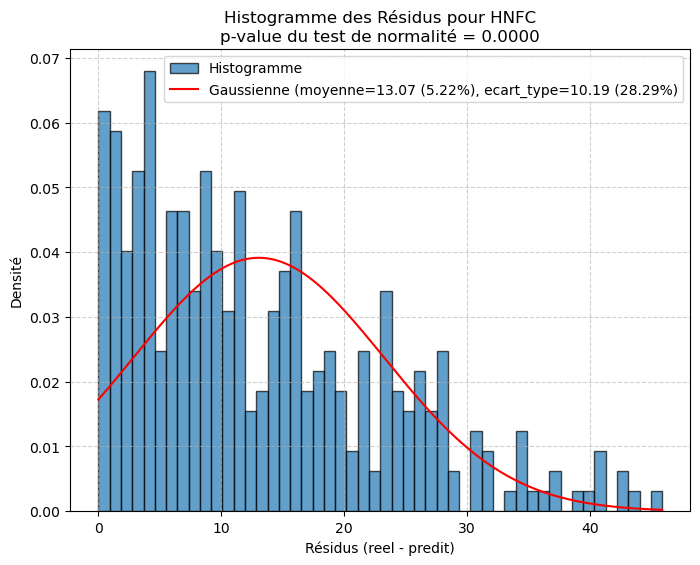

   - MAE : 7.72 (15.24 sur 2023)
   - MSE : 130.03 (696.27 sur 2023)


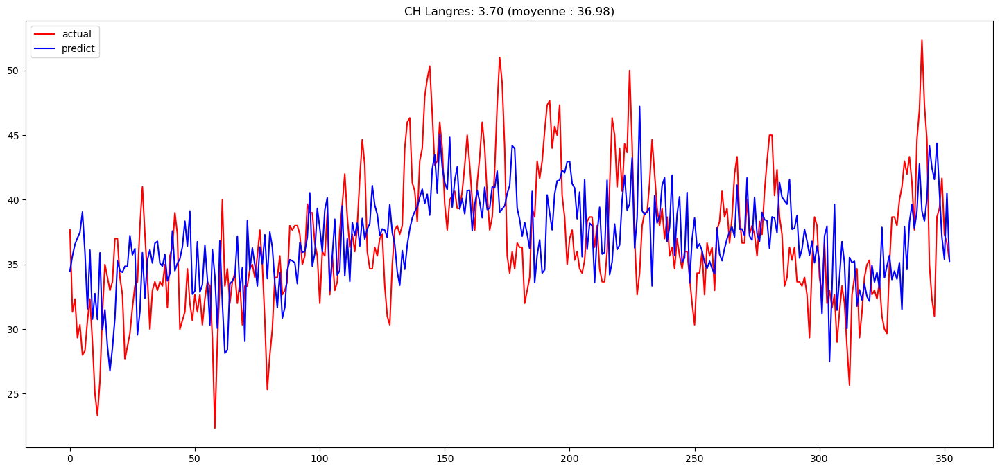

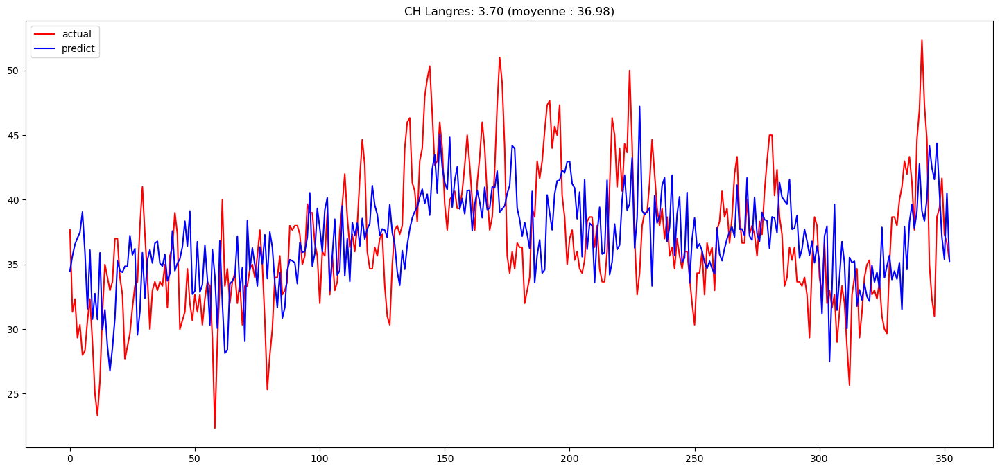

<Figure size 800x600 with 0 Axes>

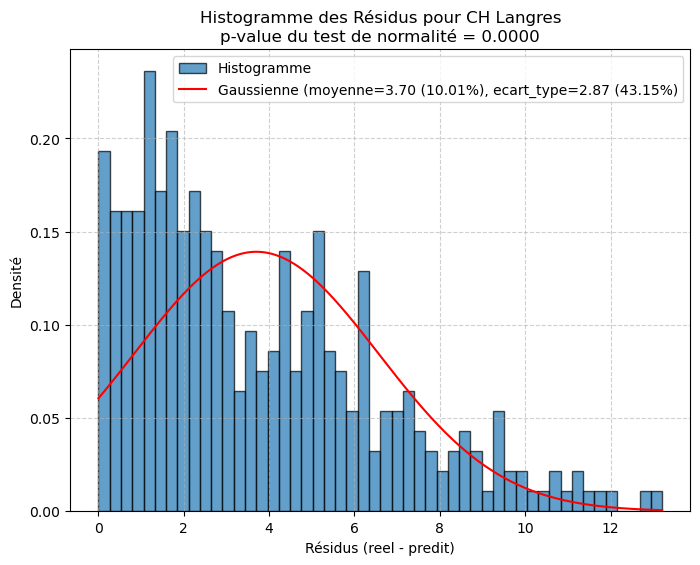

   - MAE : 7.72 (4.07 sur 2023)
   - MSE : 130.03 (35.65 sur 2023)


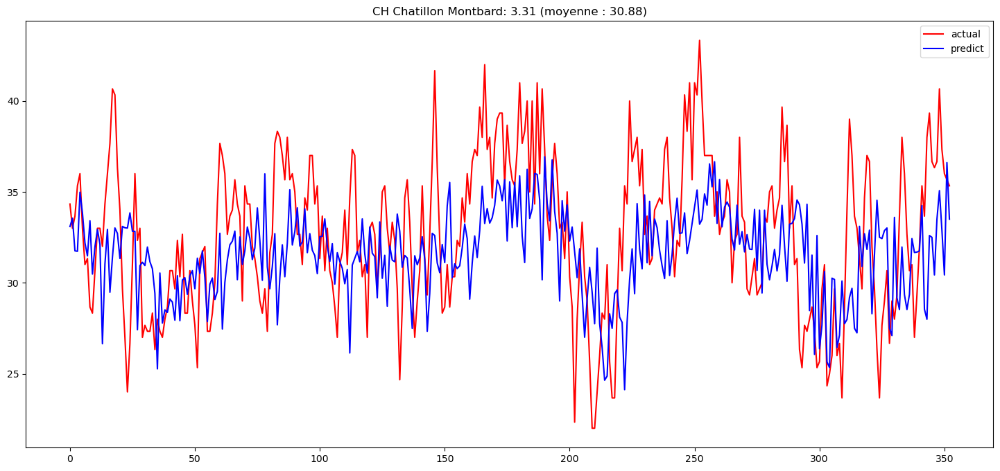

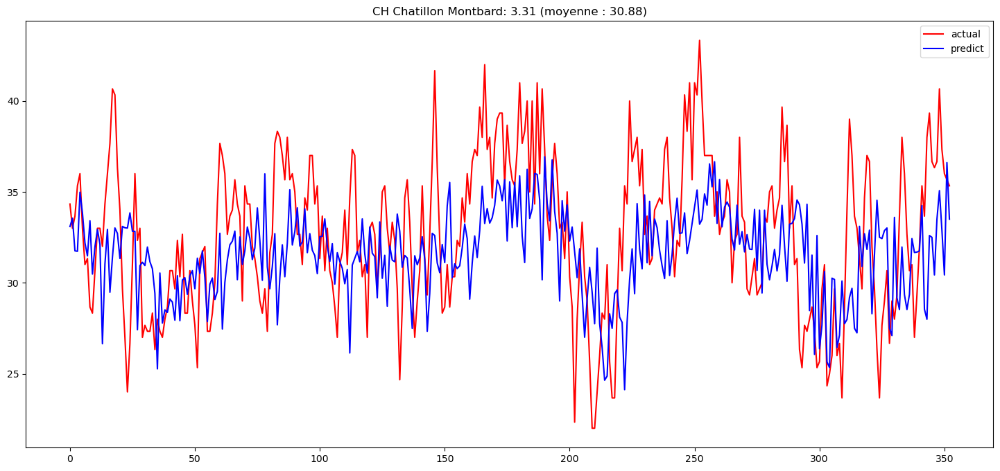

<Figure size 800x600 with 0 Axes>

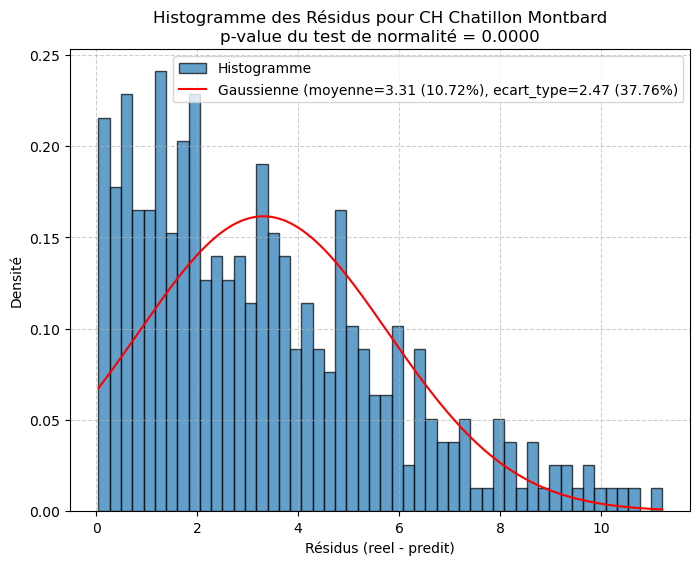

   - MAE : 7.72 (3.55 sur 2023)
   - MSE : 130.03 (22.70 sur 2023)


In [26]:
new_col = 'nb_emmergencies%%J-3'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (8): ['nb_emmergencies%%J-1', 'holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7', 'nb_emmergencies%%J-3']
Amélioration avec max_depth=4: 130.0269 -> 125.5255


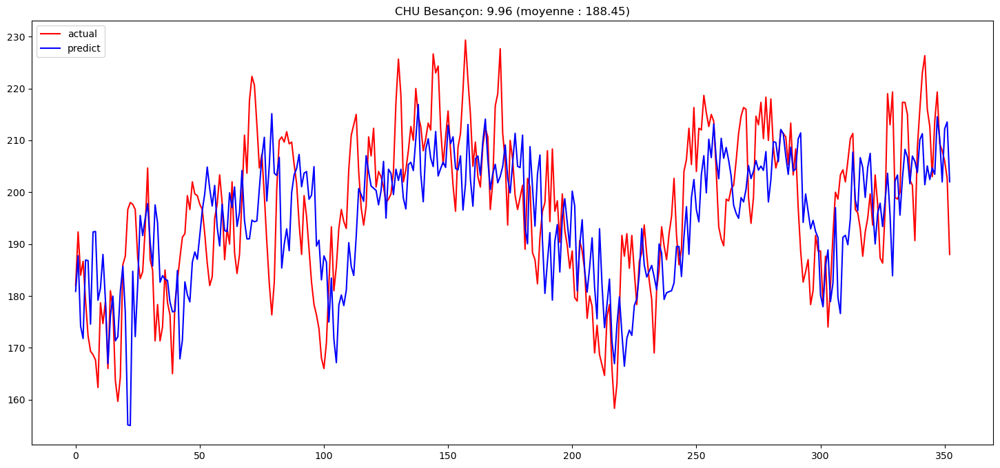

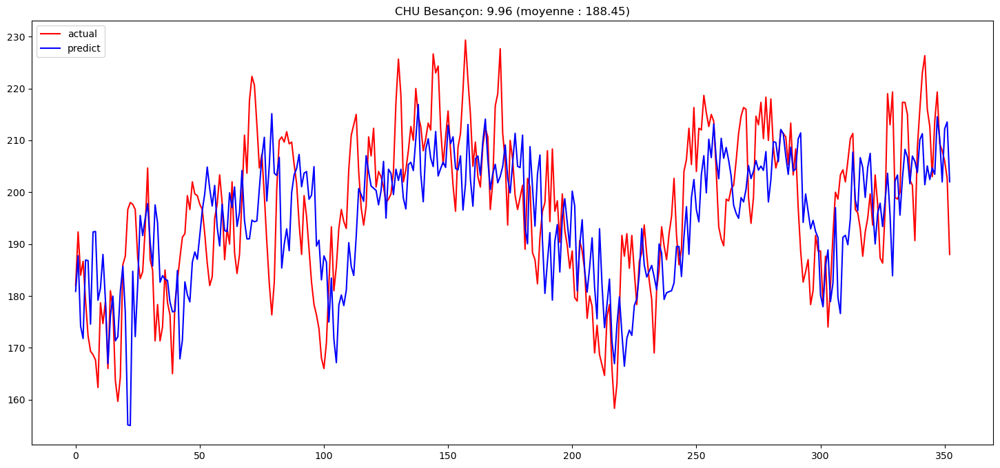

<Figure size 800x600 with 0 Axes>

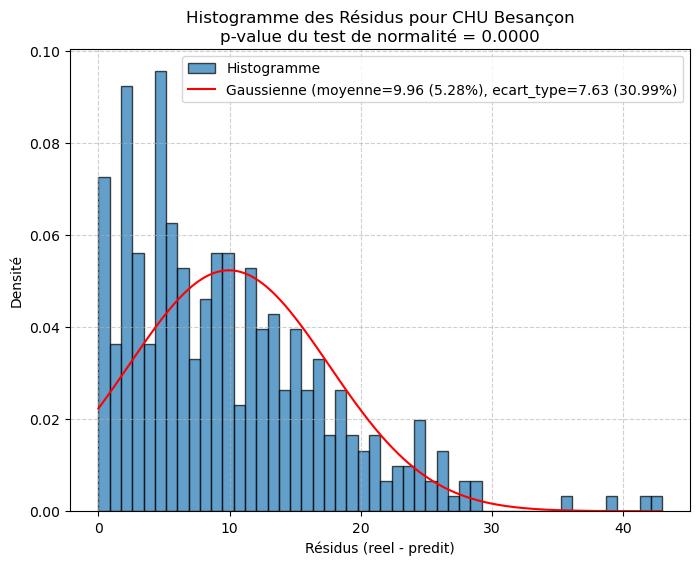

   - MAE : 7.55 (10.03 sur 2023)
   - MSE : 125.53 (160.05 sur 2023)


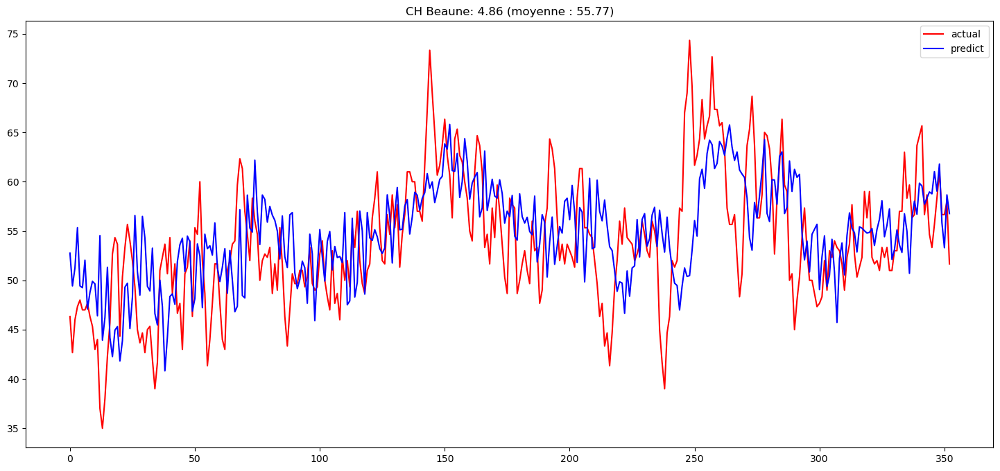

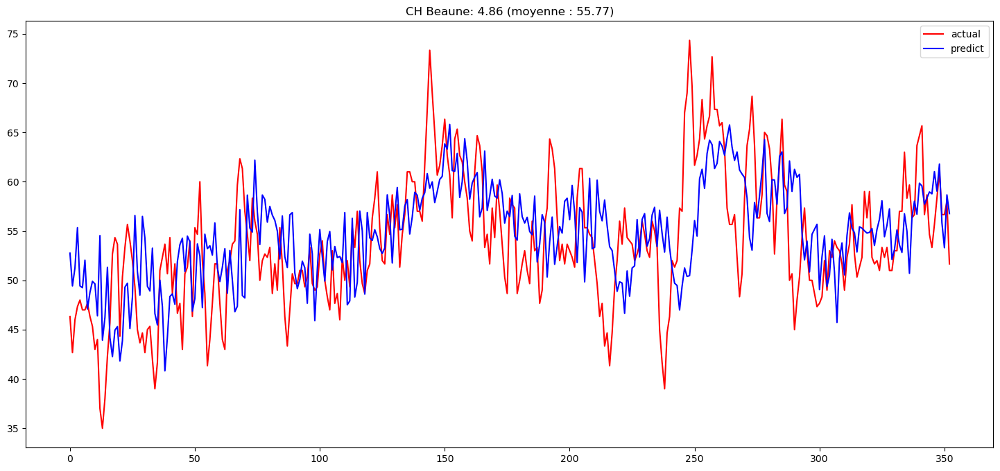

<Figure size 800x600 with 0 Axes>

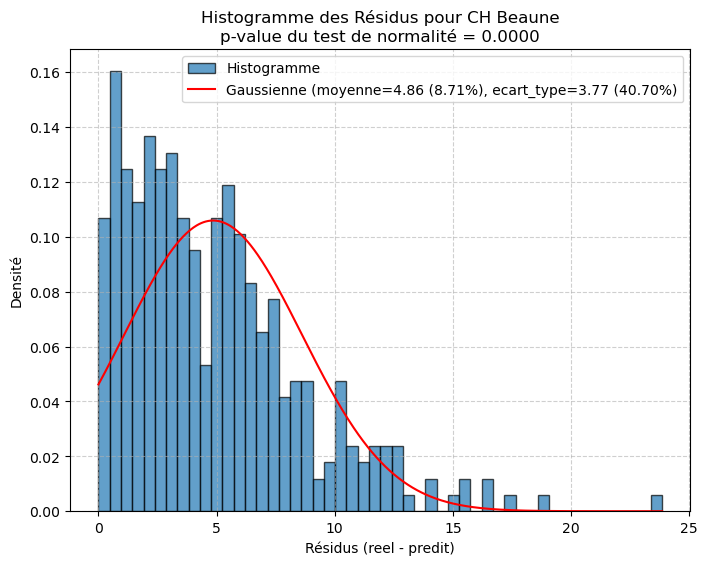

   - MAE : 7.55 (4.83 sur 2023)
   - MSE : 125.53 (37.52 sur 2023)


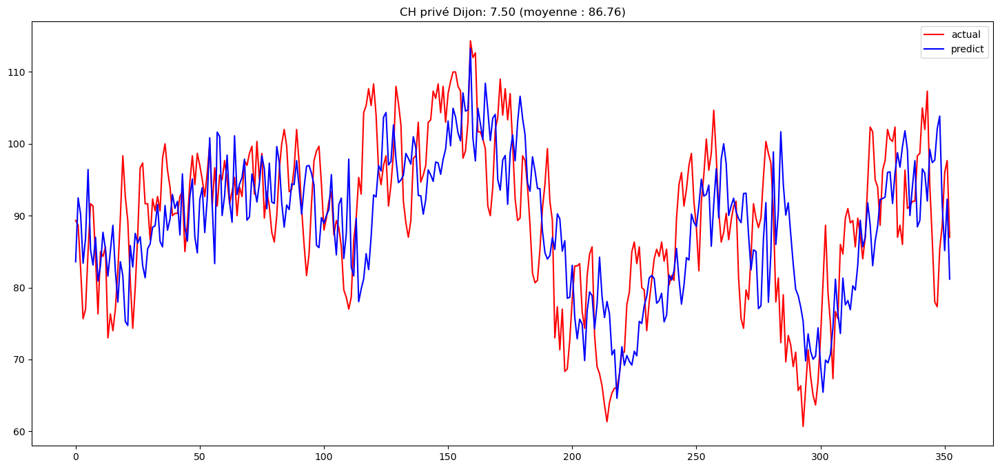

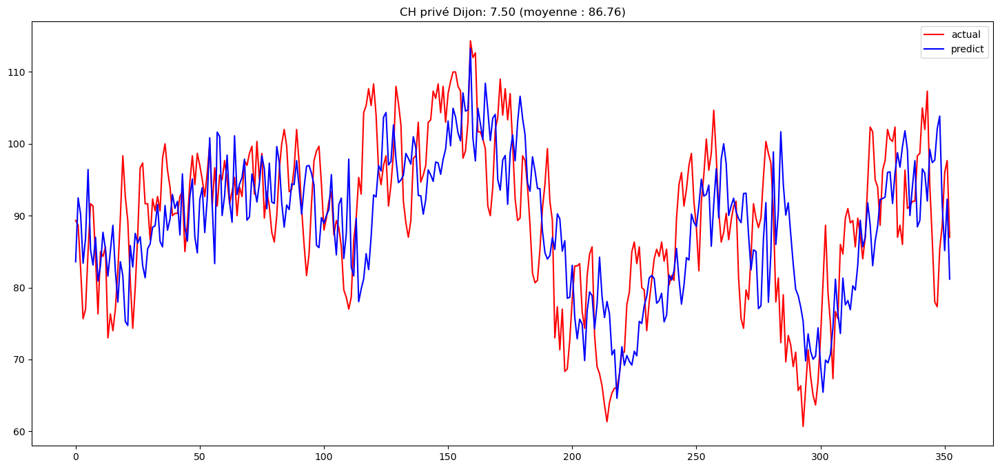

<Figure size 800x600 with 0 Axes>

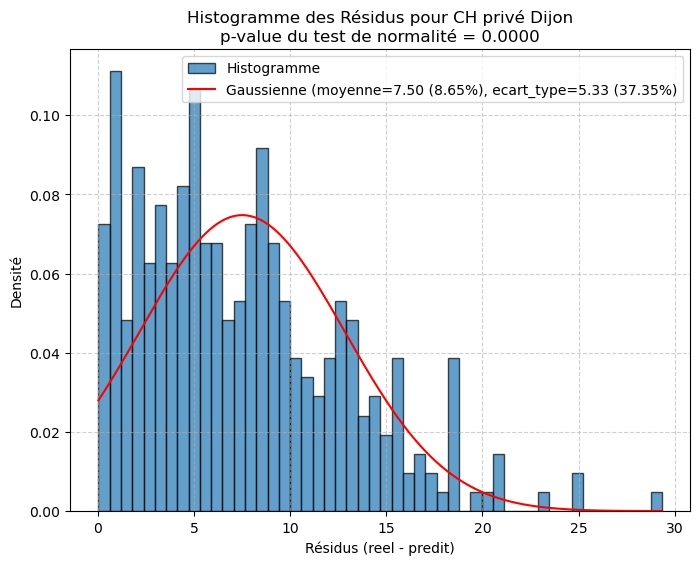

   - MAE : 7.55 (8.03 sur 2023)
   - MSE : 125.53 (115.32 sur 2023)


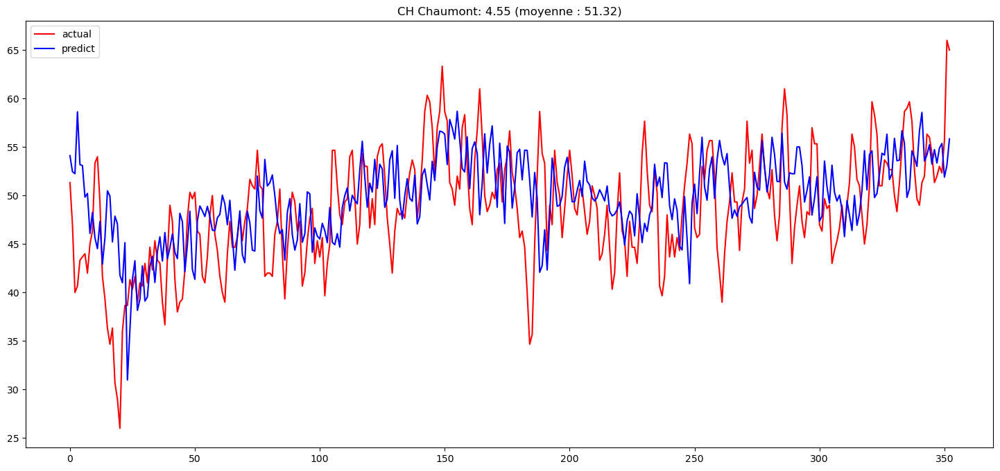

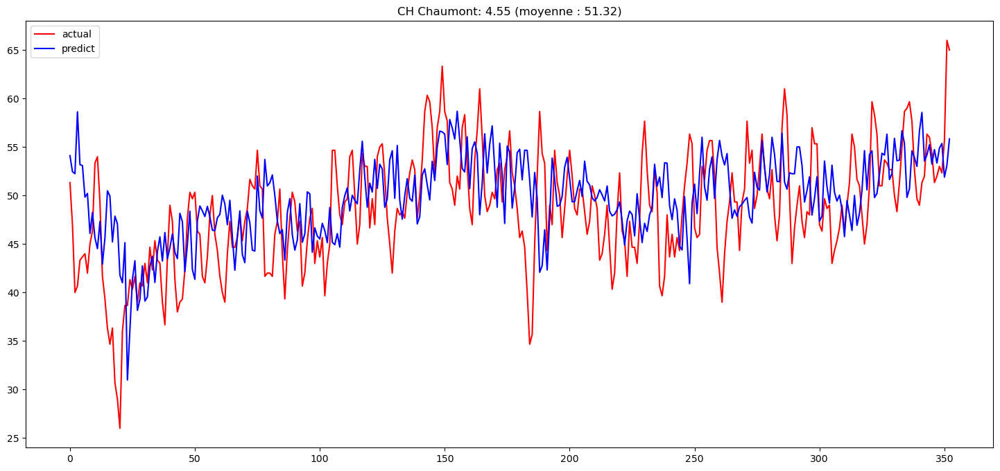

<Figure size 800x600 with 0 Axes>

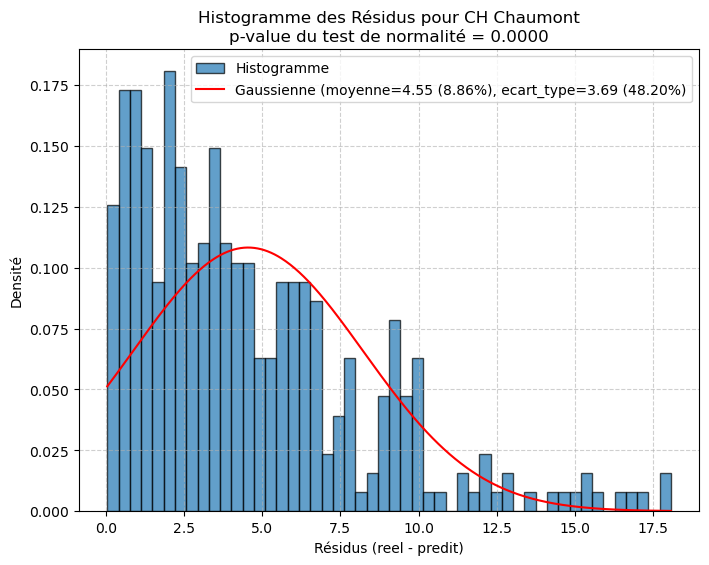

   - MAE : 7.55 (4.71 sur 2023)
   - MSE : 125.53 (38.55 sur 2023)


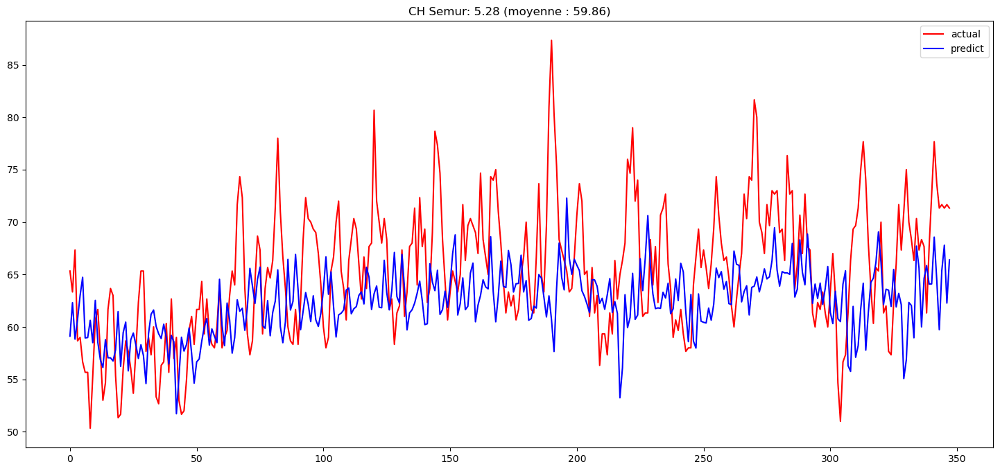

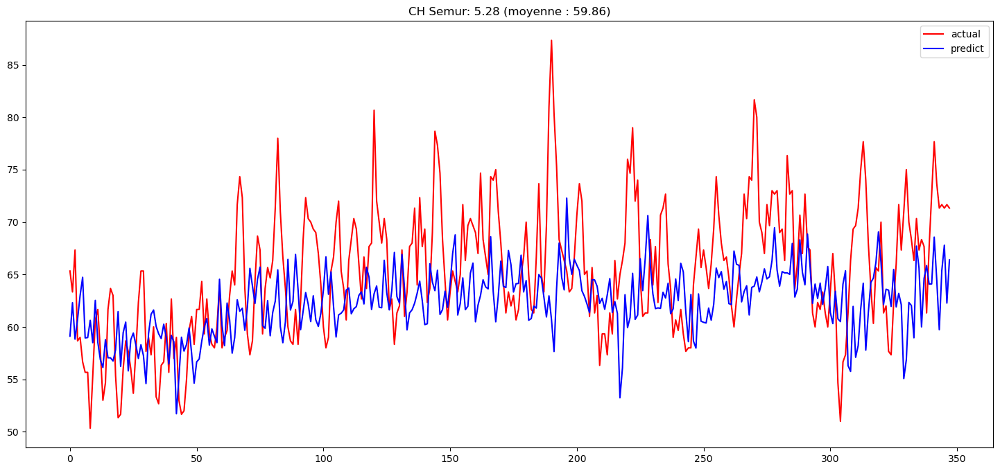

<Figure size 800x600 with 0 Axes>

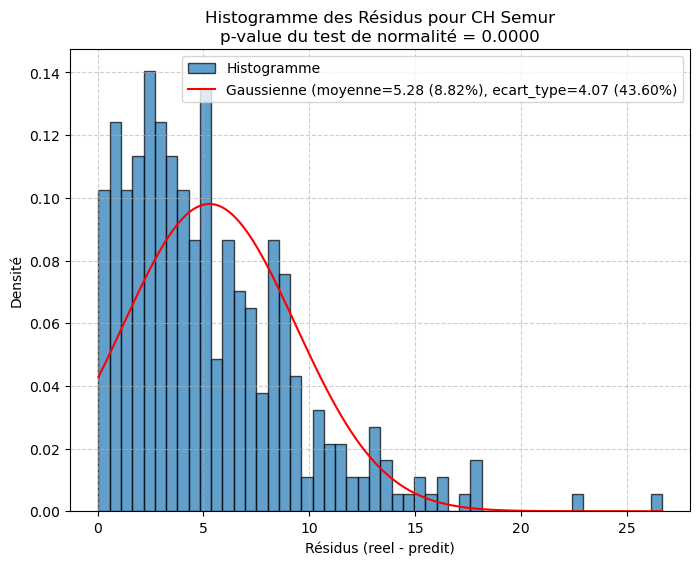

   - MAE : 7.55 (5.33 sur 2023)
   - MSE : 125.53 (45.49 sur 2023)


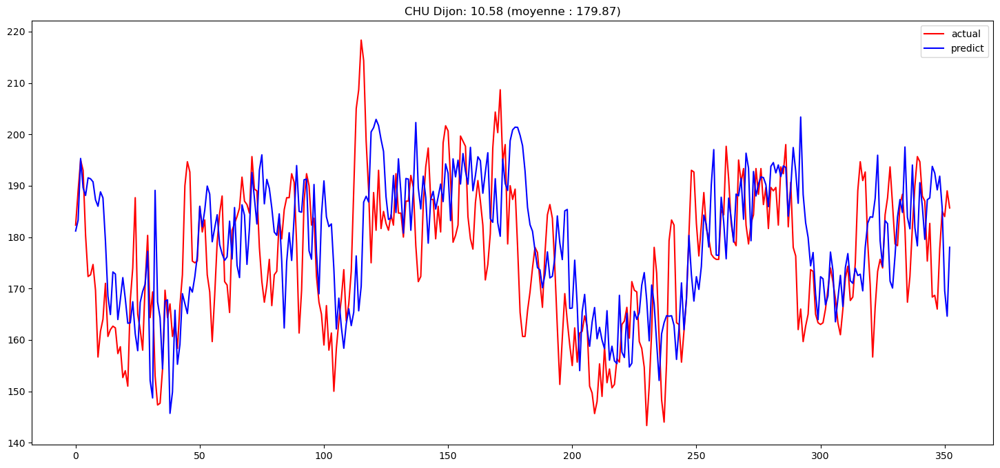

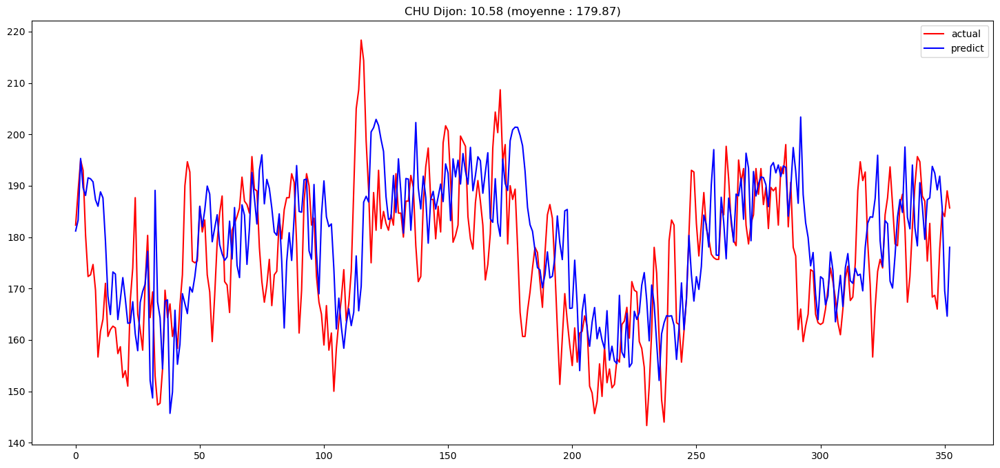

<Figure size 800x600 with 0 Axes>

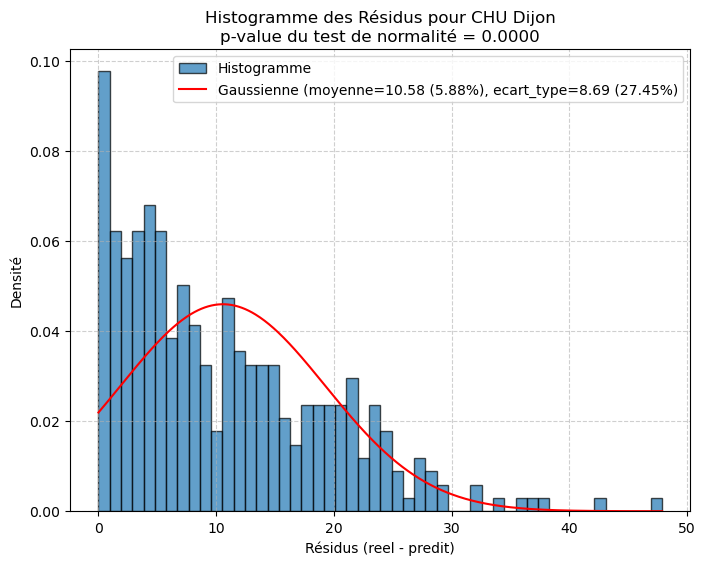

   - MAE : 7.55 (10.75 sur 2023)
   - MSE : 125.53 (193.69 sur 2023)


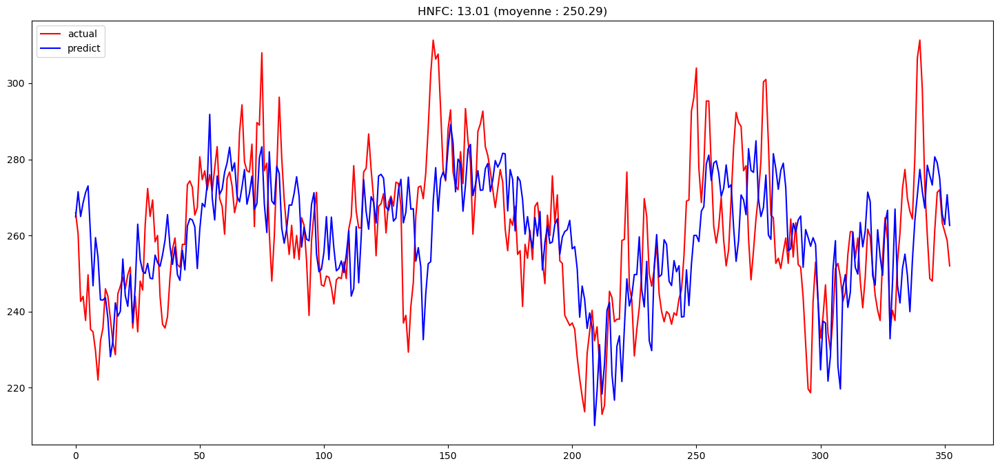

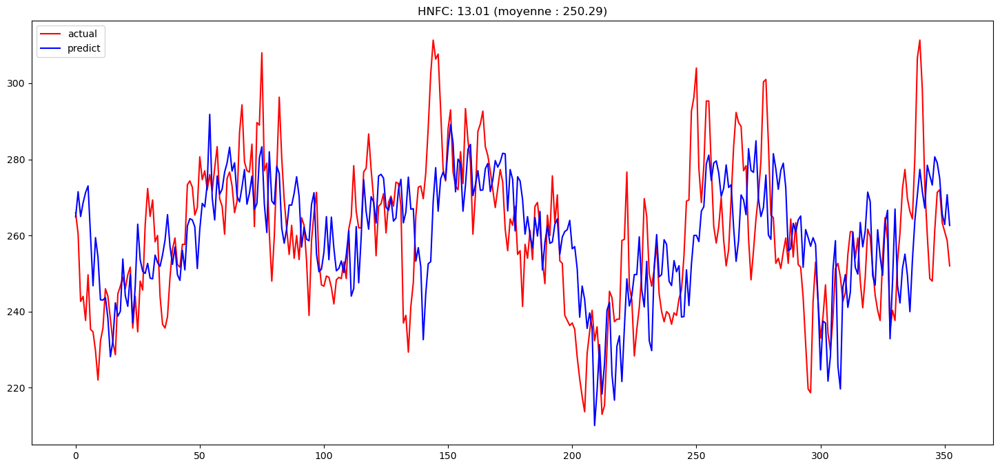

<Figure size 800x600 with 0 Axes>

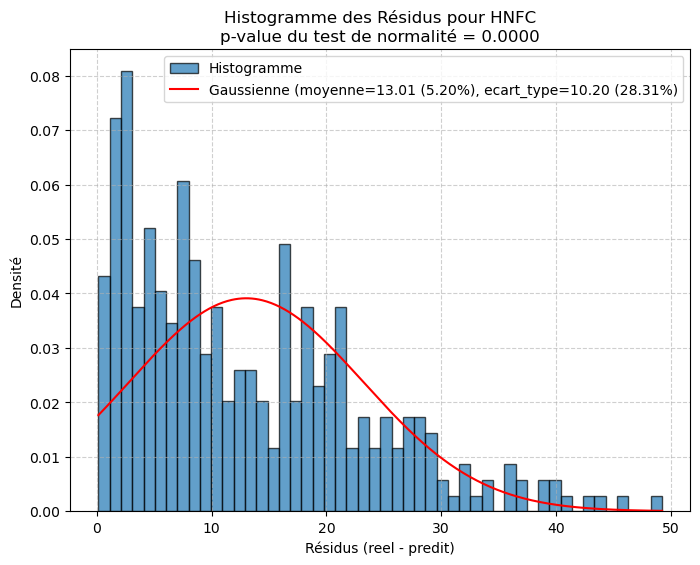

   - MAE : 7.55 (15.18 sur 2023)
   - MSE : 125.53 (695.09 sur 2023)


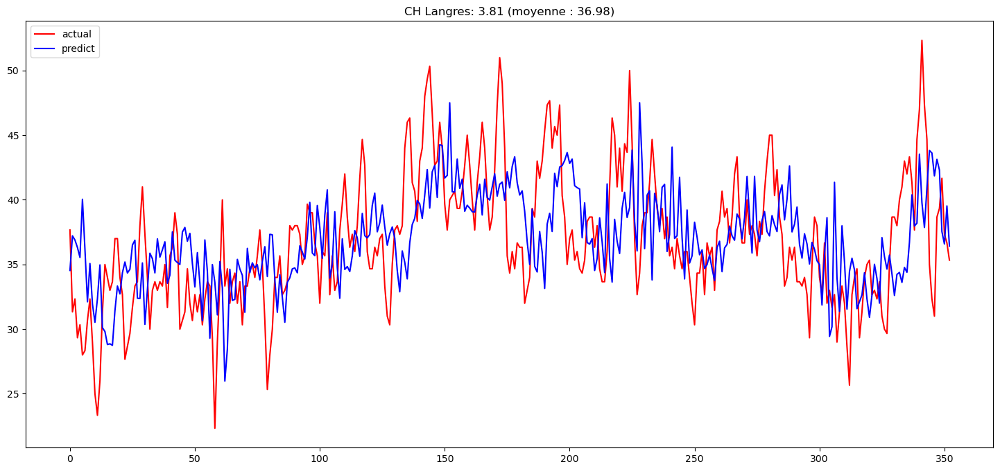

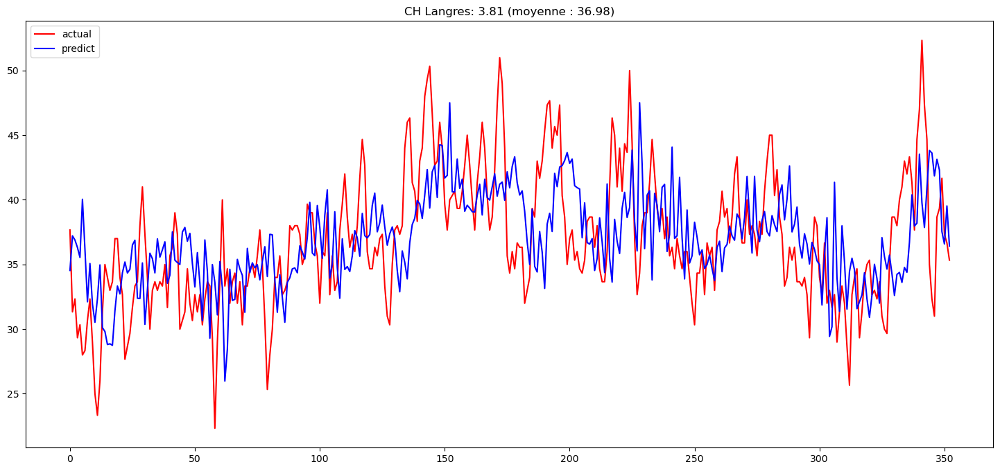

<Figure size 800x600 with 0 Axes>

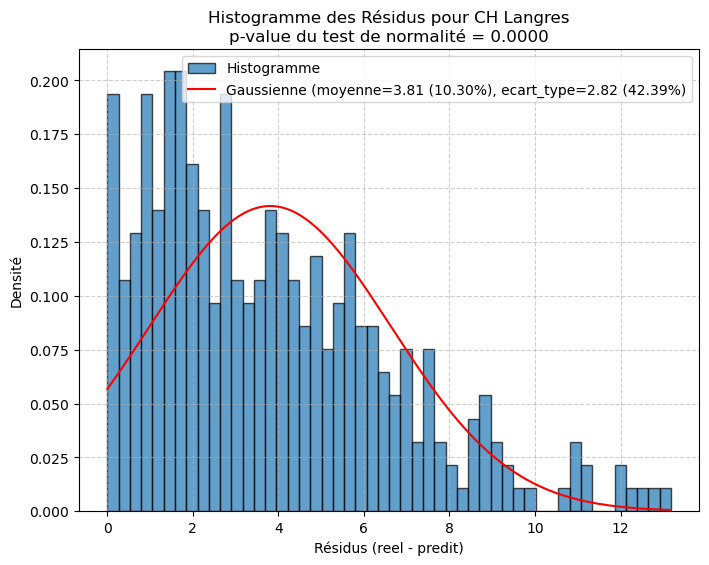

   - MAE : 7.55 (4.18 sur 2023)
   - MSE : 125.53 (35.90 sur 2023)


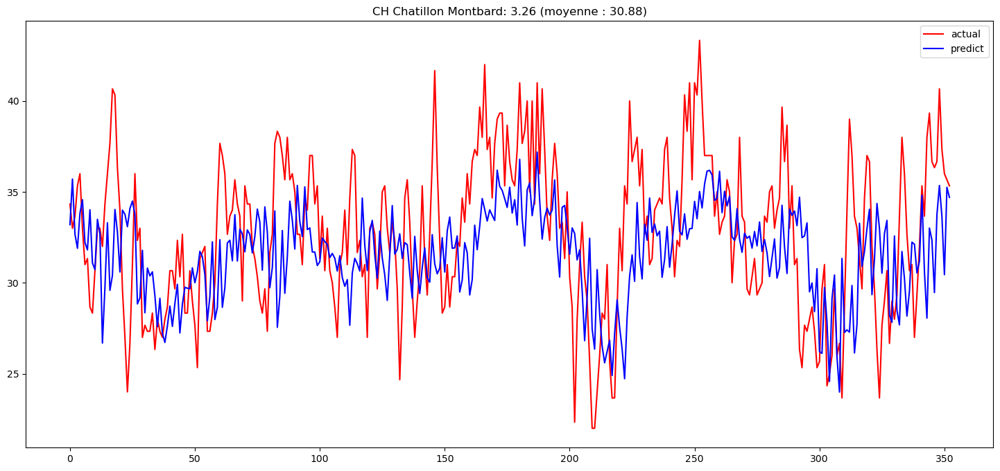

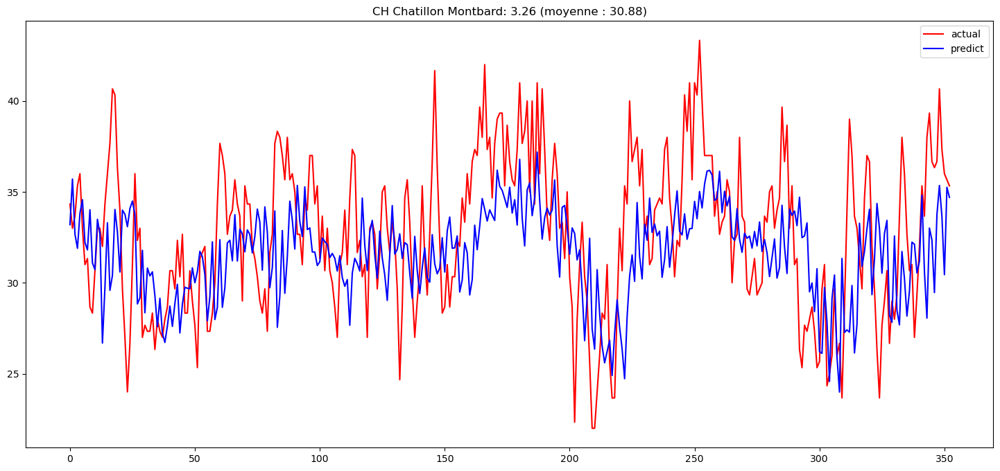

<Figure size 800x600 with 0 Axes>

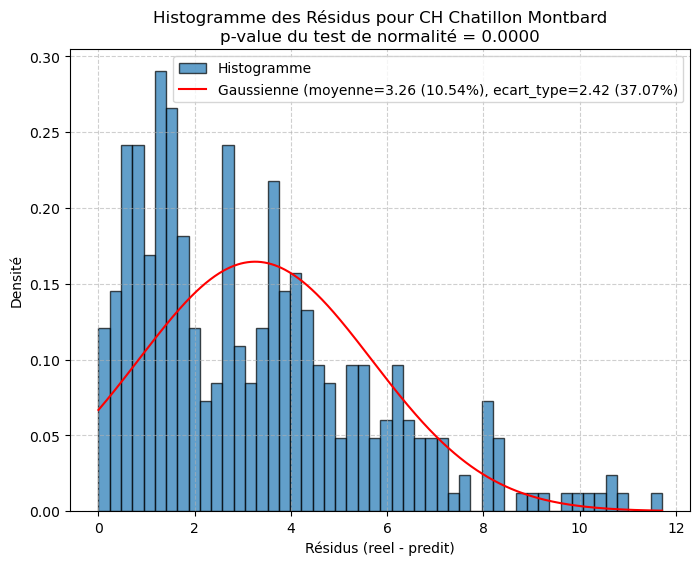

   - MAE : 7.55 (3.49 sur 2023)
   - MSE : 125.53 (22.12 sur 2023)


In [27]:
new_col = 'nb_emmergencies%%J-4'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (9): ['nb_emmergencies%%J-1', 'nb_emmergencies%%J-4', 'holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7', 'nb_emmergencies%%J-3']
Amélioration avec max_depth=4: 125.5255 -> 121.0457


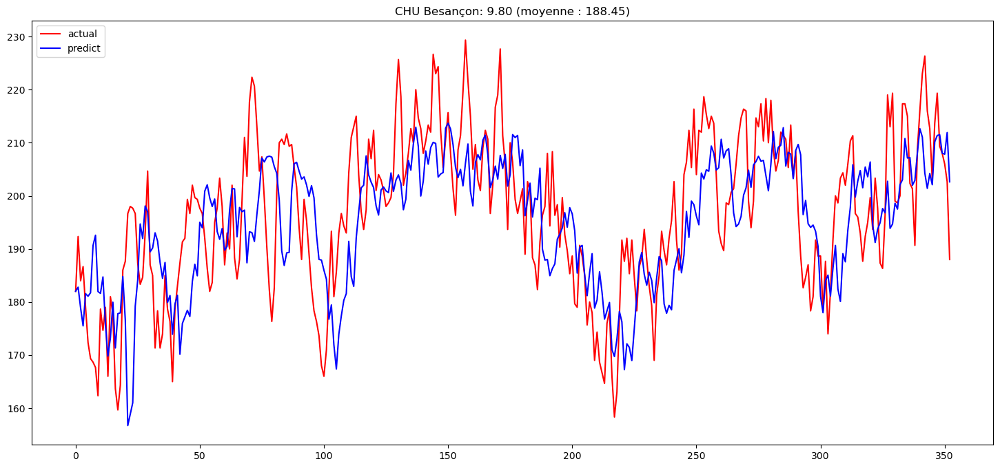

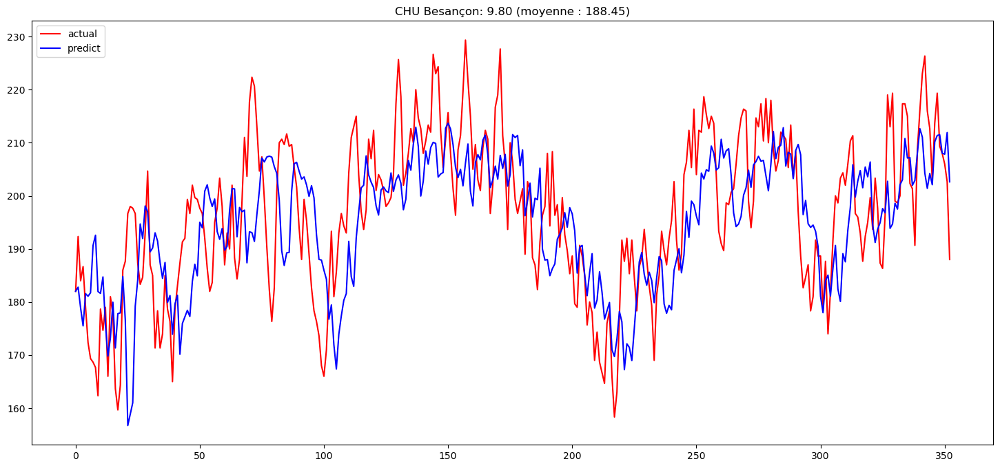

<Figure size 800x600 with 0 Axes>

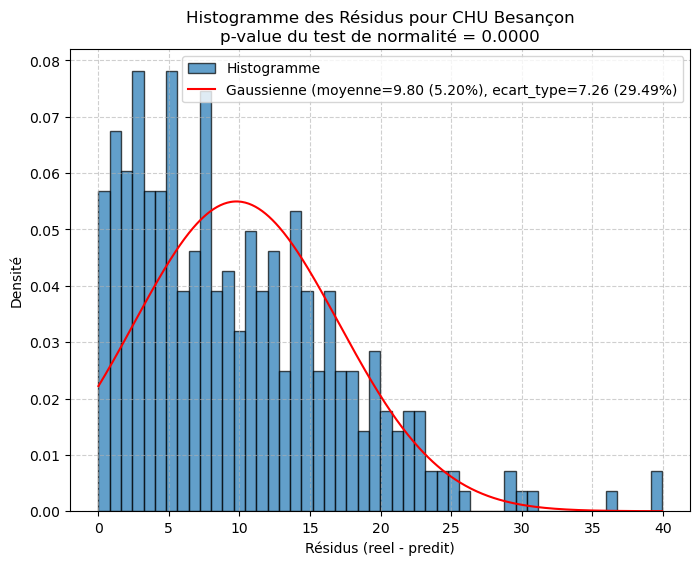

   - MAE : 7.42 (9.88 sur 2023)
   - MSE : 121.05 (152.44 sur 2023)


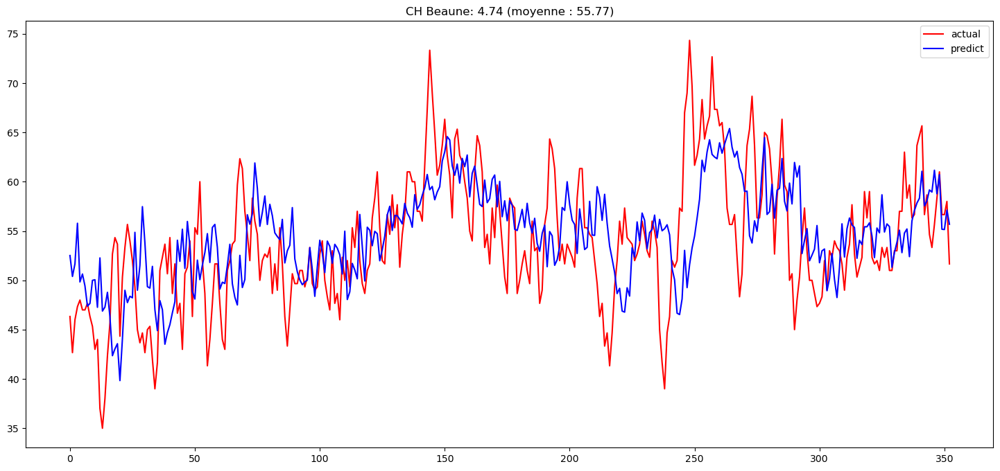

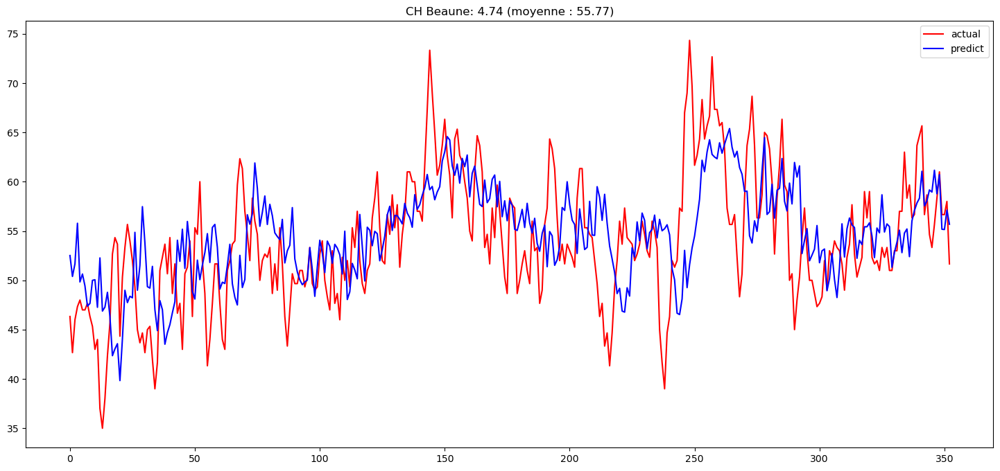

<Figure size 800x600 with 0 Axes>

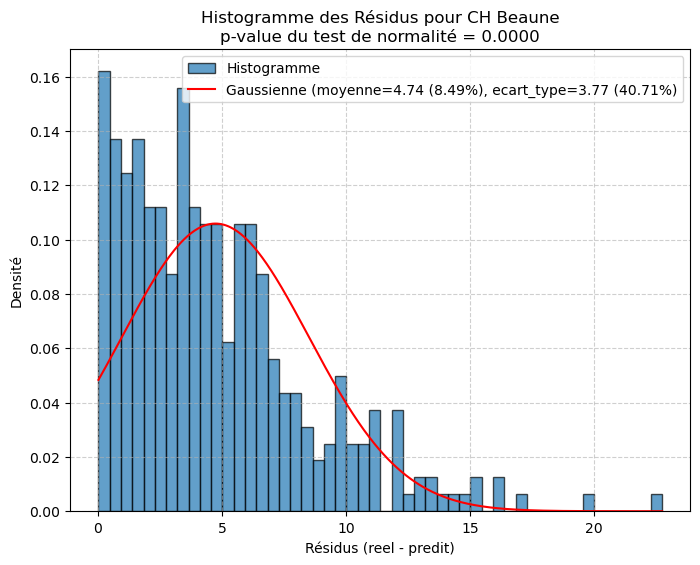

   - MAE : 7.42 (4.72 sur 2023)
   - MSE : 121.05 (36.45 sur 2023)


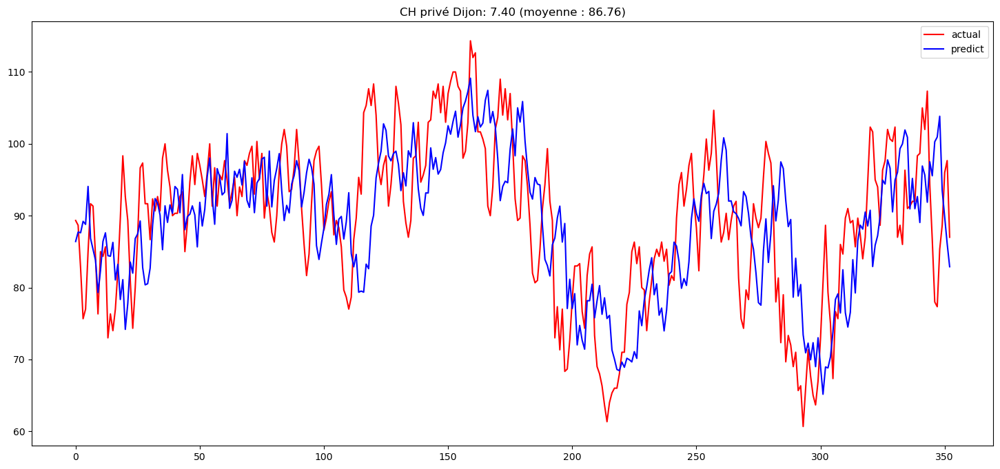

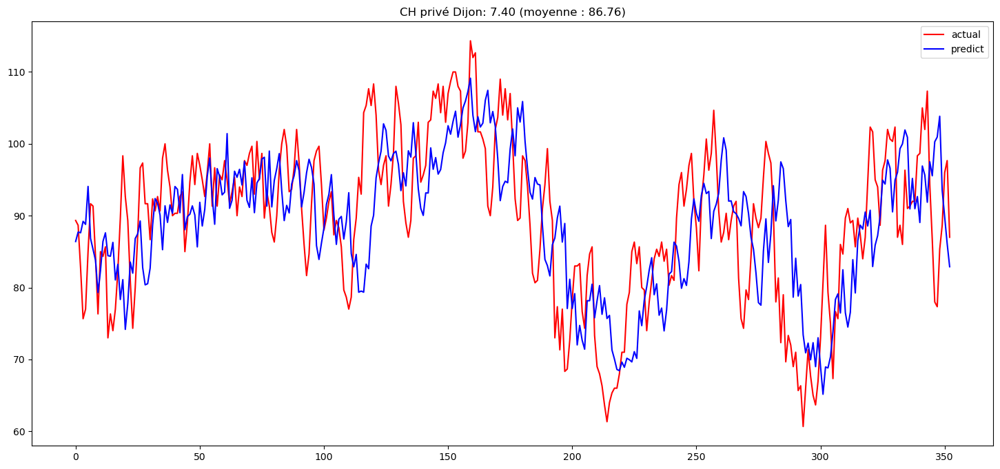

<Figure size 800x600 with 0 Axes>

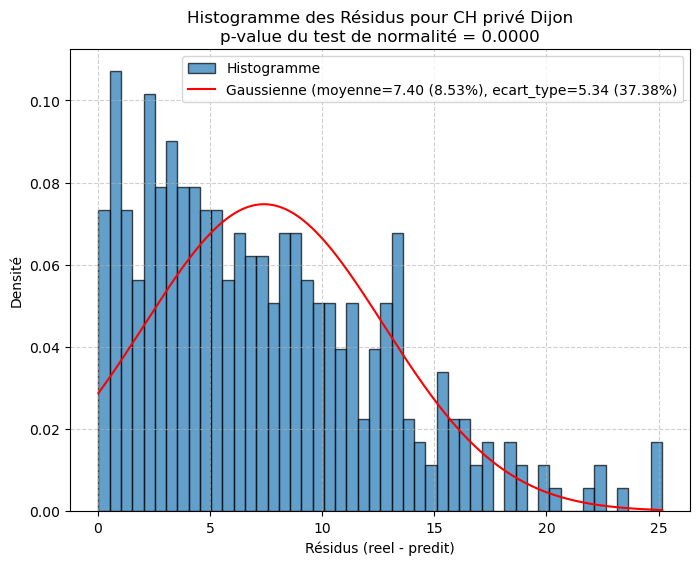

   - MAE : 7.42 (7.94 sur 2023)
   - MSE : 121.05 (114.58 sur 2023)


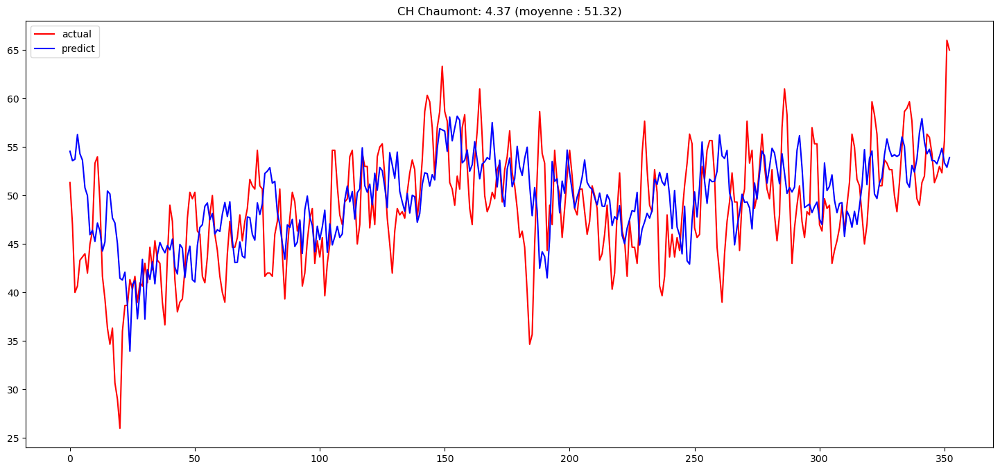

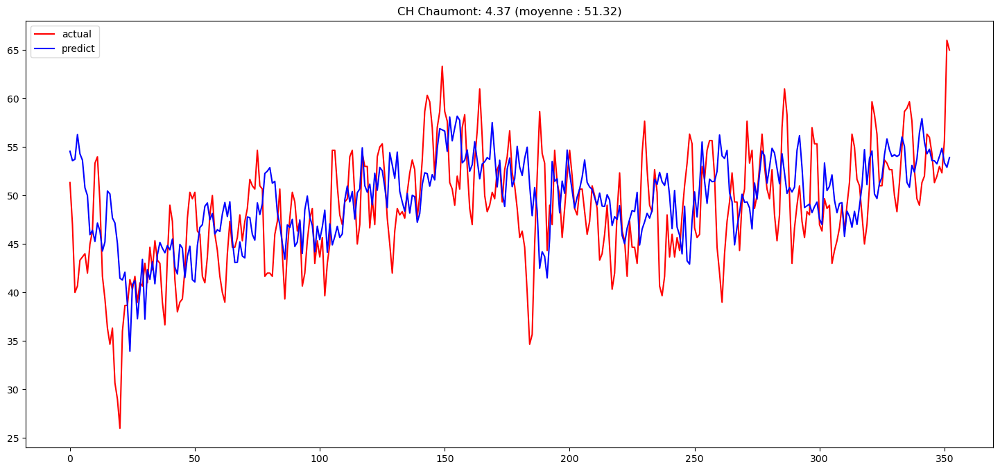

<Figure size 800x600 with 0 Axes>

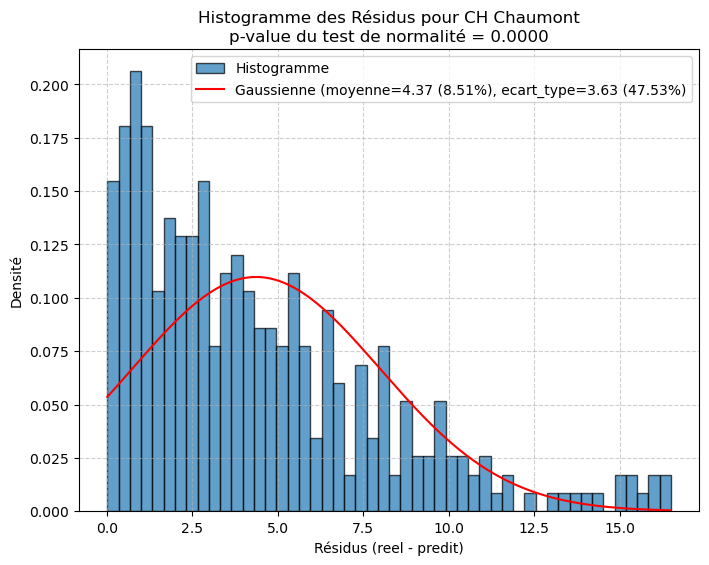

   - MAE : 7.42 (4.53 sur 2023)
   - MSE : 121.05 (36.54 sur 2023)


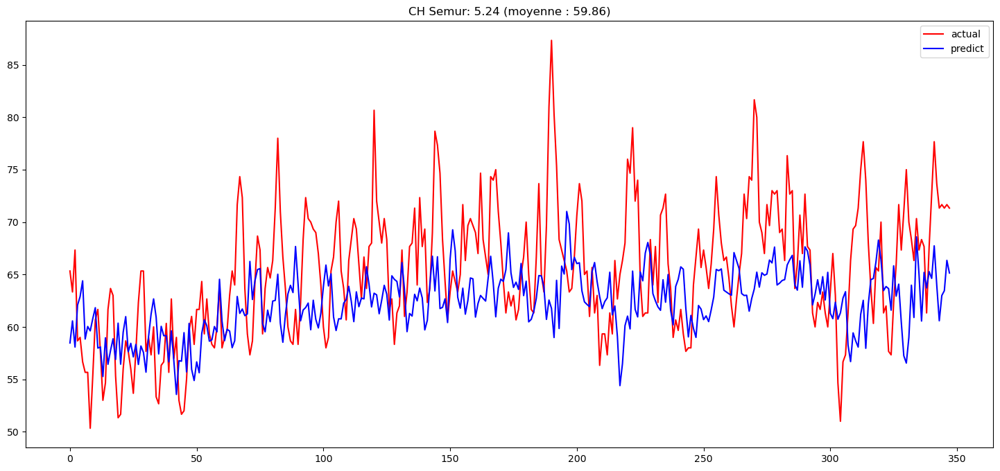

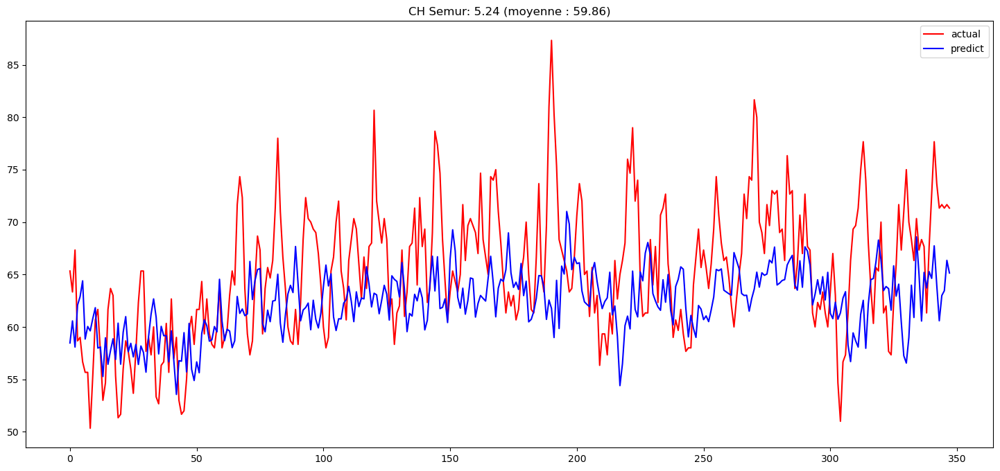

<Figure size 800x600 with 0 Axes>

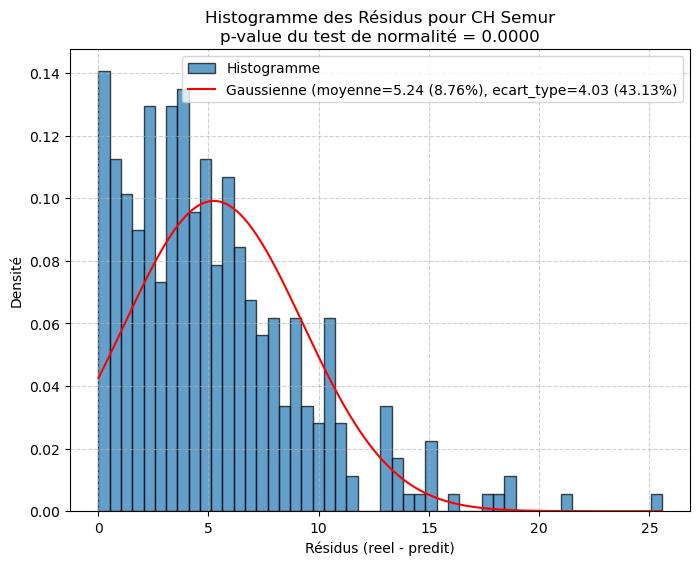

   - MAE : 7.42 (5.28 sur 2023)
   - MSE : 121.05 (44.73 sur 2023)


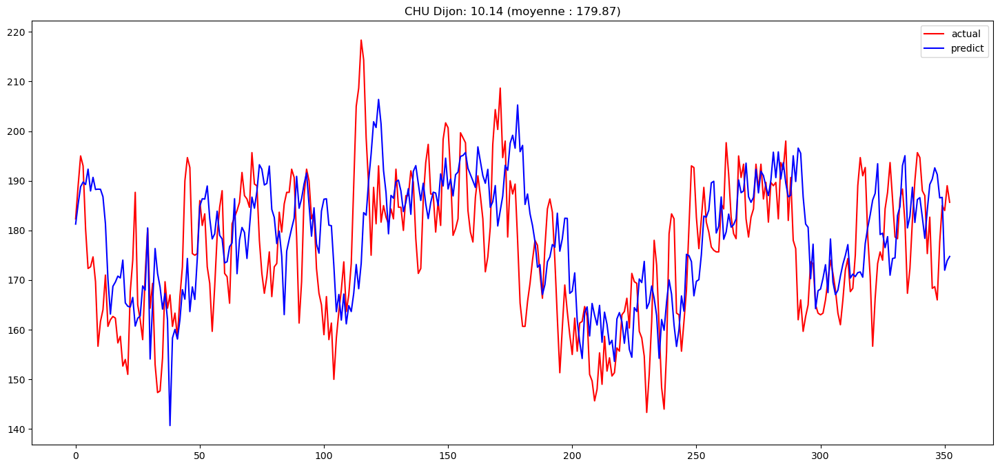

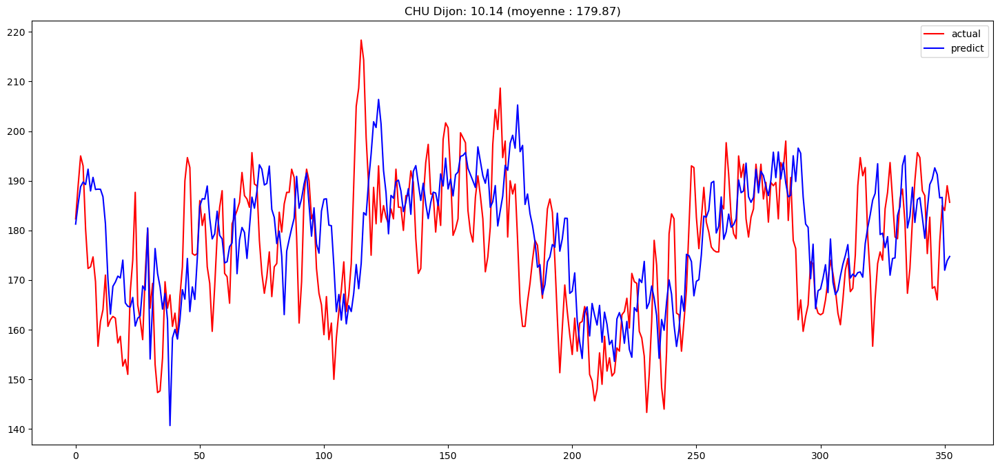

<Figure size 800x600 with 0 Axes>

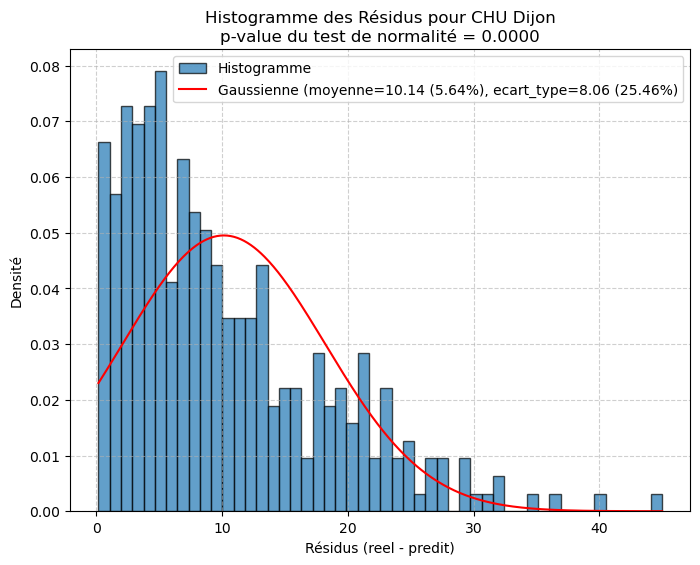

   - MAE : 7.42 (10.32 sur 2023)
   - MSE : 121.05 (174.16 sur 2023)


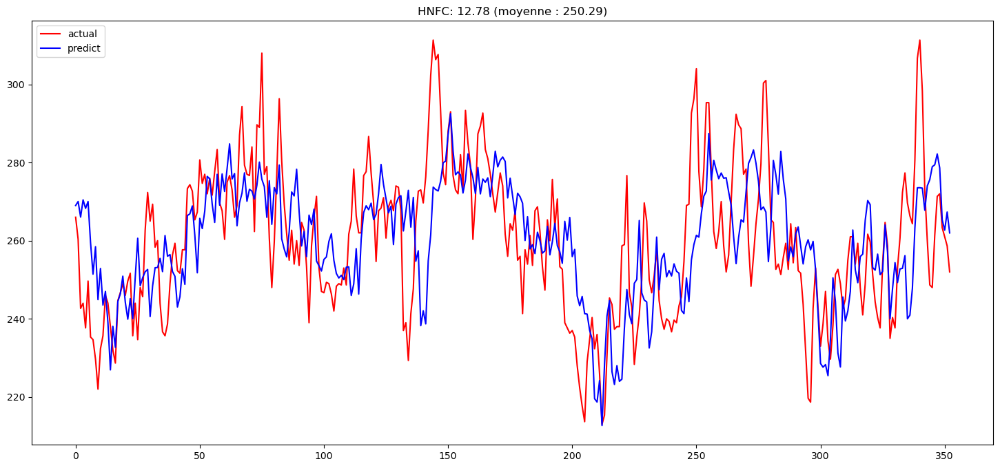

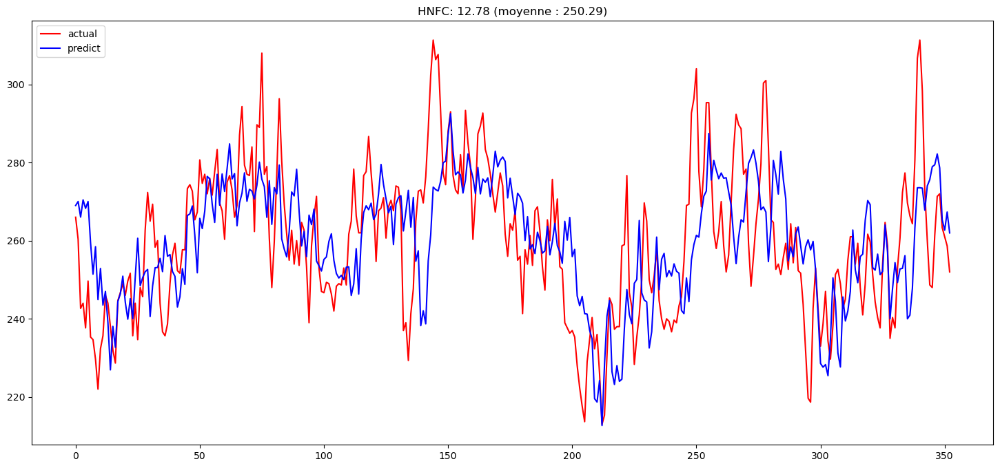

<Figure size 800x600 with 0 Axes>

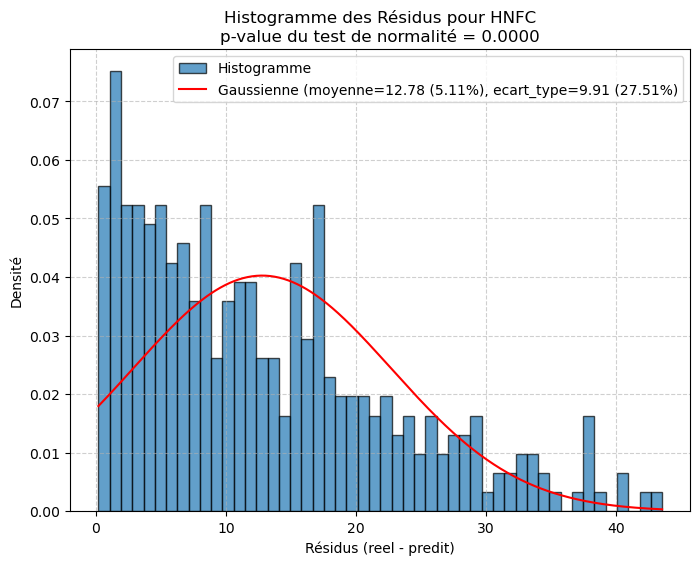

   - MAE : 7.42 (14.96 sur 2023)
   - MSE : 121.05 (684.56 sur 2023)


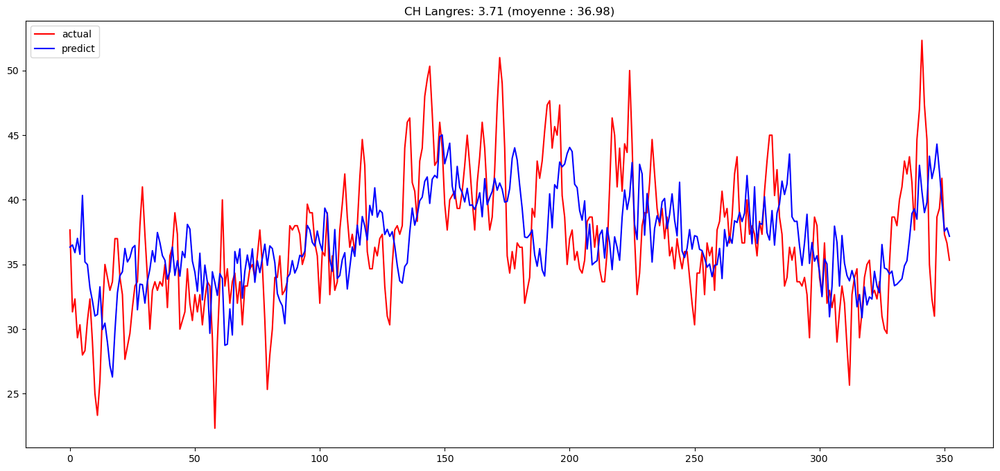

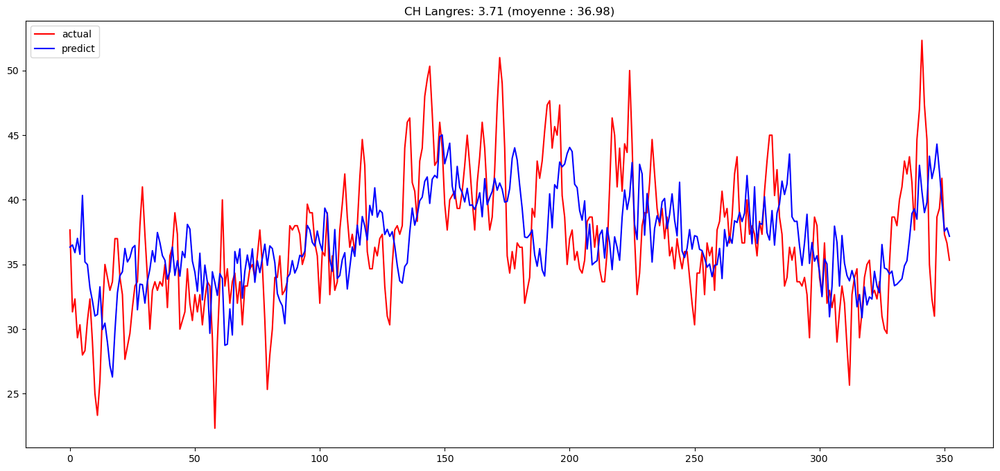

<Figure size 800x600 with 0 Axes>

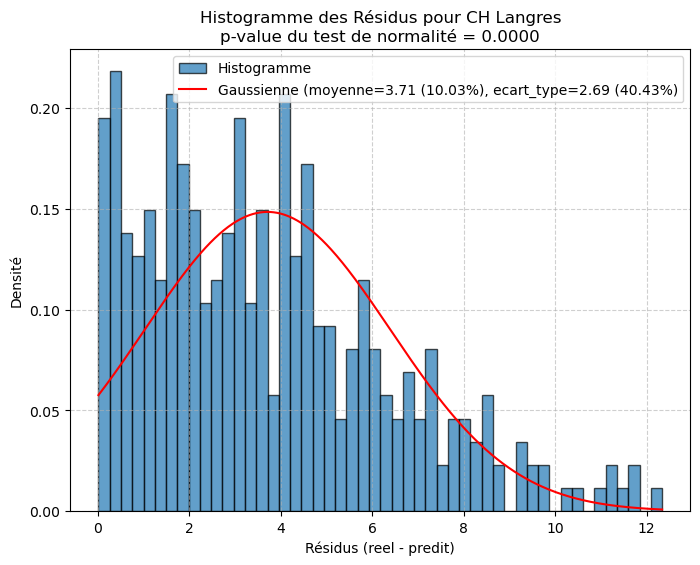

   - MAE : 7.42 (4.08 sur 2023)
   - MSE : 121.05 (34.69 sur 2023)


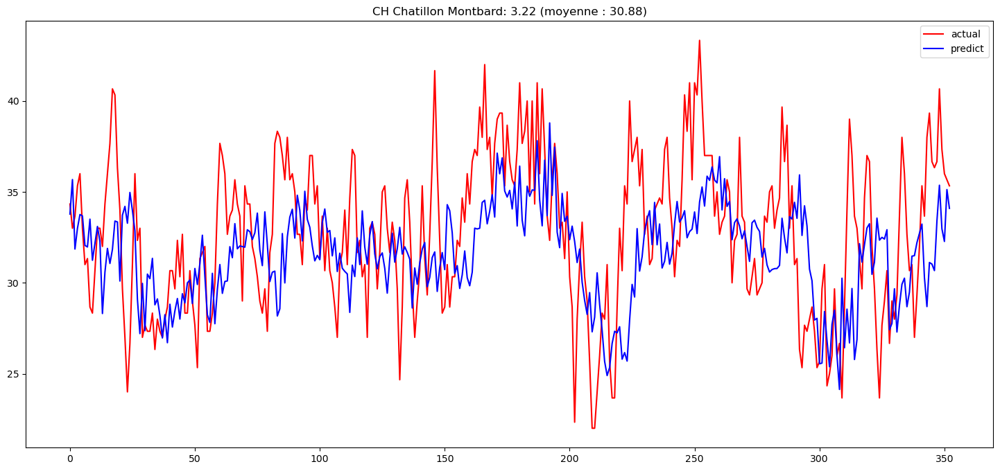

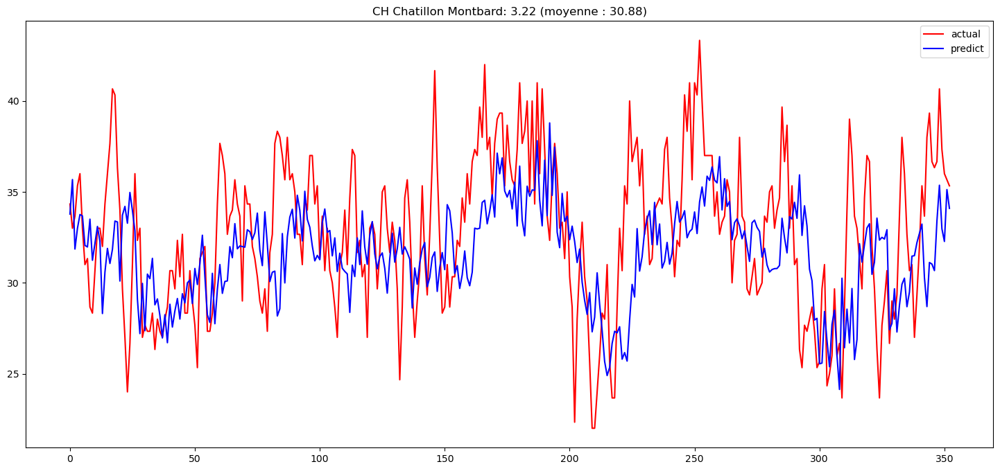

<Figure size 800x600 with 0 Axes>

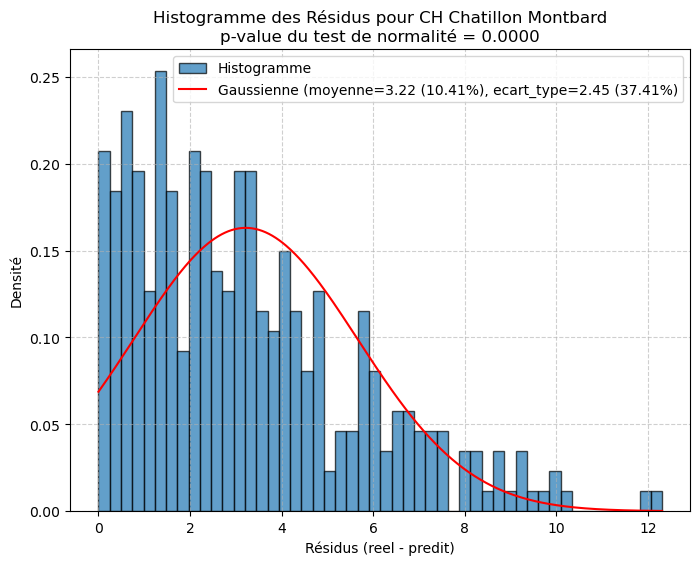

   - MAE : 7.42 (3.45 sur 2023)
   - MSE : 121.05 (21.74 sur 2023)


In [28]:
new_col = 'nb_emmergencies%%J-2'
garde_last = True

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

In [29]:
garde_last = False
new_col = 'date##dayofYear_cos'

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (9): ['nb_emmergencies%%J-1', 'nb_emmergencies%%J-4', 'holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7', 'nb_emmergencies%%J-3']


In [30]:
garde_last = False
new_col = 'inc_diarrhee%%J-7'

assert new_col not in cols
if garde_last and old_col is not None:
    cols.append(old_col)
    cols = list(set(cols))
    scores.append(score)

print(f"Colonnes actuelles ({len(cols)}): {cols}")

old_col = new_col
score, bst = teste(df[cols+[new_col]+['target']], score=scores[-1])

Colonnes actuelles (9): ['nb_emmergencies%%J-1', 'nb_emmergencies%%J-4', 'holidays', 'hopital', 'arrivees_urgences', 'NO2_FR26014%%J-2', 'date##dayofweek_cos', 'nb_emmergencies%%J-7', 'nb_emmergencies%%J-3']
